In [ ]:
# w = 15 로 돌려보자
# lr = 0.0001
# lambda_1 = 1
# h = 128
# loss 0.7밑으로 안내려갑니다...

# temporal lstm을 multi-head attention으로 구현해보자

In [50]:
# 모듈 import
from datetime import datetime
import numpy as np
import os
import pandas as pd
import seaborn as sns

#from google.colab import drive
#drive.mount('/content/gdrive')
#os.chdir('/content/gdrive/MyDrive/python/python_dong/data_axis_transform1')

import torch
import torch.nn as nn
from torch import optim
import torch.nn.functional as F
from torch.autograd import Variable

#!pip install torchmetrics
import torchmetrics

#!pip install torchinfo
from torchinfo import summary

import matplotlib.pyplot as plt
import math


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")



# 1. 데이터 전처리

In [51]:
# data path 지정
raw_data_path = './data/stocknet-dataset/price/raw'

if 'stocknet' in raw_data_path:
    tra_date = '2014-01-02'
    val_date = '2015-08-03'
    tes_date = '2015-10-01'
    end_date = '2015-12-31'
elif 'kdd17' in raw_data_path:
    tra_date = '2007-01-03'
    val_date = '2015-01-02'
    tes_date = '2016-01-04'
    end_date = '2016-12-31'
else:
    print('unexpected path: %s' % raw_data_path)

# os.path.isfile : 파일이 있는지 없는 지 체크
# os.path.join(data_path, fname) : 폴더 디렉터리와 fname(stockname.csv) 붙임
fnames = [fname for fname in os.listdir(raw_data_path) if
            os.path.isfile(os.path.join(raw_data_path,fname))]

COLUMNS_FEATURE_DATA_V1 = ['open_close_ratio', 'high_close_ratio', 
                           'low_close_ratio', 'close_lastclose_ratio', 
                           'adjclose_lastadjclose_ratio', 'close_ma5_ratio', 
                           'close_ma10_ratio', 'close_ma15_ratio', 'close_ma20_ratio', 
                           'close_ma25_ratio', 'close_ma30_ratio']

ver = 'v1' # ver in ['v1', 'v2']
if ver == 'v1':
    COLUMNS_FEATURE = COLUMNS_FEATURE_DATA_V1

In [52]:
windows = [5,10,15,20,25,30]

def preprocess(df, windows):
   '''
   전처리 함수 역할 : 전체 feature생성하여 df column에 추가
   '''
   data = df
   data['open_close_ratio'] = data['Open'] / data['Close'] - 1
   data['high_close_ratio'] = data['High'] / data['Close'] - 1
   data['low_close_ratio'] = data['Low'] / data['Close'] - 1

   data['close_lastclose_ratio'] = np.zeros(len(data))
   data.loc[1:, 'close_lastclose_ratio'] = data['Close'][1:].values / data['Close'][:-1].values - 1

   data['adjclose_lastadjclose_ratio'] = np.zeros(len(data))
   data.loc[1:, 'adjclose_lastadjclose_ratio'] = data['Adj Close'][1:].values / data['Adj Close'][:-1].values - 1

   for window in windows:
      data[f'close_ma{window}_ratio'] = data['Adj Close'].rolling(window).mean()/data['Adj Close'] - 1
   
   data['label'] = np.append((data['Close'][1:].values > data['Close'][:-1].values)*1,0)

   return data

In [53]:
feature_data_path = './data/stocknet-dataset/price/feature'

for fname in fnames:
   if not os.path.isfile(os.path.join(feature_data_path,fname)):
      df_raw = pd.read_csv(os.path.join(raw_data_path,fname))
      data = preprocess(df_raw, windows)

      # 폴더 없으면 생성
      try:
         if not os.path.exists(feature_data_path):
            os.makedirs(feature_data_path)
      except OSError:
         print ('Error: Creating directory. ' +  feature_data_path)

      #csv 파일 저장
      data.to_csv(os.path.join(feature_data_path,fname))



# train, validation, test data 나누기

## 1. input data 3차원으로 쌓기
shape = (stock 종류수, date, feature)



요건
1. 모든 티커 데이터의 date가 맞는지?
2. 결측치는 없는지?
3. 티커와 데이터 메치 가능해야함

In [54]:
raw_data_path = './data/stocknet-dataset/price/raw'


tra_data_X = []
tra_data_Y = []
val_data_X = []
val_data_Y = []
test_data_X = []
test_data_Y = []
tickers = []

cnt = 0
fail_cnt = 0

fnames = [fname for fname in os.listdir(raw_data_path) if
            os.path.isfile(os.path.join(raw_data_path,fname))]

for fname in fnames:

    df = pd.read_csv(os.path.join(raw_data_path,fname))
    data = preprocess(df, windows)

    learning_data = data[(data['Date'] >= tra_date) & (data['Date'] <= end_date)]['Date']
    tra_data_X_ticker = data[(data['Date'] >= tra_date) & (data['Date'] < val_date)][COLUMNS_FEATURE]
    # tra_data_Y_ticker = data[(data['Date'] >= tra_date) & (data['Date'] < val_date)]['adjclose_lastadjclose_ratio']
    tra_data_Y_ticker = data[(data['Date'] >= tra_date) & (data['Date'] < val_date)]['label']

    val_data_X_ticker = data[(data['Date'] >= val_date) & (data['Date'] < tes_date)][COLUMNS_FEATURE]
    #val_data_Y_ticker = data[(data['Date'] >= val_date) & (data['Date'] < tes_date)]['adjclose_lastadjclose_ratio']
    val_data_Y_ticker = data[(data['Date'] >= val_date) & (data['Date'] < tes_date)]['label'] 

    test_data_X_ticker = data[(data['Date'] >= tes_date) & (data['Date'] <= end_date)][COLUMNS_FEATURE]
    #test_data_Y_ticker = data[(data['Date'] >= tes_date) & (data['Date'] <= end_date)]['adjclose_lastadjclose_ratio']
    test_data_Y_ticker = data[(data['Date'] >= tes_date) & (data['Date'] <= end_date)]['label']


    if cnt == 0:
        target_dates = learning_data
    
    print('ticker : {}, date check : {}'.format(fname, np.array_equal(target_dates.values, learning_data.values)))
    if np.array_equal(target_dates.values, learning_data.values): 
        
        tra_data_X.append(tra_data_X_ticker.values)
        tra_data_Y.append(tra_data_Y_ticker.values)

        val_data_X.append(val_data_X_ticker.values)
        val_data_Y.append(val_data_Y_ticker.values)
        
        test_data_X.append(test_data_X_ticker.values)
        test_data_Y.append(test_data_Y_ticker.values)

        tickers.append(fname)
    else : 
        fail_cnt += 1
    
    cnt += 1

print(cnt, len(fnames))
print('fail_cnt :', fail_cnt)

# 마지막에 index 종목 넣기
raw_data_index_path = './data/stocknet-dataset/price/raw/index'

fname = os.listdir(raw_data_index_path)[0]

df = pd.read_csv(os.path.join(raw_data_index_path,fname))
data = preprocess(df, windows)

learning_data = data[(data['Date'] >= tra_date) & (data['Date'] <= end_date)]['Date']
tra_data_X_ticker = data[(data['Date'] >= tra_date) & (data['Date'] < val_date)][COLUMNS_FEATURE]
#tra_data_Y_ticker = data[(data['Date'] >= tra_date) & (data['Date'] < val_date)]['adjclose_lastadjclose_ratio']
tra_data_Y_ticker = data[(data['Date'] >= tra_date) & (data['Date'] < val_date)]['label']

val_data_X_ticker = data[(data['Date'] >= val_date) & (data['Date'] < tes_date)][COLUMNS_FEATURE]
#val_data_Y_ticker = data[(data['Date'] >= val_date) & (data['Date'] < tes_date)]['adjclose_lastadjclose_ratio']
val_data_Y_ticker = data[(data['Date'] >= val_date) & (data['Date'] < tes_date)]['label']

test_data_X_ticker = data[(data['Date'] >= tes_date) & (data['Date'] <= end_date)][COLUMNS_FEATURE]
#test_data_Y_ticker = data[(data['Date'] >= tes_date) & (data['Date'] <= end_date)]['adjclose_lastadjclose_ratio']
test_data_Y_ticker = data[(data['Date'] >= tes_date) & (data['Date'] <= end_date)]['label']

print('ticker : {}, date check : {}'.format(fname, np.array_equal(target_dates.values, learning_data.values)))
if np.array_equal(target_dates.values, learning_data.values):
    
    tra_data_X.append(tra_data_X_ticker.values)
    # tra_data_Y.append(tra_data_Y_ticker.values)

    val_data_X.append(val_data_X_ticker.values)
    # val_data_Y.append(val_data_Y_ticker.values)
    
    test_data_X.append(test_data_X_ticker.values)
    # test_data_Y.append(test_data_Y_ticker.values)

    tickers.append(fname)

# tra_data_X

ticker : AAPL.csv, date check : True
ticker : ABB.csv, date check : True
ticker : ABBV.csv, date check : True
ticker : AEP.csv, date check : True
ticker : AGFS.csv, date check : False
ticker : AMGN.csv, date check : True
ticker : AMZN.csv, date check : True
ticker : BA.csv, date check : True
ticker : BABA.csv, date check : False
ticker : BAC.csv, date check : True
ticker : BBL.csv, date check : True
ticker : BCH.csv, date check : True
ticker : BHP.csv, date check : True
ticker : BP.csv, date check : True
ticker : BRK-A.csv, date check : True
ticker : BSAC.csv, date check : True
ticker : BUD.csv, date check : True
ticker : C.csv, date check : True
ticker : CAT.csv, date check : True
ticker : CELG.csv, date check : True
ticker : CHL.csv, date check : True
ticker : CHTR.csv, date check : True
ticker : CMCSA.csv, date check : True
ticker : CODI.csv, date check : True
ticker : CSCO.csv, date check : True
ticker : CVX.csv, date check : True
ticker : D.csv, date check : True
ticker : DHR.csv,

In [55]:
def list_to_tensor(list_):
    return torch.Tensor(np.array(list_))

In [56]:
tensor_tra_data_X = list_to_tensor(tra_data_X)
tensor_tra_data_Y = list_to_tensor(tra_data_Y).view((len(tra_data_Y),-1,1))
tensor_val_data_X = list_to_tensor(val_data_X)
tensor_val_data_Y = list_to_tensor(val_data_Y).view((len(val_data_Y),-1,1))
tensor_test_data_X = list_to_tensor(test_data_X)
tensor_test_data_Y = list_to_tensor(test_data_Y).view((len(test_data_Y),-1,1))

## Hyperparameter setting

In [80]:
w = 15 # window size w in {10, 15}
beta = 0.1 # market context weight beta in {0.01, 0.1, 1}
h = 128 # hidden layer size h in {64, 128}
learning_rate = 0.0001 # in {0.001, 0.0001}
lambda_1 = 0 # selective regularzation lambda = 1
drop_rate = 0.15
feature_size = len(COLUMNS_FEATURE)

In [81]:
class Feature_transformation_layer(nn.Module):
    """Feature transformation layer in DTML"""

    def __init__(self, feature_size, h):
        super(Feature_transformation_layer, self).__init__()
        self.feature_size = feature_size
        self.h = h

        self.linear = nn.Linear(self.feature_size, self.h)
    
    def forward(self, X):
        output = torch.tanh(self.linear(X))
        return output

In [82]:
def layer_normalization(tensor):
    h = tensor.size()[-1]
    return (tensor - torch.std_mean(tensor, dim=1, unbiased=False)[1].repeat((h,1)).transpose(-2,-1))/(torch.std_mean(tensor, dim=1, unbiased=False)[0].repeat((h,1)).transpose(-2,-1) + 0.000001)

In [83]:
class Nonlinear_transformation(nn.Module):
    """Nonlinear transformation in DTML"""

    def __init__(self, h):
        super(Nonlinear_transformation, self).__init__()
        self.h = h
        
        self.mlp1 = nn.Linear(self.h, self.h * 4)
        self.mlp2 = nn.Linear(self.h * 4, h)
    
    def forward(self, H, H_tilda, on_train=True):
        H_p = H + H_tilda
        H_p = self.mlp1(H_p)
        H_p = nn.ReLU()(H_p)
        H_p = self.mlp2(H_p)
        H_p = H + H_tilda + H_p
        H_p = nn.Tanh()(H_p)

        # dropout and layer normalization
        if on_train == True:
            H_p = nn.Dropout(p=drop_rate)(H_p)
        H_p = layer_normalization(H_p)
        return H_p

In [84]:
class Final_prediction(nn.Module):
    """final prediction in DTML"""

    def __init__(self, h):
        super(Final_prediction, self).__init__()
        self.h = h

        self.pred_linear = nn.Linear(h,1)
    
    def forward(self, H_p):
        y_hat = self.pred_linear(H_p)
        y_hat = nn.Sigmoid()(y_hat).view((-1))

        return y_hat

In [85]:
class DTML(nn.Module):
    ''' DTML '''

    def __init__(self, X, y, w, h, beta, vali_X, vali_y, test_X, test_y,
                 batch_size,
                 learning_rate, epochs):
        """ Initialize """
        super(DTML, self).__init__()
        self.X = X
        self.y = y
        self.vali_X = vali_X
        self.vali_y = vali_y
        self.test_X = test_X
        self.test_y = test_y
        self.w = w
        self.h = h
        self.beta = beta
        self.batch_size = batch_size
        
        self.learning_rate = learning_rate
        self.epochs = epochs
        self.train_timesteps = train_timesteps = int(X.size()[1]) - w

        self.device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
        print("==> Use accelerator : ", self.device)

        self.Feature_transformation_layer = Feature_transformation_layer(feature_size=self.X.size()[-1],
                                                                         h=self.h)
        
        # 티커별로 lstm 층 개별로 만들기
        #for i in range(self.X.size()[0]): # 마지막은 index용 lstm
        #    self._modules['lstm_{}'.format(i)] = nn.LSTM(input_size = self.h, hidden_size=self.h, batch_first=True)
        
        # temporal lstm을 multi-head attention 층으로 구현해보자.
        for i in range(self.X.size()[0]): # 마지막은 index용 lstm
            self._modules['multihead_attn_{}'.format(i)] = nn.MultiheadAttention(embed_dim = self.h, num_heads=1, dropout=0, batch_first=True)


        # ticker별로 linear layer 생성
        for i in range(self.X.size()[0]):
            self._modules['ContextNormalLinearLayer_{}'.format(i)] = nn.Linear(h, h)

        self.multihead_attn = nn.MultiheadAttention(embed_dim=self.h, num_heads=8, dropout=drop_rate, batch_first=True)
        self.query_layer = nn.Linear(self.h, self.h)
        self.key_layer = nn.Linear(self.h, self.h)
        self.value_layer = nn.Linear(self.h, self.h)

        self.Nonlinear_transformation = Nonlinear_transformation(h=self.h)

        self.Final_prediction = Final_prediction(h=self.h)
        print(len(list(self.parameters())))

        # Loss funciton
        self.criterion = nn.BCELoss()

        self.optimizer = optim.Adam(params=filter(lambda p:p.requires_grad, self.parameters()), lr=self.learning_rate)

    def window_(self, tensor, time_idx, window_size):
        # tensor size = (ticker_number, dates, feature_size)    
        return tensor[:, time_idx:time_idx + self.w, :]


    def train(self):
        mode = 'train'
        if mode == 'train':
            X = self.X
            y_data = self.y
            epochs = self.epochs
        elif mode == 'validation':
            X = self.vali_X
            y_data = self.vali_y
            epochs = 1
        
        elif mode == 'test':
            X = self.test_X
            y_data = self.test_y
            epochs = 1

        else:
            print('유효하지 않는 mode입니다.')
            
        
        timesteps = int(X.size()[1]) - w

        """training process"""
        # epoch당 iteration 수
        iter_per_epoch = int(np.ceil(timesteps * 1. / self.batch_size))
        # 전체 iteration에서 loss (전체 iteration 수 = epoch수 * epoch당 iteration 수)
        self.iter_losses = np.zeros(epochs * iter_per_epoch)
        self.iter_acc = np.zeros(epochs * iter_per_epoch)
        self.iter_mcc = np.zeros(epochs * iter_per_epoch)
        self.iter_precision = np.zeros(epochs * iter_per_epoch)
        self.return_rate = np.zeros((epochs, timesteps)) # batch_size 관련해서 수정필요
        self.index_return_rate = np.zeros((epochs, timesteps)) # batch_size 관련해서 수정필요
        self.com_return_rate = np.zeros((epochs, timesteps)) # batch_size 관련해서 수정필요
        self.index_com_return_rate = np.zeros((epochs, timesteps))
        self.topk3_tickers = np.zeros((epochs, timesteps, int(X.size()[0])))

        # epoch당 loss
        self.epoch_losses = np.zeros(epochs)
        self.epoch_acc = np.zeros(epochs)
        self.epoch_mcc = np.zeros(epochs)
        self.epoch_precision = np.zeros(epochs)

        # epoch당 loss (Validation)
        self.vali_epoch_losses = np.zeros(epochs)
        self.vali_epoch_acc = np.zeros(epochs)
        self.vali_epoch_mcc = np.zeros(epochs)
        self.vali_epoch_precision = np.zeros(epochs)

        vali_timesteps = int(self.vali_X.size()[1]) - w

        """training process"""
        # epoch당 iteration 수
        vali_iter_per_epoch = int(np.ceil(vali_timesteps * 1. / self.batch_size))
        # 전체 iteration에서 loss (전체 iteration 수 = epoch수 * epoch당 iteration 수)
        self.vali_iter_losses = np.zeros(epochs * vali_iter_per_epoch)
        self.vali_iter_acc = np.zeros(epochs * vali_iter_per_epoch)
        self.vali_iter_mcc = np.zeros(epochs * vali_iter_per_epoch)
        self.vali_iter_precision = np.zeros(epochs * vali_iter_per_epoch)
        self.vali_return_rate = np.zeros((epochs, vali_timesteps)) # batch_size 관련해서 수정필요
        self.vali_index_return_rate = np.zeros((epochs, vali_timesteps)) # batch_size 관련해서 수정필요
        self.vali_com_return_rate = np.zeros((epochs, vali_timesteps)) # batch_size 관련해서 수정필요
        self.vali_index_com_return_rate = np.zeros((epochs, vali_timesteps))
        self.vali_topk3_tickers = np.zeros((epochs, vali_timesteps, int(X.size()[0])))

        train_n_iter = 0

        for epoch in range(self.epochs):
            time_idx = 0
            com_return_rate = 1
            index_com_return_rate = 1
            output = self.Feature_transformation_layer(X)

            while (time_idx < timesteps):
                #print('time_idx : {}, train_timesteps : {}'.format(time_idx, self.train_timesteps))
                
                Z_tilda = self.window_(output, time_idx=time_idx, window_size=self.w)
                tra_data_Y_w = self.window_(y_data, time_idx=time_idx, window_size=self.w)

                

                '''
                # hidden state ticker별 쌓기
                H_n = torch.Tensor().new_zeros((X.size()[0],w,h)) # +1은 index

                for ticker_idx in range(X.size()[0]):
                    # print('ticker_idx', ticker_idx)
                    i = 0
                    z_tilda = Z_tilda[ticker_idx,:,:].view(1,Z_tilda.size()[1], Z_tilda.size()[2])
                    lstm_output, (h_n, c_n) = self._modules['lstm_{}'.format(ticker_idx)](z_tilda[:,i,:].view(1,1,Z_tilda.size()[2]))
                    H_n[ticker_idx,0,:] = h_n
                    for i in range(1,w):
                        lstm_output, (h_n, c_n) = self._modules['lstm_{}'.format(ticker_idx)](z_tilda[:,i,:].view(1,1,Z_tilda.size()[2]), (h_n, c_n))
                        H_n[ticker_idx,i,:] = h_n

                H_n_dot = torch.Tensor().new_zeros((X.size()[0],self.w)) # 알파_i 계산하기전 ticker별로 dot(h_i, h_T) 계산
                # size (len(tickers), window_size w)
                # https://pytorch.org/docs/stable/generated/torch.matmul.html
                # torch.mul broadcasting 볼수 있음
                for i in range(X.size()[0]):
                    H_n_dot[i,:] = torch.matmul(H_n[i], H_n[i][-1])

                # https://pytorch.org/docs/stable/generated/torch.nn.Softmax.html
                Alpha = nn.Softmax(dim=1)(torch.exp(H_n_dot))

                H_n_tilde = torch.Tensor().new_zeros((X.size()[0], self.h))
                for i in range(self.X.size()[0]):
                    H_n_tilde[i,:] = torch.matmul(H_n[i].transpose(-2,-1), Alpha[i])
                '''
                
                H_n_tilde = torch.Tensor().new_zeros((X.size()[0], self.h))
                for ticker_idx in range(X.size()[0]):
                    z_tilda = Z_tilda[ticker_idx,:,:].view(1,Z_tilda.size()[1], Z_tilda.size()[2])

                       
                    H_n_tilde[ticker_idx,:], attn_output_weights = self._modules['multihead_attn_{}'.format(ticker_idx)](query=z_tilda[:,-1,:].view(1,1,z_tilda.size()[2]), 
                    key=z_tilda.view(1,z_tilda.size()[1],z_tilda.size()[2]), 
                    value=z_tilda.view(1,z_tilda.size()[1],z_tilda.size()[2]))

                
                pre_H_c_n = layer_normalization(H_n_tilde)
                

                H_c_n = torch.Tensor().new_zeros(X.size()[0], self.h)
                for i in range(X.size()[0]):
                    H_c_n[i,:]= self._modules['ContextNormalLinearLayer_{}'.format(i)](pre_H_c_n[i])

                H = H_c_n + self.beta*H_c_n[-1]
                H = H[:-1] # 마지막 index context vector 제외


                H_tilda, attn_output_weights = self.multihead_attn(query=H.view([1,H.size()[0], H.size()[1]]), key=H.view([1,H.size()[0], H.size()[1]]), value=H.view([1,H.size()[0], H.size()[1]]))
                H_tilda = H_tilda[0]
                #Q = self.query_layer(H)
                #K = self.key_layer(H)
                #V = self.value_layer(H)

                # S 생성
                #S = torch.matmul(Q, K.transpose(-2,-1))
                #S = S/math.sqrt(h)
                #S = nn.Softmax(dim=1)(S)

                # H_tilda 생성
                #H_tilda = torch.matmul(S,V)

                # dropout and layer normailzation --> attention후, drop-out 하라고 논문에 있음
                #H_tilda = nn.Dropout(p=drop_rate)(H_tilda) -> multihead에 dropout 포함되어있습니다.
                H_tilda = layer_normalization(H_tilda)

                if mode == 'train':
                    H_p = self.Nonlinear_transformation(H, H_tilda, on_train=True)
                else:
                    H_p = self.Nonlinear_transformation(H, H_tilda, on_train=False)

                y_hat = self.Final_prediction(H_p)
                y = tra_data_Y_w[:,w-1,:].view((-1))

                if mode == 'train':
                    self.optimizer.zero_grad()

                ## Selective Regularization
                loss_reg = self.criterion(y_hat,y) + lambda_1*(torch.norm(list(self.Final_prediction.parameters())[0]).pow(2)
                                 + torch.norm(list(self.Final_prediction.parameters())[1]).pow(2))
                
                acc = torchmetrics.functional.accuracy(y_hat,y.int())
                mcc = torchmetrics.MatthewsCorrcoef(num_classes=2)(y_hat, y.int())
                precision = torchmetrics.Precision()(y_hat, y.int())
                return_rate = X[y_hat.topk(3)[1],time_idx + w,4].sum()*(1/3)
                #print(y_hat.topk(3)[1], X[y_hat.topk(3)[1],time_idx + w - 1,4], X[y_hat.topk(3)[1],time_idx + w,4])
                index_return_rate = X[-1, time_idx + w, 4]
                com_return_rate *= 1 + return_rate
                index_com_return_rate *= 1 + index_return_rate

                if mode == 'train':
                    loss_reg.backward(retain_graph=True)
                    self.optimizer.step()
              

                self.iter_losses[int(epoch * iter_per_epoch + time_idx / self.batch_size)] = loss_reg
                self.iter_acc[int(epoch * iter_per_epoch + time_idx / self.batch_size)] = acc
                self.iter_mcc[int(epoch * iter_per_epoch + time_idx / self.batch_size)] = mcc
                self.iter_precision[int(epoch * iter_per_epoch + time_idx / self.batch_size)] = precision
                self.return_rate[epoch, time_idx] = return_rate # batch_size 적용하면 수정해야함
                self.index_return_rate[epoch, time_idx] = index_return_rate
                self.com_return_rate[epoch, time_idx] = com_return_rate # batch_size 적용하면 수정해야함
                self.index_com_return_rate[epoch, time_idx] = index_com_return_rate # batch_size 적용하면 수정해야함
                self.topk3_tickers[0, time_idx , y_hat.topk(3)[1]] += 1

                '''
                if time_idx % 1000 == 0:
                    print('epoch : ',epoch, "time_idx : ", time_idx, 
                          "loss_reg : ", loss_reg, 
                          "acc : ", acc, 
                          "mcc : ", mcc,
                          "precision : ", precision,
                          "return_rate", return_rate,
                          "com_return_rate", com_return_rate)
                '''
                

                time_idx += self.batch_size
                train_n_iter += 1                

                if train_n_iter % 100 == 0 and train_n_iter != 0:
                    for param_group in self.optimizer.param_groups:
                        param_group['lr'] = param_group['lr'] * 0.9
                    #drop_rate = drop_rate * 0.9
                    
                
                ######### 공통부분 끝, 데이터 수집 시작

            self.epoch_losses[epoch] = np.mean(self.iter_losses[range(
                epoch * iter_per_epoch, (epoch + 1) * iter_per_epoch)])
            
            self.epoch_acc[epoch] = np.mean(self.iter_acc[range(
                epoch * iter_per_epoch, (epoch + 1) * iter_per_epoch)])
            
            self.epoch_mcc[epoch] = np.mean(self.iter_mcc[range(
                epoch * iter_per_epoch, (epoch + 1) * iter_per_epoch)])
            
            self.epoch_precision[epoch] = np.mean(self.iter_precision[range(
                epoch * iter_per_epoch, (epoch + 1) * iter_per_epoch)])

            plt.subplot(3,1,1)
            #plt.figure()
            plt.plot(range(timesteps), self.com_return_rate[epoch][:timesteps], label='portfolio')
            plt.plot(range(timesteps), self.index_com_return_rate[0][ : timesteps], label='index')
            plt.legend(loc='upper left')
            plt.ylabel('com_return_rate')            

            plt.subplot(3,1,2)
            plt.plot(range(int(epoch * iter_per_epoch + time_idx / self.batch_size)), self.iter_losses[:int(epoch * iter_per_epoch + time_idx / self.batch_size)], label=mode)
            plt.legend(loc='upper left')
            plt.ylabel('loss_reg')

            plt.subplot(3,1,3)
            plt.plot(range(int(epoch * iter_per_epoch + time_idx / self.batch_size)), self.iter_acc[:int(epoch * iter_per_epoch + time_idx / self.batch_size)], label=mode)
            plt.legend(loc='upper left')
            plt.ylabel('iter_acc')

            plt.savefig('train_return_epoch{}.png'.format(epoch))
            plt.show()

            plt.figure(figsize=(64,10))
            ax = sns.heatmap(self.topk3_tickers[0].transpose(), linewidths=0.1)
            plt.savefig('train_topk_epoch{}.png'.format(epoch))
            plt.show()
            

            if epoch % 1 == 0:
                plt.subplot(2,1,1)
                plt.plot(range(epoch + 1), self.epoch_losses[:epoch + 1], label=mode)
                plt.legend(loc='upper left')
                plt.ylabel('loss_reg')

                plt.subplot(2,1,2)
                plt.plot(range(epoch + 1), self.epoch_acc[:epoch + 1], label=mode)
                plt.legend(loc='upper left')
                plt.ylabel('acc')

                plt.savefig('train_losses_epoch{}.png'.format(epoch))
                plt.show()

            if epoch % 1 == 0:
                print("Epochs : ", epoch, "Iterations : ", train_n_iter,
                      "Loss : ", self.epoch_losses[epoch],
                      "ACC : ", self.epoch_acc[epoch],
                      "MCC : ", self.epoch_mcc[epoch],
                      "Precision : ", self.epoch_precision[epoch])
            
            if epoch % 1 == 0:
                self.validation(e=epoch)




            if epoch % 1 == 0:
                plt.subplot(2,1,1)
                plt.plot(range(epoch + 1), self.vali_epoch_losses[:epoch + 1], label='validation')
                plt.legend(loc='upper left')
                plt.ylabel('loss_reg')

                plt.subplot(2,1,2)
                plt.plot(range(epoch + 1), self.vali_epoch_acc[:epoch + 1], label='validation')
                plt.legend(loc='upper left')
                plt.ylabel('acc')

                plt.savefig('vali_losses_epoch{}.png'.format(epoch))
                plt.show()
    
    def validation(self , e):
        mode = 'validation'
        if mode == 'train':
            print('mode :', mode)
            X = self.X
            y_data = self.y
            epochs = self.epochs
        elif mode == 'validation':
            print('mode :', mode)
            X = self.vali_X
            y_data = self.vali_y
            epochs = 1
        
        elif mode == 'test':
            print('mode :', mode)
            X = self.test_X
            y_data = self.test_y
            epochs = 1

        else:
            print('유효하지 않는 mode입니다.')
            
        
        vali_timesteps = int(X.size()[1]) - w

        # epoch당 iteration 수
        vali_iter_per_epoch = int(np.ceil(vali_timesteps * 1. / self.batch_size))
        '''
        """training process"""
        # epoch당 iteration 수
        vali_iter_per_epoch = int(np.ceil(vali_timesteps * 1. / self.batch_size))
        # 전체 iteration에서 loss (전체 iteration 수 = epoch수 * epoch당 iteration 수)
        self.vali_iter_losses = np.zeros(epochs * vali_iter_per_epoch)
        self.vali_iter_acc = np.zeros(epochs * vali_iter_per_epoch)
        self.vali_iter_mcc = np.zeros(epochs * vali_iter_per_epoch)
        self.vali_iter_precision = np.zeros(epochs * vali_iter_per_epoch)
        self.vali_return_rate = np.zeros((epochs, vali_timesteps)) # batch_size 관련해서 수정필요
        self.vali_index_return_rate = np.zeros((epochs, vali_timesteps)) # batch_size 관련해서 수정필요
        self.vali_com_return_rate = np.zeros((epochs, vali_timesteps)) # batch_size 관련해서 수정필요
        self.vali_index_com_return_rate = np.zeros((epochs, vali_timesteps))
        '''
        '''
        # epoch당 loss
        self.vali_epoch_losses = np.zeros(epochs)
        self.vali_epoch_acc = np.zeros(epochs)
        self.vali_epoch_mcc = np.zeros(epochs)
        self.vali_epoch_precision = np.zeros(epochs)
        '''

        vali_n_iter = 0

        for epoch in range(epochs):
            time_idx = 0
            com_return_rate = 1
            index_com_return_rate = 1
            output = self.Feature_transformation_layer(X)

            while (time_idx < vali_timesteps):
                #print('time_idx : {}, train_timesteps : {}'.format(time_idx, self.train_timesteps))
                
                Z_tilda = self.window_(output, time_idx=time_idx, window_size=self.w)
                tra_data_Y_w = self.window_(y_data, time_idx=time_idx, window_size=self.w)

                '''
                # hidden state ticker별 쌓기
                H_n = torch.Tensor().new_zeros((X.size()[0],w,h)) # +1은 index


                for ticker_idx in range(X.size()[0]):
                    # print('ticker_idx', ticker_idx)
                    i = 0
                    z_tilda = Z_tilda[ticker_idx,:,:].view(1,Z_tilda.size()[1], Z_tilda.size()[2])
                    lstm_output, (h_n, c_n) = self._modules['lstm_{}'.format(ticker_idx)](z_tilda[:,i,:].view(1,1,Z_tilda.size()[2]))
                    H_n[ticker_idx,0,:] = h_n
                    for i in range(1,w):
                        lstm_output, (h_n, c_n) = self._modules['lstm_{}'.format(ticker_idx)](z_tilda[:,i,:].view(1,1,Z_tilda.size()[2]), (h_n, c_n))
                        H_n[ticker_idx,i,:] = h_n

                H_n_dot = torch.Tensor().new_zeros((X.size()[0],self.w)) # 알파_i 계산하기전 ticker별로 dot(h_i, h_T) 계산
                # size (len(tickers), window_size w)
                # https://pytorch.org/docs/stable/generated/torch.matmul.html
                # torch.mul broadcasting 볼수 있음
                for i in range(X.size()[0]):
                    H_n_dot[i,:] = torch.matmul(H_n[i], H_n[i][-1])

                # https://pytorch.org/docs/stable/generated/torch.nn.Softmax.html
                Alpha = nn.Softmax(dim=1)(torch.exp(H_n_dot))

                H_n_tilde = torch.Tensor().new_zeros((X.size()[0], self.h))
                for i in range(self.X.size()[0]):
                    H_n_tilde[i,:] = torch.matmul(H_n[i].transpose(-2,-1), Alpha[i])

                '''

                H_n_tilde = torch.Tensor().new_zeros((X.size()[0], self.h))
                for ticker_idx in range(X.size()[0]):
                    z_tilda = Z_tilda[ticker_idx,:,:].view(1,Z_tilda.size()[1], Z_tilda.size()[2])

                       
                    H_n_tilde[ticker_idx,:], attn_output_weights = self._modules['multihead_attn_{}'.format(ticker_idx)](query=z_tilda[:,-1,:].view(1,1,z_tilda.size()[2]), 
                    key=z_tilda.view(1,z_tilda.size()[1],z_tilda.size()[2]), 
                    value=z_tilda.view(1,z_tilda.size()[1],z_tilda.size()[2]))
                    
                pre_H_c_n = layer_normalization(H_n_tilde)

                H_c_n = torch.Tensor().new_zeros(X.size()[0], self.h)
                for i in range(X.size()[0]):
                    H_c_n[i,:]= self._modules['ContextNormalLinearLayer_{}'.format(i)](pre_H_c_n[i])

                H = H_c_n + self.beta*H_c_n[-1]
                H = H[:-1] # 마지막 index context vector 제외


                H_tilda, attn_output_weights = self.multihead_attn(query=H.view([1,H.size()[0], H.size()[1]]), key=H.view([1,H.size()[0], H.size()[1]]), value=H.view([1,H.size()[0], H.size()[1]]))
                H_tilda = H_tilda[0]
                #Q = self.query_layer(H)
                #K = self.key_layer(H)
                #V = self.value_layer(H)

                # S 생성
                #S = torch.matmul(Q, K.transpose(-2,-1))
                #S = S/math.sqrt(h)
                #S = nn.Softmax(dim=1)(S)

                # H_tilda 생성
                #H_tilda = torch.matmul(S,V)

                # dropout and layer normailzation --> attention후, drop-out 하라고 논문에 있음
                #H_tilda = nn.Dropout(p=drop_rate)(H_tilda) -> multihead에 dropout 포함되어있습니다.
                H_tilda = layer_normalization(H_tilda)

                if mode == 'train':
                    H_p = self.Nonlinear_transformation(H, H_tilda, on_train=True)
                else:
                    H_p = self.Nonlinear_transformation(H, H_tilda, on_train=False)

                y_hat = self.Final_prediction(H_p)
                y = tra_data_Y_w[:,w-1,:].view((-1))

                if mode == 'train':
                    self.optimizer.zero_grad()

                ## Selective Regularization
                loss_reg = self.criterion(y_hat,y) + lambda_1*(torch.norm(list(self.Final_prediction.parameters())[0]).pow(2)
                                 + torch.norm(list(self.Final_prediction.parameters())[1]).pow(2))
                
                acc = torchmetrics.functional.accuracy(y_hat,y.int())
                mcc = torchmetrics.MatthewsCorrcoef(num_classes=2)(y_hat, y.int())
                precision = torchmetrics.Precision()(y_hat, y.int())
                return_rate = X[y_hat.topk(3)[1],time_idx + w,4].sum()*(1/3)
                index_return_rate = X[-1, time_idx + w, 4]
                com_return_rate *= 1 + return_rate
                index_com_return_rate *= 1 + index_return_rate
                self.vali_topk3_tickers[0, time_idx , y_hat.topk(3)[1]] += 1

                if mode == 'train':
                    loss_reg.backward(retain_graph=True)
                    self.optimizer.step()
              

                self.vali_iter_losses[int(e * vali_iter_per_epoch + time_idx / self.batch_size)] = loss_reg
                self.vali_iter_acc[int(e * vali_iter_per_epoch + time_idx / self.batch_size)] = acc
                self.vali_iter_mcc[int(e * vali_iter_per_epoch + time_idx / self.batch_size)] = mcc
                self.vali_iter_precision[int(e * vali_iter_per_epoch + time_idx / self.batch_size)] = precision
                self.vali_return_rate[e, time_idx] = return_rate # batch_size 적용하면 수정해야함
                self.vali_index_return_rate[e, time_idx] = index_return_rate
                self.vali_com_return_rate[e, time_idx] = com_return_rate # batch_size 적용하면 수정해야함
                self.vali_index_com_return_rate[e, time_idx] = index_com_return_rate # batch_size 적용하면 수정해야함    

                '''
                if time_idx % 1000 == 0:
                    print('epoch : ',epoch, "time_idx : ", time_idx, 
                          "loss_reg : ", loss_reg, 
                          "acc : ", acc, 
                          "mcc : ", mcc,
                          "precision : ", precision,
                          "return_rate", return_rate,
                          "com_return_rate", com_return_rate)
                '''
                

                time_idx += self.batch_size
                vali_n_iter += 1                

                '''
                if train_n_iter % 100 == 0 and train_n_iter != 0:
                    for param_group in self.optimizer.param_groups:
                        param_group['lr'] = param_group['lr'] * 0.9
                '''
                
                ######### 공통부분 끝, 데이터 수집 시작

            self.vali_epoch_losses[e] = np.mean(self.vali_iter_losses[range(
                e * vali_iter_per_epoch, (e + 1) * vali_iter_per_epoch)])
            
            self.vali_epoch_acc[e] = np.mean(self.vali_iter_acc[range(
                e * vali_iter_per_epoch, (e + 1) * vali_iter_per_epoch)])
            
            self.vali_epoch_mcc[e] = np.mean(self.vali_iter_mcc[range(
                e * vali_iter_per_epoch, (e + 1) * vali_iter_per_epoch)])
            
            self.vali_epoch_precision[e] = np.mean(self.vali_iter_precision[range(
                e * vali_iter_per_epoch, (e + 1) * vali_iter_per_epoch)])

            plt.subplot(3,1,1)
            #plt.figure()
            plt.plot(range(vali_timesteps), self.vali_com_return_rate[e][:vali_timesteps], label='portfolio')
            plt.plot(range(vali_timesteps), self.vali_index_com_return_rate[0][ : vali_timesteps], label='index')
            plt.legend(loc='upper left')
            plt.ylabel('com_return_rate')

            plt.subplot(3,1,2)
            plt.plot(range(int(e * vali_iter_per_epoch + time_idx / self.batch_size)), self.vali_iter_losses[:int(e * vali_iter_per_epoch + time_idx / self.batch_size)], label=mode)
            plt.legend(loc='upper left')
            plt.ylabel('loss_reg')

            plt.subplot(3,1,3)
            plt.plot(range(int(e * vali_iter_per_epoch + time_idx / self.batch_size)), self.vali_iter_acc[:int(e * vali_iter_per_epoch + time_idx / self.batch_size)], label=mode)
            plt.legend(loc='upper left')
            plt.ylabel('iter_acc')
            plt.savefig('vali_return_epoch{}.png'.format(epoch))
            plt.show()

            plt.figure(figsize=(64,10))
            ax = sns.heatmap(self.vali_topk3_tickers[0].transpose(), linewidths=0.1)
            plt.savefig('vali_topk_epoch{}.png'.format(epoch))
            plt.show()

            if epoch % 1 == 0:
                print("Epochs : ", e, "Iterations : ", vali_n_iter,
                      "Loss : ", self.vali_epoch_losses[e],
                      "ACC : ", self.vali_epoch_acc[e],
                      "MCC : ", self.vali_epoch_mcc[e],
                      "Precision : ", self.vali_epoch_precision[e])
        
    
    def test(self):
        mode = 'test'
        if mode == 'train':
            print('mode :', mode)
            X = self.X
            y_data = self.y
            epochs = self.epochs
        elif mode == 'validation':
            print('mode :', mode)
            X = self.vali_X
            y_data = self.vali_y
            epochs = 1
        
        elif mode == 'test':
            print('mode :', mode)
            X = self.test_X
            y_data = self.test_y
            epochs = 1
        
        timesteps = int(self.test_X.size()[1]) - w
        epochs = 1
        # epoch당 iteration 수
        iter_per_epoch = int(np.ceil(timesteps * 1. / self.batch_size))
        # 전체 iteration에서 loss (전체 iteration 수 = epoch수 * epoch당 iteration 수)
        self.test_iter_losses = np.zeros(epochs * iter_per_epoch)
        self.test_iter_acc = np.zeros(epochs * iter_per_epoch)
        self.test_iter_mcc = np.zeros(epochs * iter_per_epoch)
        self.test_iter_precision = np.zeros(epochs * iter_per_epoch)
        self.test_return_rate = np.zeros((epochs, timesteps)) # batch_size 관련해서 수정필요
        self.test_index_return_rate = np.zeros((epochs, timesteps))
        self.test_com_return_rate = np.zeros((epochs, timesteps)) # batch_size 관련해서 수정필요
        self.test_index_com_return_rate = np.zeros((epochs, timesteps))
        self.test_topk3_tickers = np.zeros((epochs, timesteps, int(X.size()[0])))

        # epoch당 loss
        self.test_epoch_losses = np.zeros(epochs)
        self.test_epoch_acc = np.zeros(epochs)
        self.test_epoch_mcc = np.zeros(epochs)
        self.test_epoch_precision = np.zeros(epochs)

        n_iter = 0

        for epoch in range(epochs):
            time_idx = 0
            com_return_rate = 1
            index_com_return_rate = 1
            output = self.Feature_transformation_layer(X)

            while (time_idx < timesteps): # test끝으로 바꿔야함
                #print('time_idx : {}, train_timesteps : {}'.format(time_idx, self.train_timesteps))
                
                Z_tilda = self.window_(output, time_idx=time_idx, window_size=self.w)
                tra_data_Y_w = self.window_(y_data, time_idx=time_idx, window_size=self.w)
                
                '''
                # hidden state ticker별 쌓기
                H_n = torch.Tensor().new_zeros((self.test_X.size()[0],w,h)) # +1은 index

                for ticker_idx in range(self.test_X.size()[0]):
                    # print('ticker_idx', ticker_idx)
                    i = 0
                    z_tilda = Z_tilda[ticker_idx,:,:].view(1,Z_tilda.size()[1], Z_tilda.size()[2])
                    lstm_output, (h_n, c_n) = self._modules['lstm_{}'.format(ticker_idx)](z_tilda[:,i,:].view(1,1,Z_tilda.size()[2]))
                    H_n[ticker_idx,0,:] = h_n
                    for i in range(1,w):
                        lstm_output, (h_n, c_n) = self._modules['lstm_{}'.format(ticker_idx)](z_tilda[:,i,:].view(1,1,Z_tilda.size()[2]), (h_n, c_n))
                        H_n[ticker_idx,i,:] = h_n

                H_n_dot = torch.Tensor().new_zeros((self.test_X.size()[0],self.w)) # 알파_i 계산하기전 ticker별로 dot(h_i, h_T) 계산
                # size (len(tickers), window_size w)
                # https://pytorch.org/docs/stable/generated/torch.matmul.html
                # torch.mul broadcasting 볼수 있음
                for i in range(self.test_X.size()[0]):
                    H_n_dot[i,:] = torch.matmul(H_n[i], H_n[i][-1])

                # https://pytorch.org/docs/stable/generated/torch.nn.Softmax.html
                Alpha = nn.Softmax(dim=1)(torch.exp(H_n_dot))

                H_n_tilde = torch.Tensor().new_zeros((self.test_X.size()[0], self.h))
                for i in range(self.test_X.size()[0]):
                    H_n_tilde[i,:] = torch.matmul(H_n[i].transpose(-2,-1), Alpha[i])
                '''
                H_n_tilde = torch.Tensor().new_zeros((X.size()[0], self.h))
                for ticker_idx in range(X.size()[0]):
                    z_tilda = Z_tilda[ticker_idx,:,:].view(1,Z_tilda.size()[1], Z_tilda.size()[2])

                       
                    H_n_tilde[ticker_idx,:], attn_output_weights = self._modules['multihead_attn_{}'.format(ticker_idx)](query=z_tilda[:,-1,:].view(1,1,z_tilda.size()[2]), 
                    key=z_tilda.view(1,z_tilda.size()[1],z_tilda.size()[2]), 
                    value=z_tilda.view(1,z_tilda.size()[1],z_tilda.size()[2]))

                pre_H_c_n = layer_normalization(H_n_tilde)

                H_c_n = torch.Tensor().new_zeros(self.test_X.size()[0], self.h)
                for i in range(self.test_X.size()[0]):
                    H_c_n[i,:]= self._modules['ContextNormalLinearLayer_{}'.format(i)](pre_H_c_n[i])

                H = H_c_n + self.beta*H_c_n[-1]
                H = H[:-1] # 마지막 index context vector 제외

                H_tilda, attn_output_weights = self.multihead_attn(query=H.view([1,H.size()[0], H.size()[1]]), key=H.view([1,H.size()[0], H.size()[1]]), value=H.view([1,H.size()[0], H.size()[1]]))
                H_tilda = H_tilda[0]

                # Q = self.query_layer(H)
                # K = self.key_layer(H)
                # V = self.value_layer(H)

                # S 생성
                # S = torch.matmul(Q, K.transpose(-2,-1))
                # S = S/math.sqrt(h)
                # S = nn.Softmax(dim=1)(S)

                # H_tilda 생성
                # H_tilda = torch.matmul(S,V)

                # dropout and layer normailzation
                # H_tilda = nn.Dropout(p=drop_rate)(H_tilda)
                H_tilda = layer_normalization(H_tilda)

                if mode == 'train':
                    H_p = self.Nonlinear_transformation(H, H_tilda, on_train=True)
                else:
                    H_p = self.Nonlinear_transformation(H, H_tilda, on_train=False)
                
                y_hat = self.Final_prediction(H_p)
                # print("y_hat :", y_hat)
                y = tra_data_Y_w[:,w-1,:].view((-1))

                # self.optimizer.zero_grad()
                # test에서는 학습할 필요 없어요

                ## Selective Regularization
                loss_reg = self.criterion(y_hat,y) + lambda_1*(torch.norm(list(self.Final_prediction.parameters())[0]).pow(2)
                                 + torch.norm(list(self.Final_prediction.parameters())[1]).pow(2))
                # loss_reg 달라짐
                # print("loss : ", loss_reg)

                acc = torchmetrics.functional.accuracy(y_hat,y.int())
                mcc = torchmetrics.MatthewsCorrcoef(num_classes=2)(y_hat, y.int())
                precision = torchmetrics.Precision()(y_hat, y.int())
                return_rate = self.test_X[y_hat.topk(3)[1],time_idx + w,4].sum()*(1/3)
                index_return_rate = self.test_X[-1, time_idx + w, 4]
                com_return_rate *= 1 + return_rate
                index_com_return_rate *= 1 + index_return_rate
                self.test_topk3_tickers[0, time_idx , y_hat.topk(3)[1]] += 1

                # test에서는 학습할 필요 없어요
                # loss_reg.backward(retain_graph=True)
                # self.optimizer.step()

                self.test_iter_losses[int(epoch * iter_per_epoch + time_idx / self.batch_size)] = loss_reg
                self.test_iter_acc[int(epoch * iter_per_epoch + time_idx / self.batch_size)] = acc
                self.test_iter_mcc[int(epoch * iter_per_epoch + time_idx / self.batch_size)] = mcc
                self.test_iter_precision[int(epoch * iter_per_epoch + time_idx / self.batch_size)] = precision
                self.test_return_rate[epoch, time_idx] = return_rate # batch_size 적용하면 수정해야함
                self.test_index_return_rate[epoch, time_idx] = index_return_rate
                self.test_com_return_rate[epoch, time_idx] = com_return_rate # batch_size 적용하면 수정해야함
                self.test_index_com_return_rate[epoch, time_idx] = index_com_return_rate

                if time_idx % 100 == 0:
                    print('epoch : ',epoch, "time_idx : ", time_idx, 
                          "loss_reg : ", loss_reg, 
                          "acc : ", acc, 
                          "mcc : ", mcc,
                          "precision : ", precision)

                time_idx += self.batch_size
                n_iter += 1

                self.test_epoch_losses[epoch] = np.mean(self.test_iter_losses[range(
                    epoch * iter_per_epoch, (epoch + 1) * iter_per_epoch)])
                
                self.test_epoch_acc[epoch] = np.mean(self.test_iter_acc[range(
                    epoch * iter_per_epoch, (epoch + 1) * iter_per_epoch)])
                
                self.test_epoch_mcc[epoch] = np.mean(self.test_iter_mcc[range(
                    epoch * iter_per_epoch, (epoch + 1) * iter_per_epoch)])
                
                self.test_epoch_precision[epoch] = np.mean(self.test_iter_precision[range(
                    epoch * iter_per_epoch, (epoch + 1) * iter_per_epoch)])
                
                # 수익률 계산
                # 수정종가에 매수, 익일 수정종가에 매도
                # adjclose_lastadjclose_ratio 으로 계산 (5번째 있는 column / index는 4)
                # Weight = 동일가중
                # 오를 확률이 제일 높은 3개 Ticker 매수 후, 익일 매도

            plt.subplot(3,1,1)
            #plt.figure()
            plt.plot(range(timesteps), self.test_com_return_rate[0][ : timesteps], label="Portfolio")
            plt.plot(range(timesteps), self.test_index_com_return_rate[0][ : timesteps], label='index')
            plt.legend(loc='upper left')
            plt.ylabel('com_return_rate')

            plt.subplot(3,1,2)
            plt.plot(range(int(epoch * iter_per_epoch + time_idx / self.batch_size)), self.test_iter_losses[:int(epoch * iter_per_epoch + time_idx / self.batch_size)], label='test')
            plt.legend(loc='upper left')
            plt.ylabel('loss_reg')

            plt.subplot(3,1,3)
            plt.plot(range(int(epoch * iter_per_epoch + time_idx / self.batch_size)), self.test_iter_acc[:int(epoch * iter_per_epoch + time_idx / self.batch_size)], label='test')
            plt.legend(loc='upper left')
            plt.ylabel('iter_acc')

            plt.savefig('test_return_epoch{}.png'.format(epoch))
            plt.show()    

            plt.figure(figsize=(64,10))
            ax = sns.heatmap(self.test_topk3_tickers[epoch].transpose(), linewidths=0.1)
            plt.savefig('test_topk_epoch{}.png'.format(epoch))
            plt.show()

            if epoch % 10 == 0:
                print("Epochs : ", epoch, "Iterations : ", n_iter,
                      "Loss : ", self.test_epoch_losses[epoch],
                      "ACC : ", self.test_epoch_acc[epoch],
                      "MCC : ", self.test_epoch_mcc[epoch],
                      "Precision : ", self.test_epoch_precision[epoch])


                

In [86]:
model = DTML(
    X=tensor_tra_data_X,
    y=tensor_tra_data_Y,
    vali_X = tensor_val_data_X,
    vali_y = tensor_val_data_Y,
    test_X = tensor_test_data_X,
    test_y=tensor_test_data_Y,
     w=w, h=h, batch_size=1, beta = beta,
     learning_rate=learning_rate, epochs=100)

==> Use accelerator :  cpu
534


In [87]:
summary(model)

Layer (type:depth-idx)                             Param #
DTML                                               --
├─Feature_transformation_layer: 1-1                --
│    └─Linear: 2-1                                 1,536
├─MultiheadAttention: 1-2                          --
│    └─NonDynamicallyQuantizableLinear: 2-2        16,512
├─MultiheadAttention: 1-3                          --
│    └─NonDynamicallyQuantizableLinear: 2-3        16,512
├─MultiheadAttention: 1-4                          --
│    └─NonDynamicallyQuantizableLinear: 2-4        16,512
├─MultiheadAttention: 1-5                          --
│    └─NonDynamicallyQuantizableLinear: 2-5        16,512
├─MultiheadAttention: 1-6                          --
│    └─NonDynamicallyQuantizableLinear: 2-6        16,512
├─MultiheadAttention: 1-7                          --
│    └─NonDynamicallyQuantizableLinear: 2-7        16,512
├─MultiheadAttention: 1-8                          --
│    └─NonDynamicallyQuantizableLinear: 2-8       

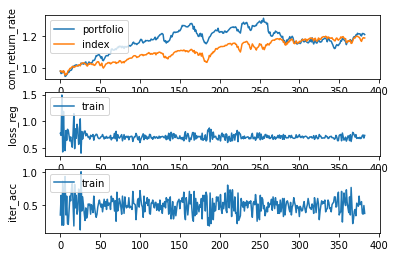

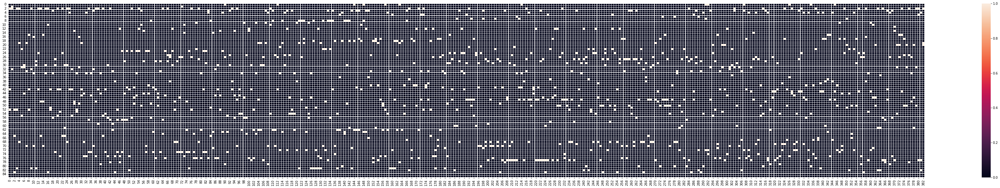

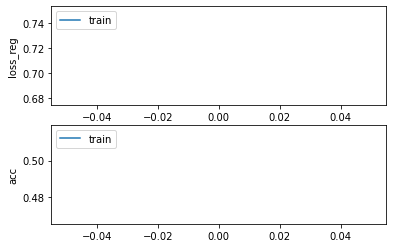

Epochs :  0 Iterations :  383 Loss :  0.7138332410207305 ACC :  0.4924589302925777 MCC :  nan Precision :  0.5045093568552568
mode : validation


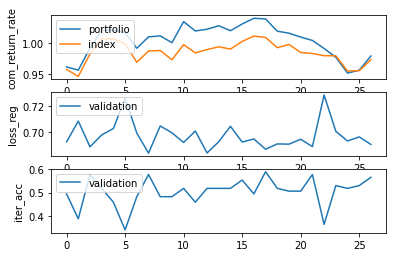

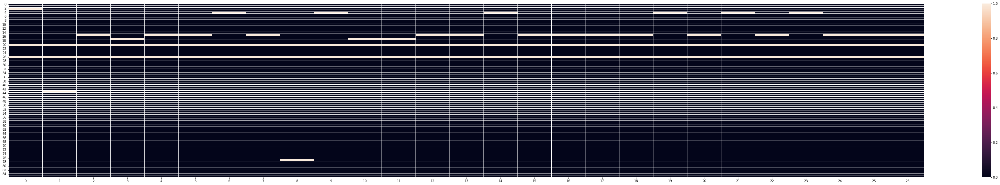

Epochs :  0 Iterations :  27 Loss :  0.6973477248792295 ACC :  0.5028322626043249 MCC :  nan Precision :  0.4921080516996207


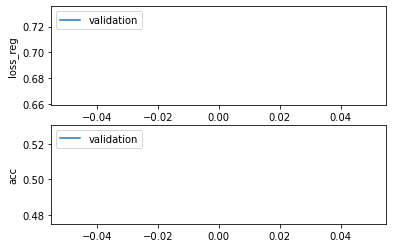

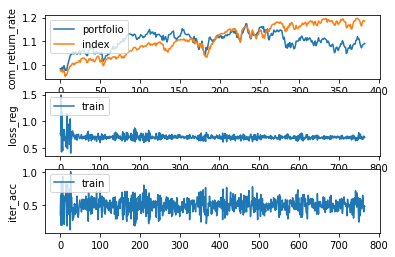

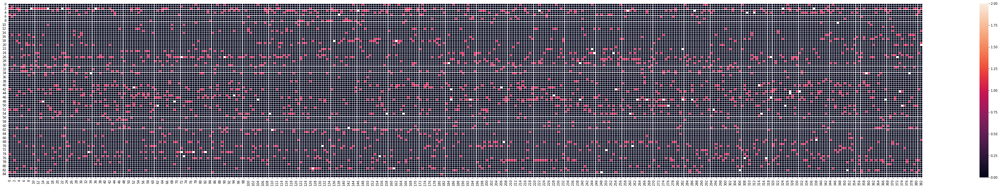

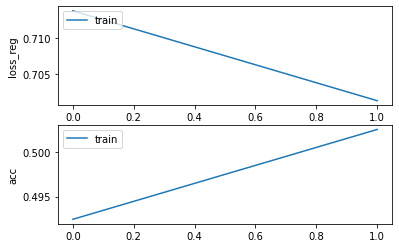

Epochs :  1 Iterations :  766 Loss :  0.701301910702927 ACC :  0.5025341881550945 MCC :  0.003724860191112992 Precision :  0.5128912147299894
mode : validation


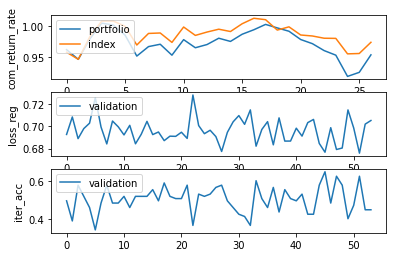

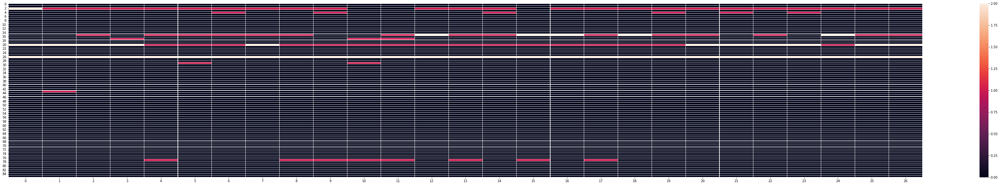

Epochs :  1 Iterations :  27 Loss :  0.6949893015402334 ACC :  0.5006536079777612 MCC :  nan Precision :  0.4903392057038016


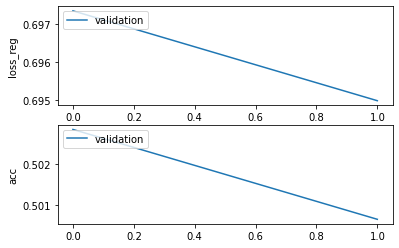

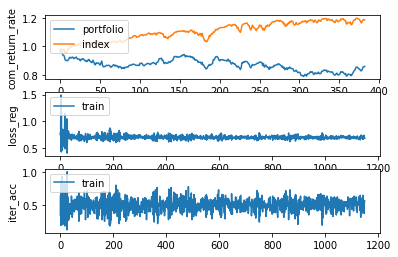

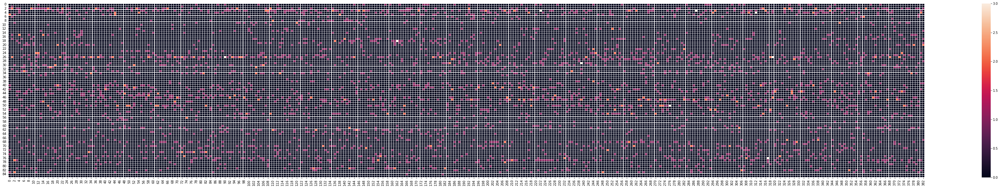

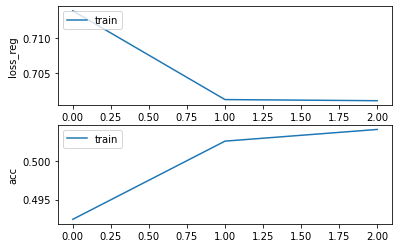

Epochs :  2 Iterations :  1149 Loss :  0.7011427080973632 ACC :  0.5040393337879728 MCC :  0.0132212942513557 Precision :  0.5172423571542722
mode : validation


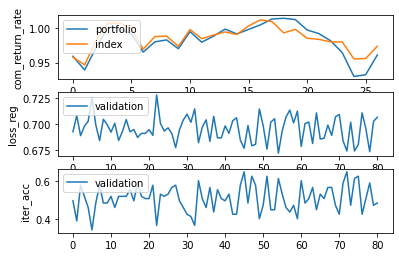

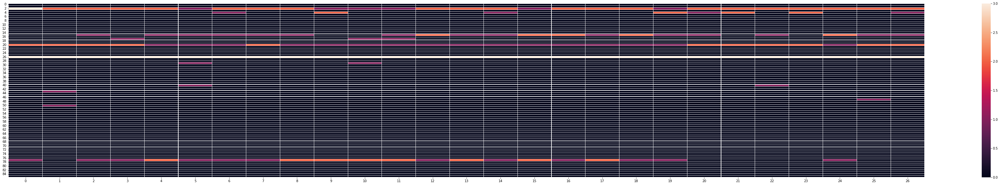

Epochs :  2 Iterations :  27 Loss :  0.6945533001864398 ACC :  0.5176470743285285 MCC :  nan Precision :  0.5057783562827993


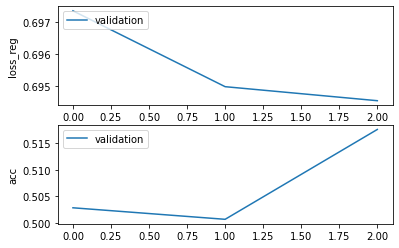

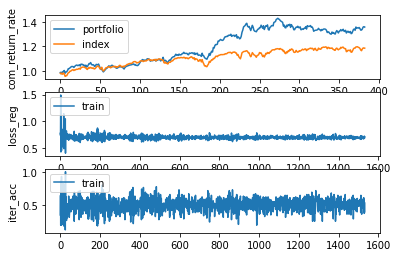

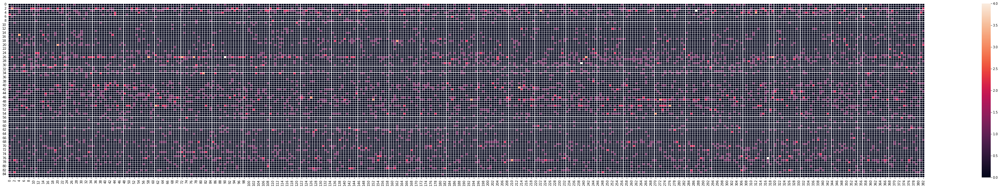

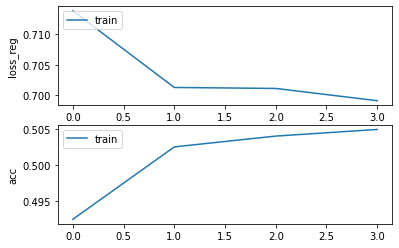

Epochs :  3 Iterations :  1532 Loss :  0.6991370429258122 ACC :  0.5049608506203943 MCC :  0.0124101502621454 Precision :  0.5157217639437621
mode : validation


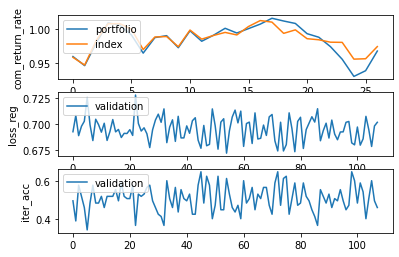

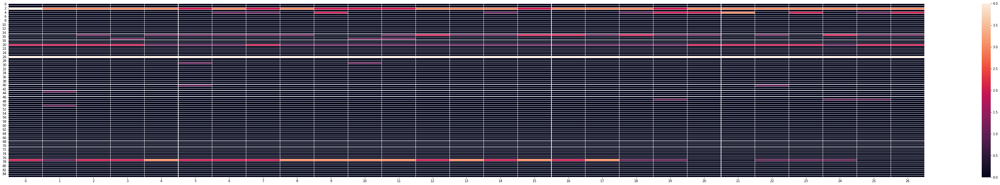

Epochs :  3 Iterations :  27 Loss :  0.6939102565800702 ACC :  0.5054466371183042 MCC :  nan Precision :  0.4964861517979039


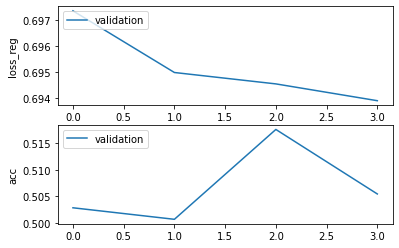

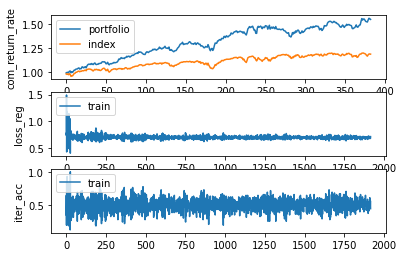

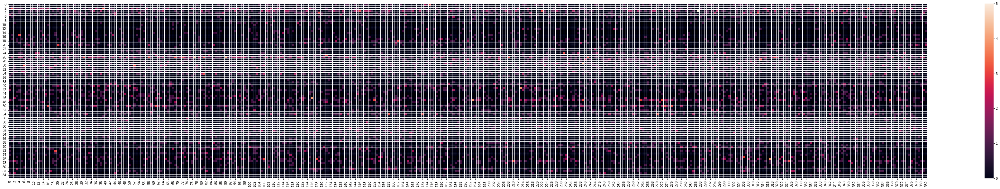

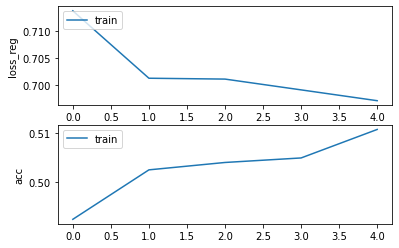

Epochs :  4 Iterations :  1915 Loss :  0.6971232021135076 ACC :  0.5107664111855759 MCC :  0.0192247789829432 Precision :  0.5183575278532256
mode : validation


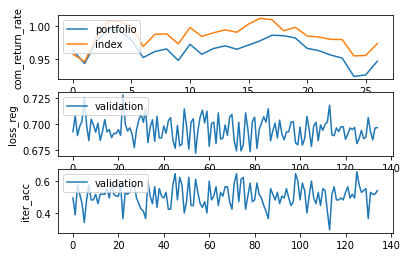

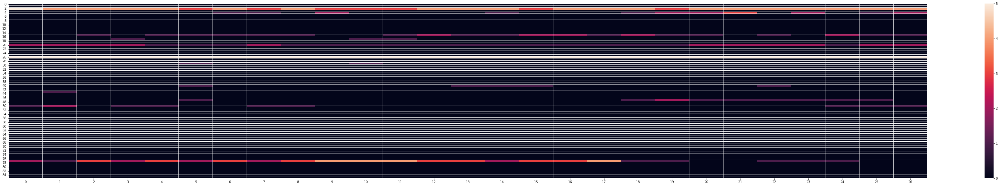

Epochs :  4 Iterations :  27 Loss :  0.6939171000763222 ACC :  0.5084967502841243 MCC :  nan Precision :  0.4971530514044894


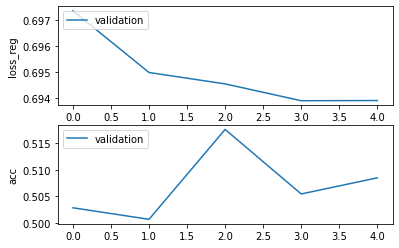

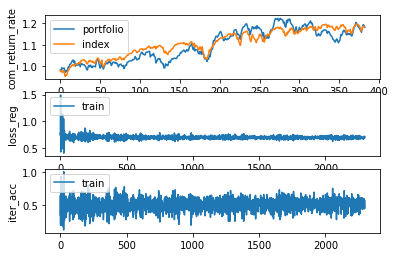

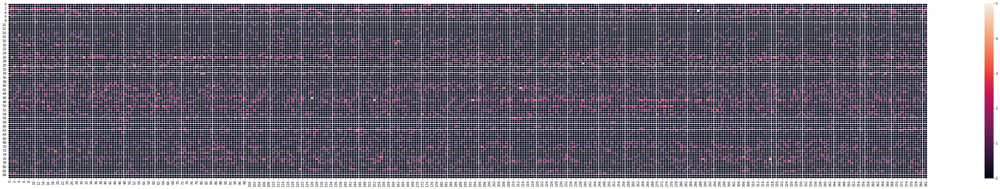

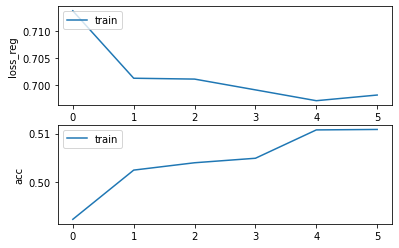

Epochs :  5 Iterations :  2298 Loss :  0.698177663682335 ACC :  0.5108585628454742 MCC :  0.01977886248218241 Precision :  0.5194248840280908
mode : validation


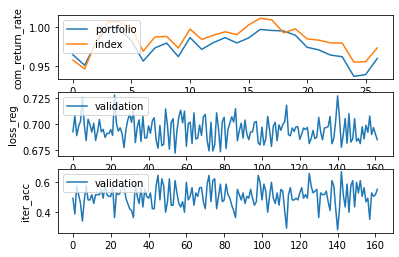

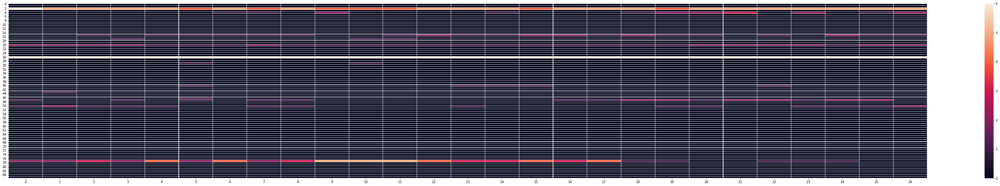

Epochs :  5 Iterations :  27 Loss :  0.6942054452719512 ACC :  0.5063181000727194 MCC :  nan Precision :  0.4921454914190151


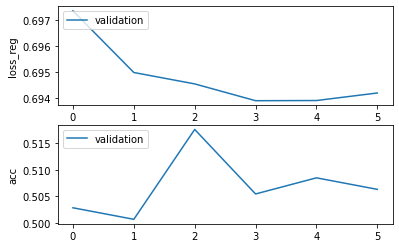

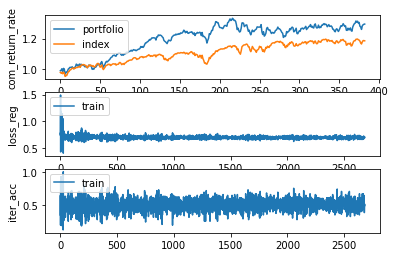

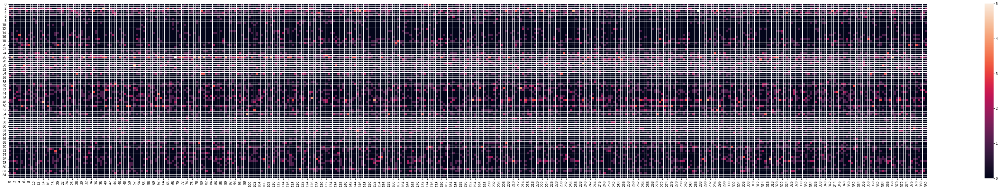

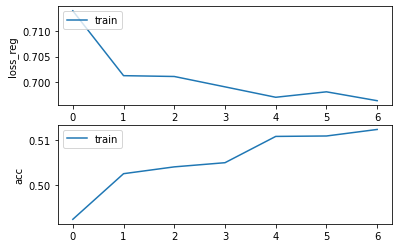

Epochs :  6 Iterations :  2681 Loss :  0.6964594440111603 ACC :  0.5123022736363871 MCC :  0.023989538269727818 Precision :  0.5207599931087724
mode : validation


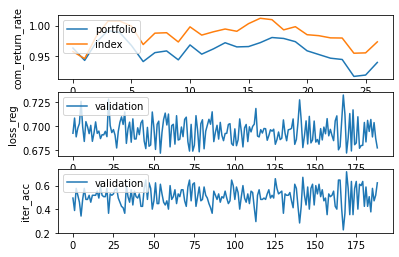

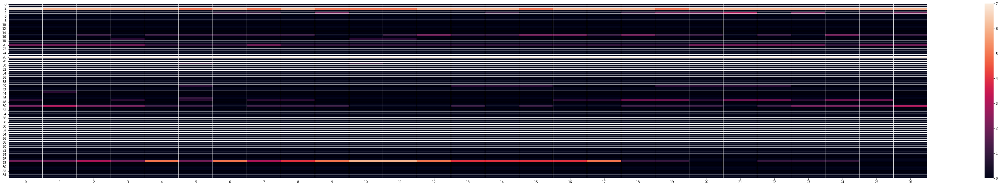

Epochs :  6 Iterations :  27 Loss :  0.6943274868859185 ACC :  0.507625287881604 MCC :  nan Precision :  0.4959516028563182


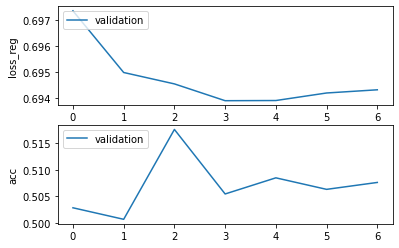

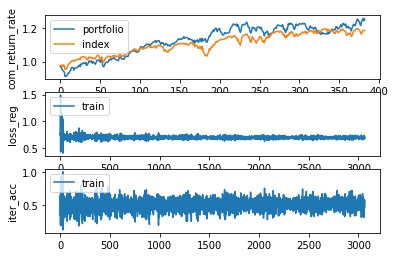

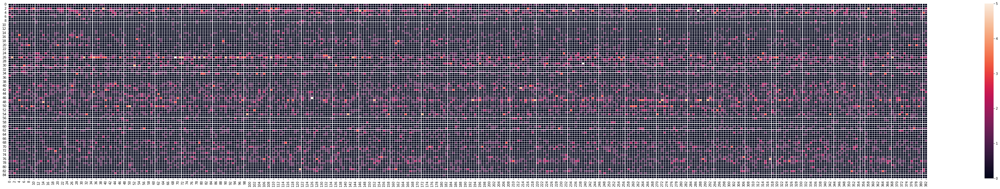

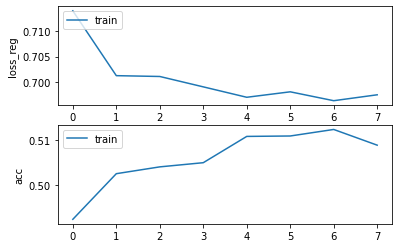

Epochs :  7 Iterations :  3064 Loss :  0.6976017365256426 ACC :  0.5088312242267649 MCC :  0.01665438585805247 Precision :  0.5176163645456339
mode : validation


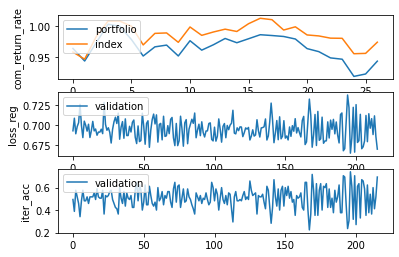

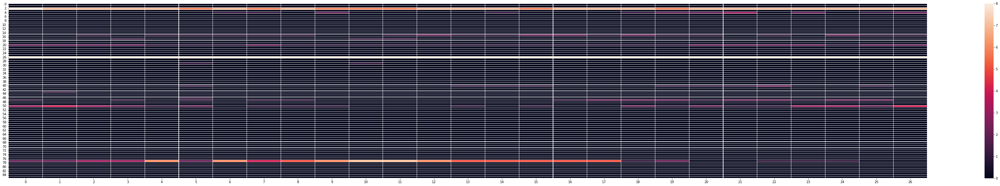

Epochs :  7 Iterations :  27 Loss :  0.6944292408448679 ACC :  0.5098039369892191 MCC :  nan Precision :  0.4969139812445199


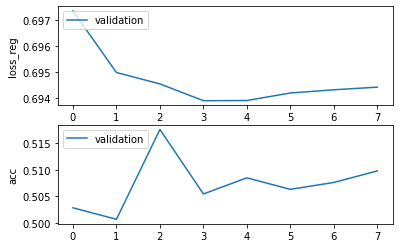

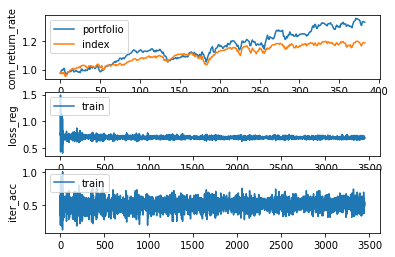

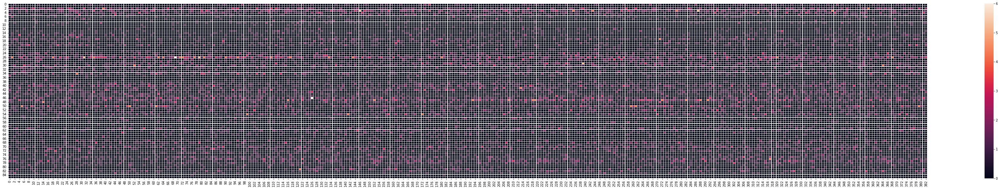

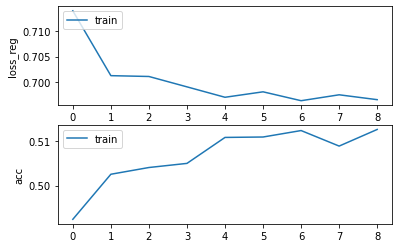

Epochs :  8 Iterations :  3447 Loss :  0.6966596642611232 ACC :  0.5125480119148683 MCC :  0.01952596008884003 Precision :  0.5191339321979188
mode : validation


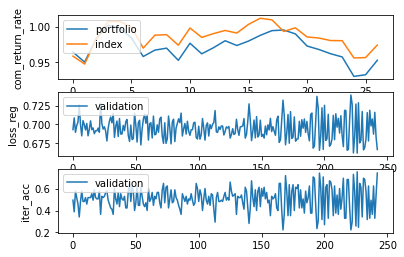

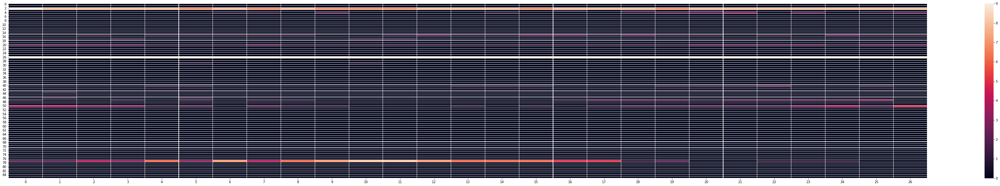

Epochs :  8 Iterations :  27 Loss :  0.6945140030648973 ACC :  0.4980392301524127 MCC :  nan Precision :  0.4910343332147157


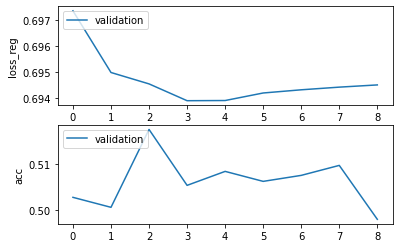

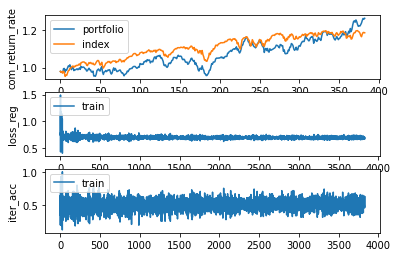

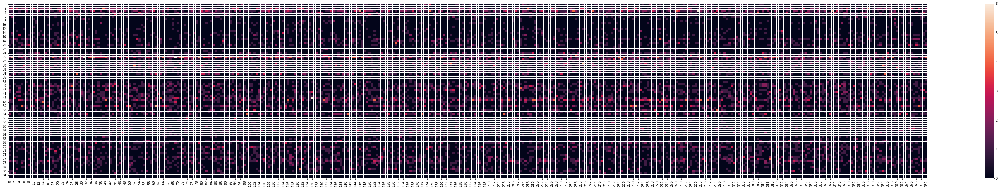

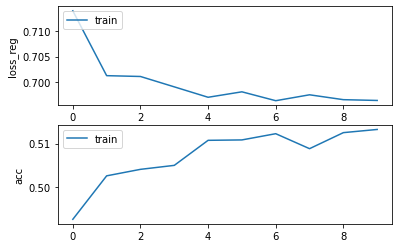

Epochs :  9 Iterations :  3830 Loss :  0.6965072705913773 ACC :  0.5132852264390602 MCC :  0.027469930401030566 Precision :  0.5217633416618441
mode : validation


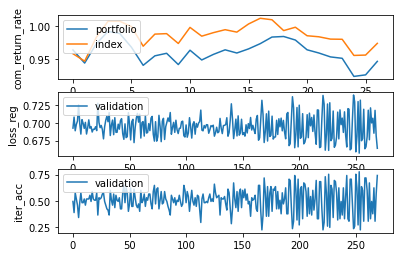

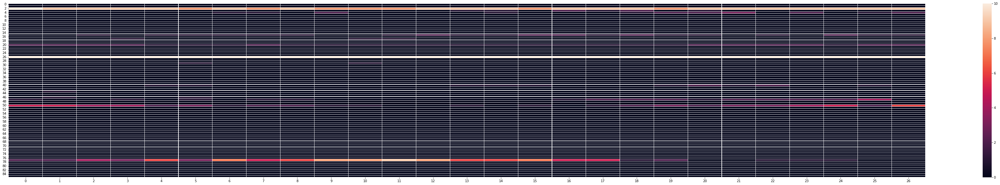

Epochs :  9 Iterations :  27 Loss :  0.6945685987119321 ACC :  0.5050109072967812 MCC :  nan Precision :  0.49420441397362286


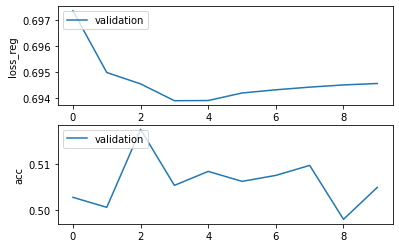

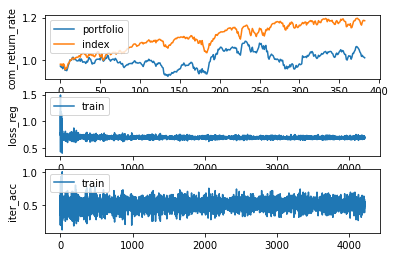

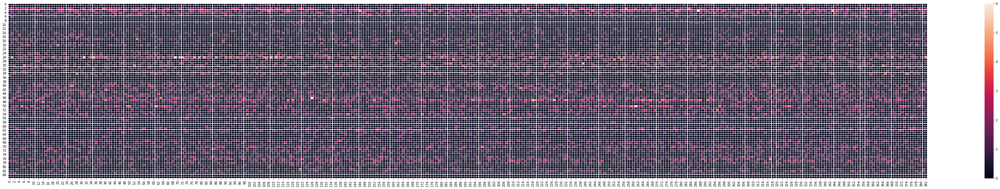

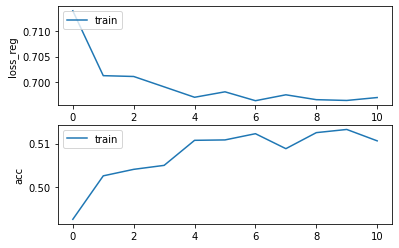

Epochs :  10 Iterations :  4213 Loss :  0.6970716069012336 ACC :  0.5106435420463353 MCC :  0.017921096652742552 Precision :  0.5187280455959217
mode : validation


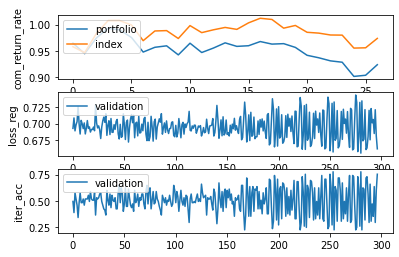

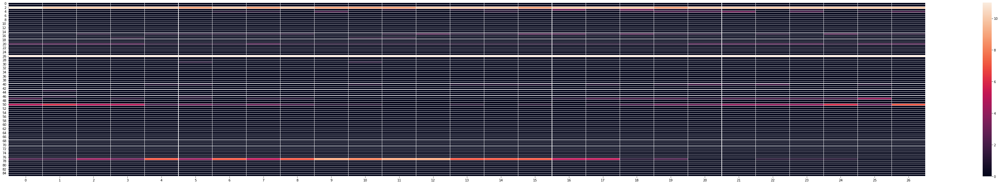

Epochs :  10 Iterations :  27 Loss :  0.6946042555349844 ACC :  0.501525068172702 MCC :  nan Precision :  0.49237074827154476


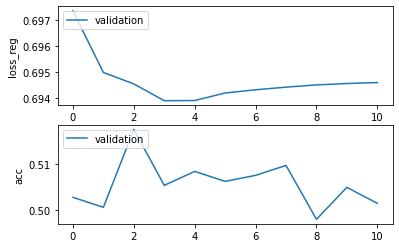

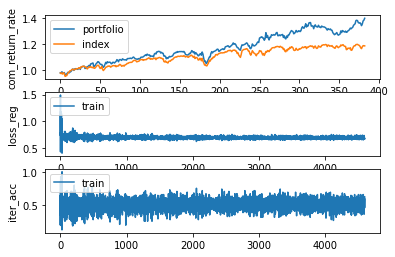

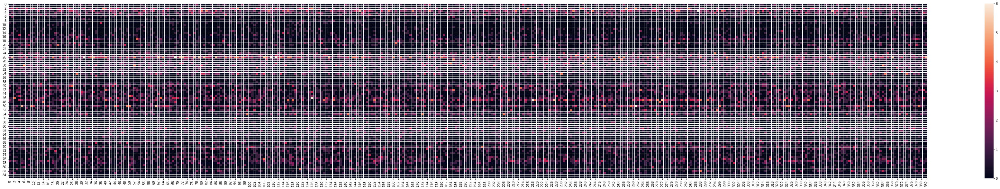

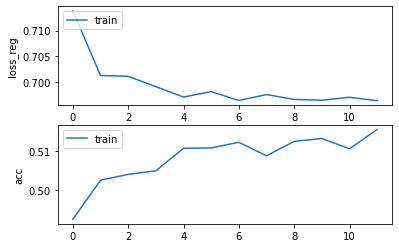

Epochs :  11 Iterations :  4596 Loss :  0.6964113360596699 ACC :  0.5156197375168066 MCC :  0.030369891252553495 Precision :  0.5235964337621595
mode : validation


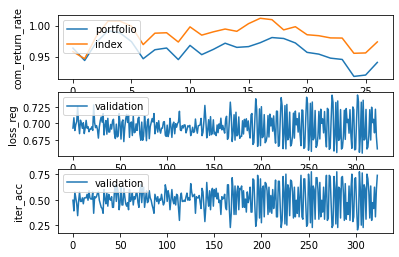

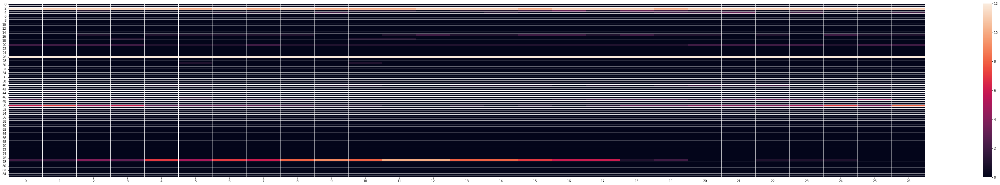

Epochs :  11 Iterations :  27 Loss :  0.694685161113739 ACC :  0.5019607974423302 MCC :  nan Precision :  0.4933843007656159


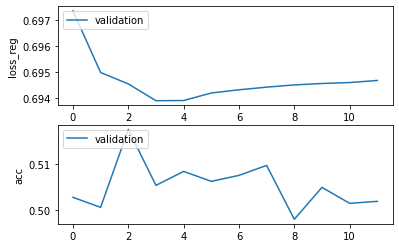

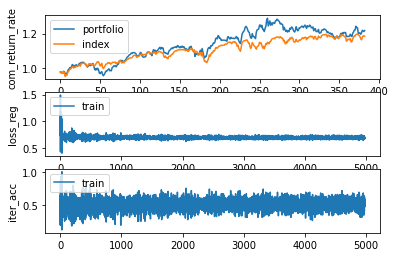

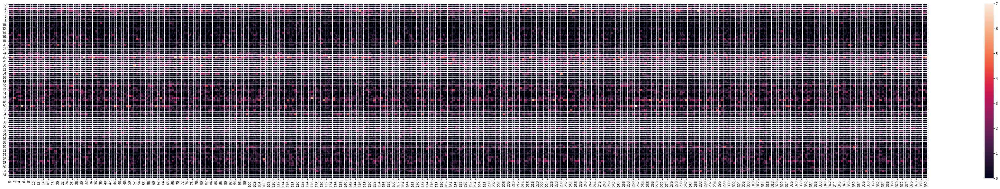

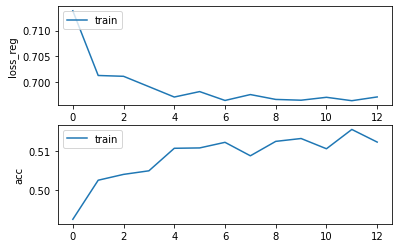

Epochs :  12 Iterations :  4979 Loss :  0.6971415279739519 ACC :  0.5123637082838203 MCC :  0.021191572574728385 Precision :  0.5193239201599484
mode : validation


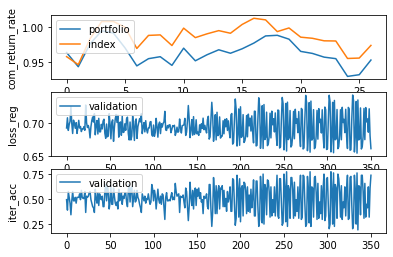

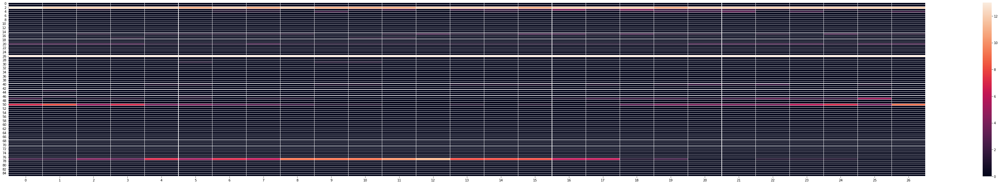

Epochs :  12 Iterations :  27 Loss :  0.6949831446011862 ACC :  0.5028322576372711 MCC :  nan Precision :  0.4940061689940868


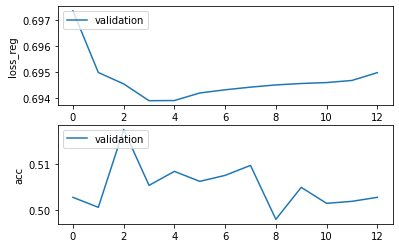

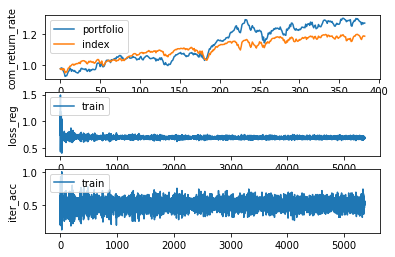

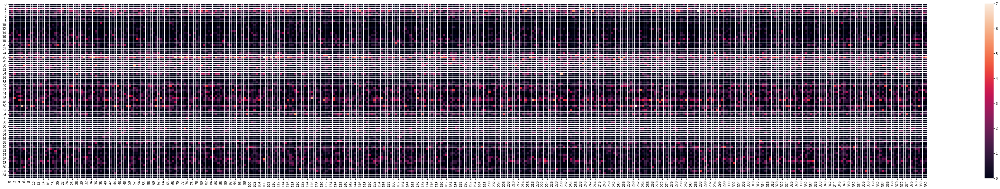

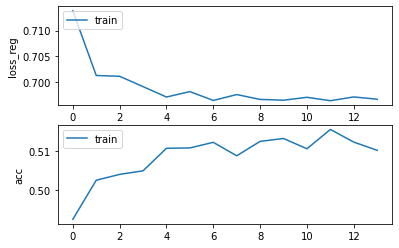

Epochs :  13 Iterations :  5362 Loss :  0.696697810922528 ACC :  0.5102442183164642 MCC :  0.021593923089288994 Precision :  0.5188520988133339
mode : validation


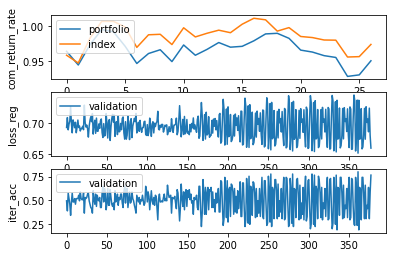

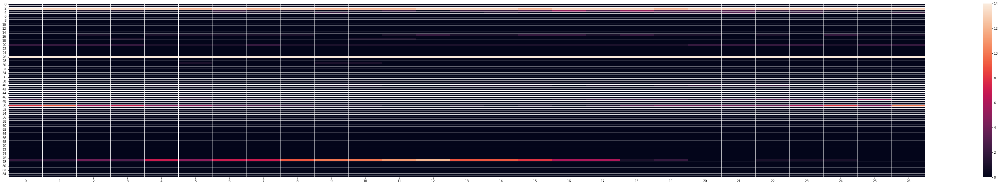

Epochs :  13 Iterations :  27 Loss :  0.6947406662835015 ACC :  0.5023965272638533 MCC :  nan Precision :  0.49277351617261217


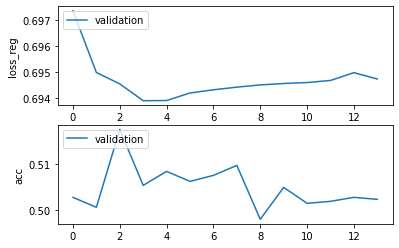

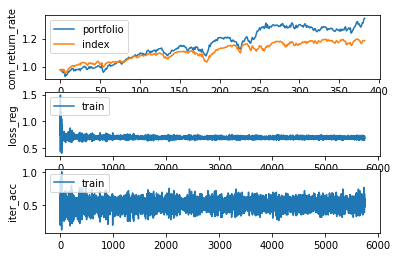

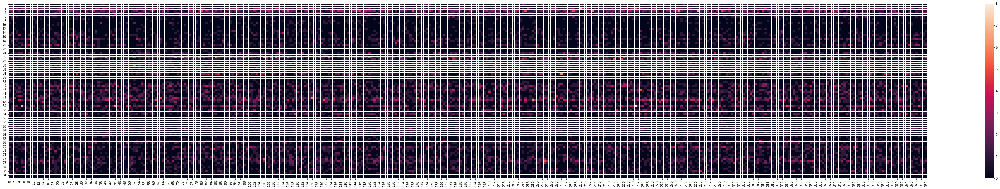

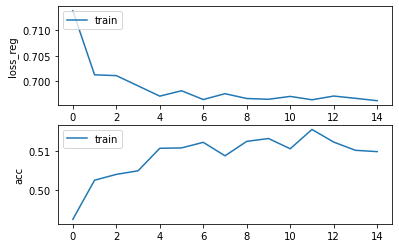

Epochs :  14 Iterations :  5745 Loss :  0.6962285093165564 ACC :  0.5099063286115233 MCC :  0.013999935048364841 Precision :  0.5166233456049202
mode : validation


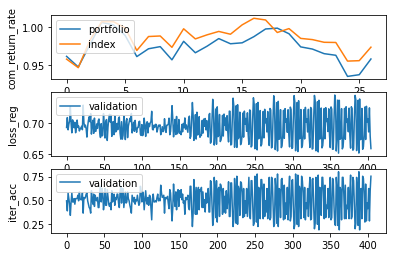

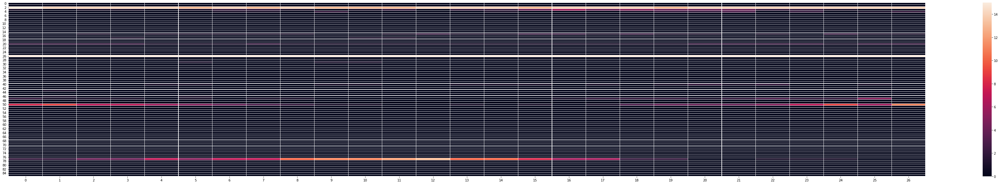

Epochs :  14 Iterations :  27 Loss :  0.6949409930794327 ACC :  0.500217878708133 MCC :  nan Precision :  0.49335689690929874


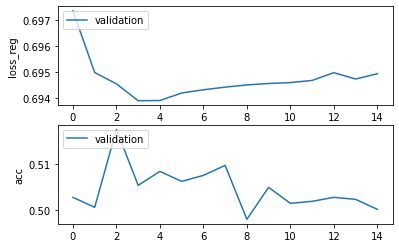

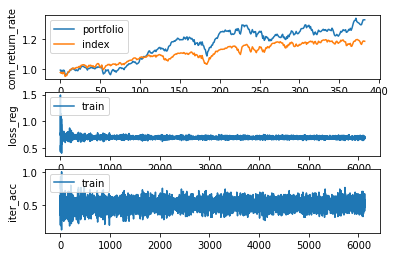

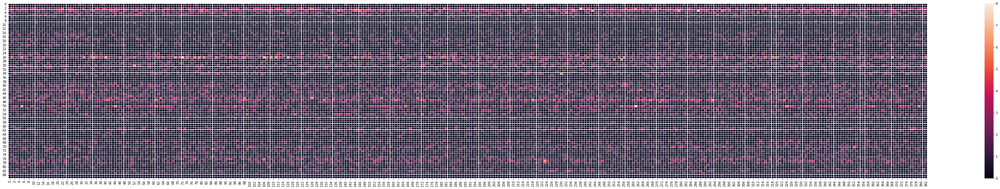

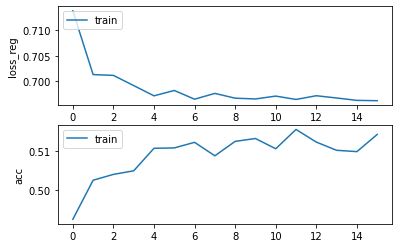

Epochs :  15 Iterations :  6128 Loss :  0.696163426646987 ACC :  0.514329612488535 MCC :  0.02556711809290816 Precision :  0.5208616042339459
mode : validation


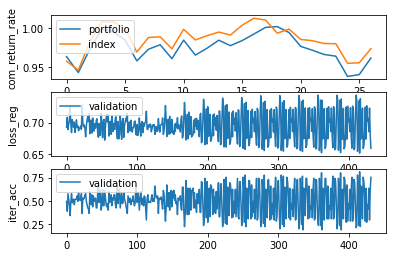

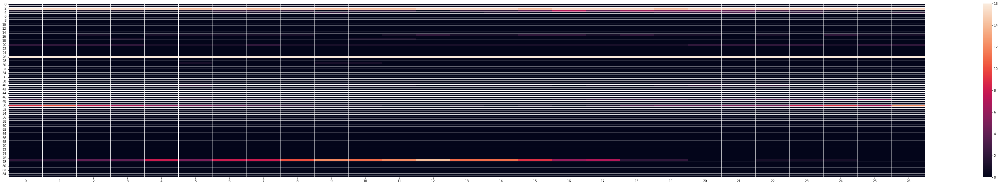

Epochs :  15 Iterations :  27 Loss :  0.6950037567703812 ACC :  0.5023965272638533 MCC :  nan Precision :  0.4939947048271144


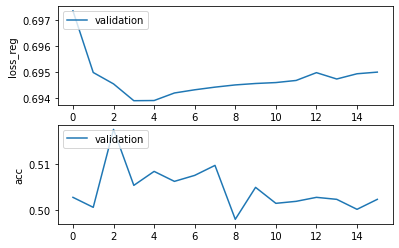

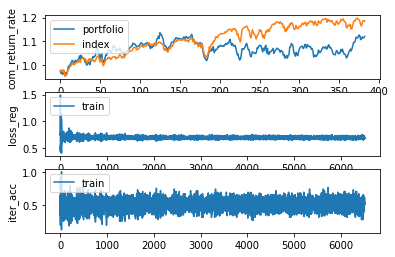

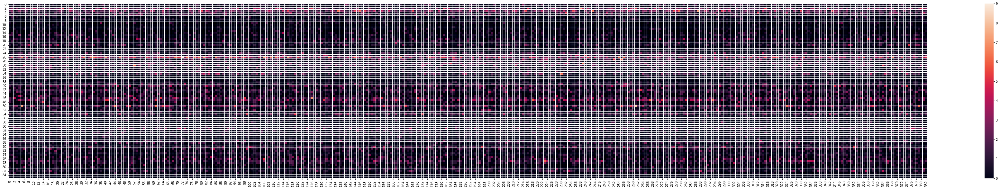

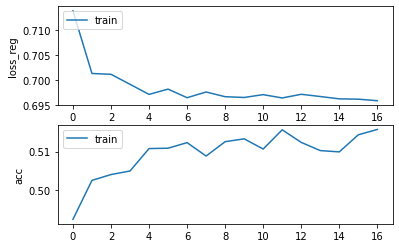

Epochs :  16 Iterations :  6511 Loss :  0.6958595792867496 ACC :  0.5157118897213948 MCC :  0.030257257091260804 Precision :  0.522445886714418
mode : validation


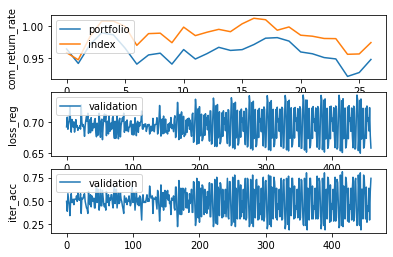

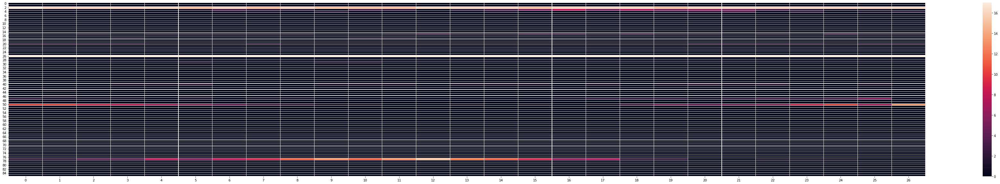

Epochs :  16 Iterations :  27 Loss :  0.6948121322525872 ACC :  0.5002178781562381 MCC :  nan Precision :  0.4920894118646781


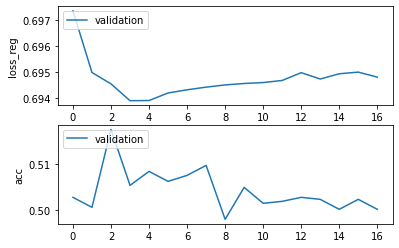

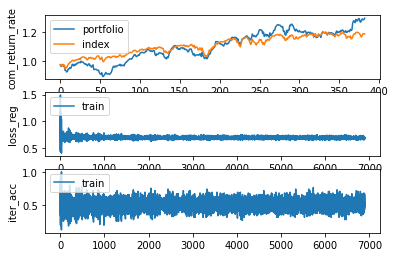

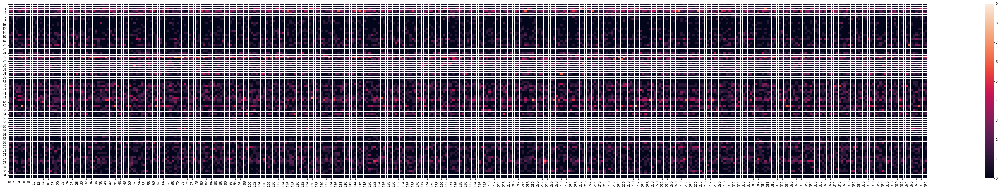

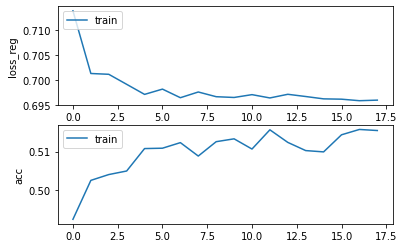

Epochs :  17 Iterations :  6894 Loss :  0.6959729631949343 ACC :  0.5154354324851272 MCC :  0.02921401281499452 Precision :  0.5217521056027076
mode : validation


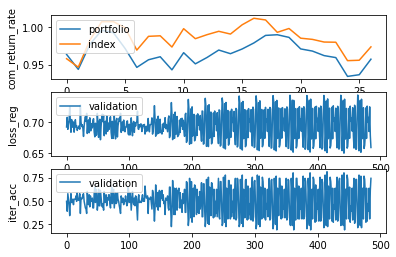

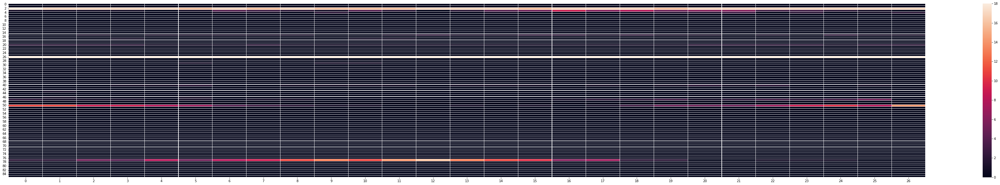

Epochs :  17 Iterations :  27 Loss :  0.6949779435440346 ACC :  0.500217878708133 MCC :  nan Precision :  0.49255955274458285


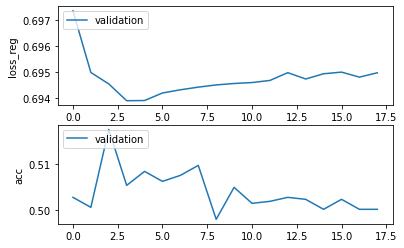

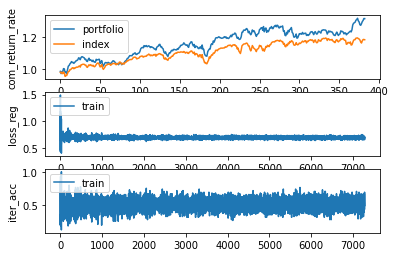

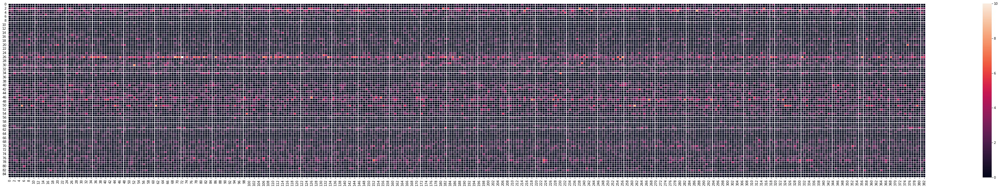

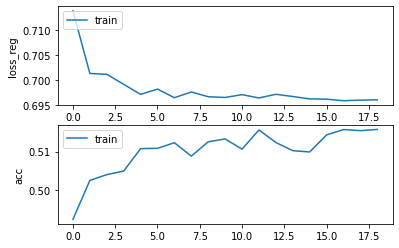

Epochs :  18 Iterations :  7277 Loss :  0.6960329332488635 ACC :  0.5157426059557315 MCC :  0.0325593451805797 Precision :  0.5236506631680553
mode : validation


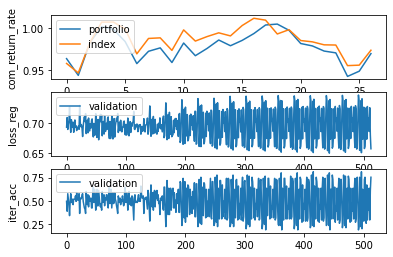

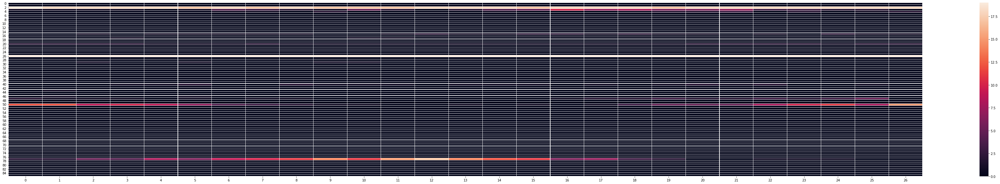

Epochs :  18 Iterations :  27 Loss :  0.6949427657657199 ACC :  0.49716776940557694 MCC :  nan Precision :  0.4908615665993205


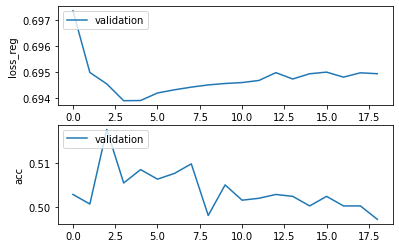

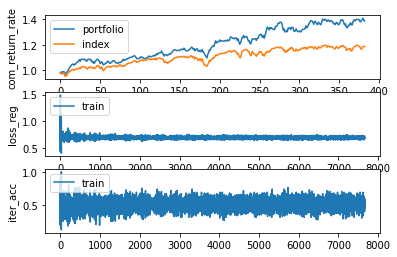

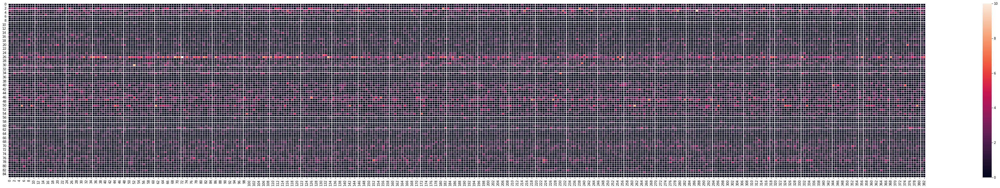

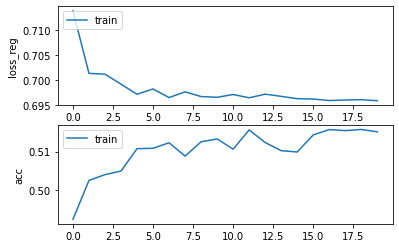

Epochs :  19 Iterations :  7660 Loss :  0.6958277868228544 ACC :  0.5151282604929672 MCC :  0.02963061500510916 Precision :  0.5223581432206824
mode : validation


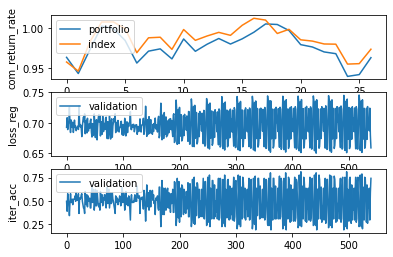

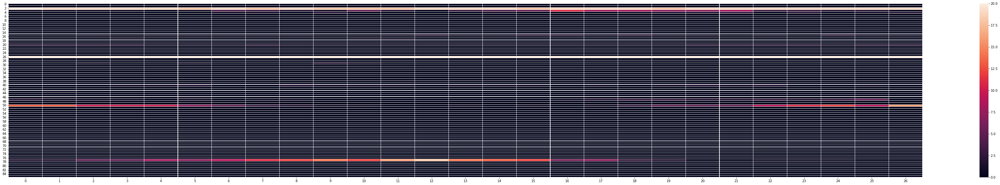

Epochs :  19 Iterations :  27 Loss :  0.6949098684169628 ACC :  0.4997821483347151 MCC :  nan Precision :  0.49250716612570816


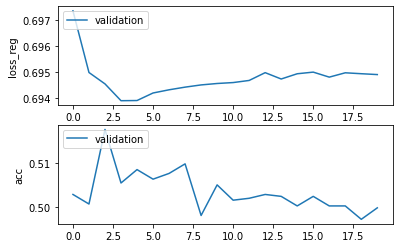

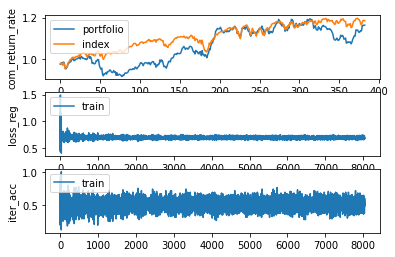

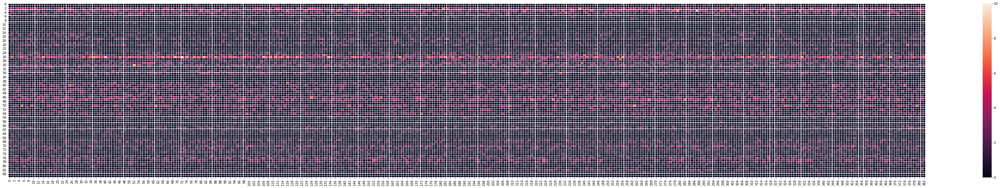

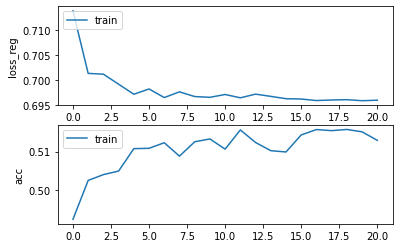

Epochs :  20 Iterations :  8043 Loss :  0.6959289774571012 ACC :  0.5129166187100871 MCC :  0.022133236868591498 Precision :  0.5200402203986212
mode : validation


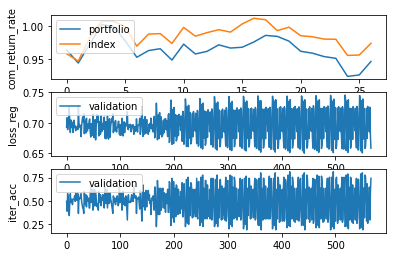

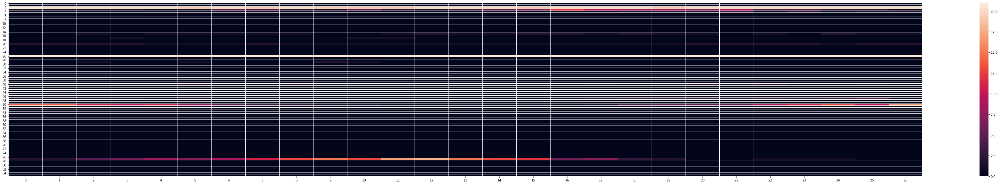

Epochs :  20 Iterations :  27 Loss :  0.6948456190250538 ACC :  0.5019607974423302 MCC :  nan Precision :  0.493468830499936


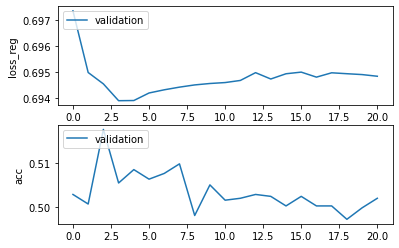

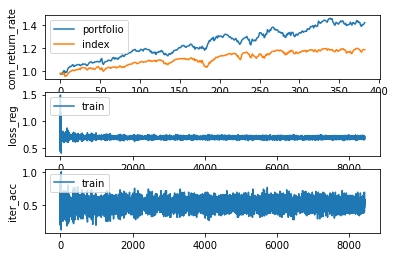

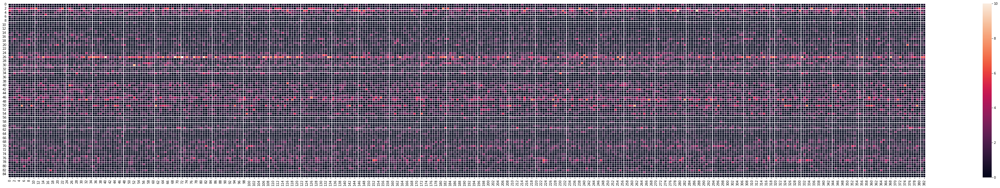

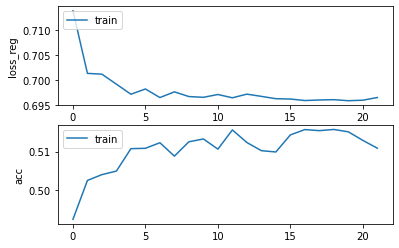

Epochs :  21 Iterations :  8426 Loss :  0.6964654298426277 ACC :  0.5108892812585706 MCC :  0.017389785056427978 Precision :  0.5181012587383507
mode : validation


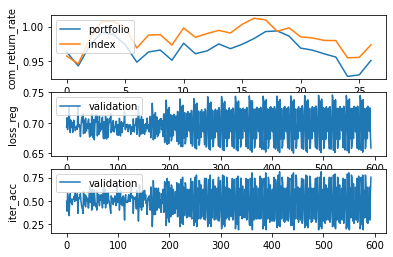

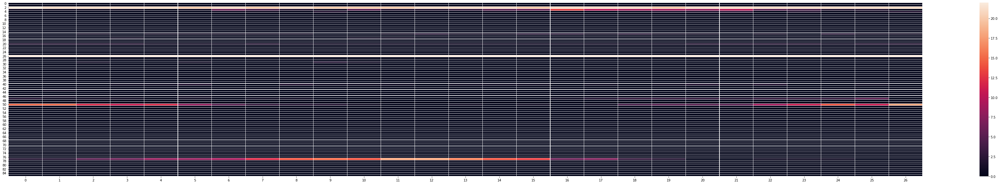

Epochs :  21 Iterations :  27 Loss :  0.6949614308498524 ACC :  0.49847495887014603 MCC :  nan Precision :  0.49216535832318997


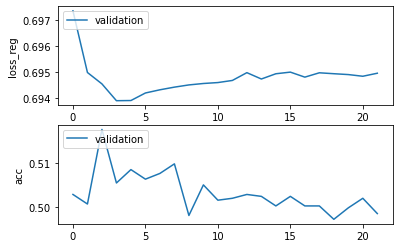

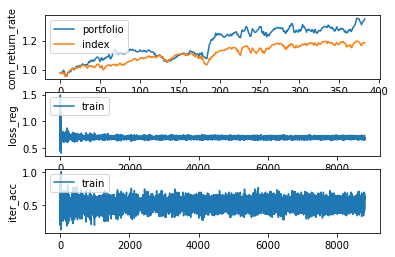

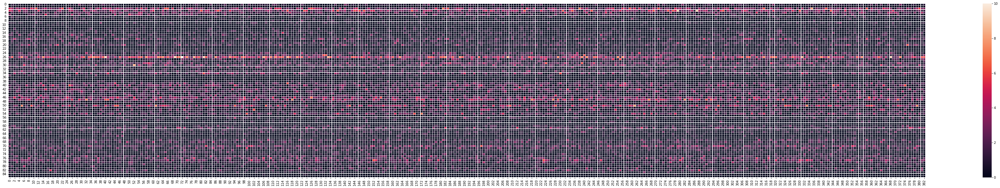

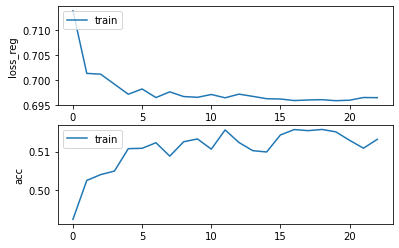

Epochs :  22 Iterations :  8809 Loss :  0.6964365338843422 ACC :  0.5131930737675948 MCC :  0.02570066139130554 Precision :  0.5208048463285981
mode : validation


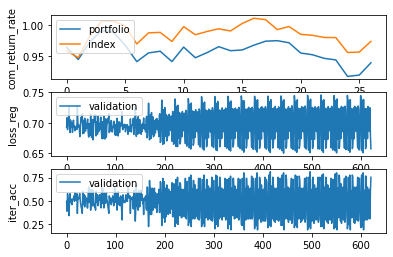

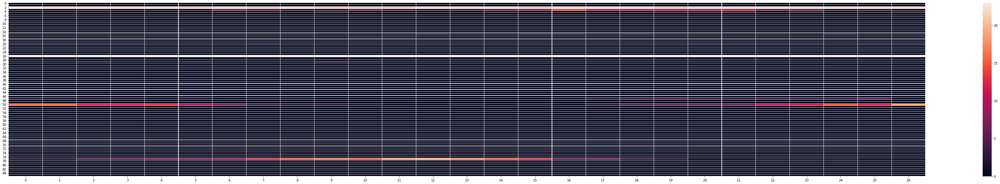

Epochs :  22 Iterations :  27 Loss :  0.6949037114779154 ACC :  0.5019607974423302 MCC :  nan Precision :  0.49142098364730674


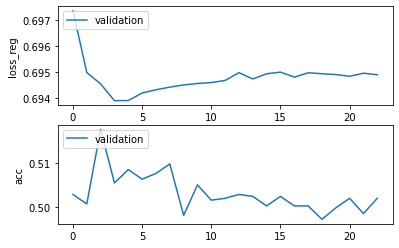

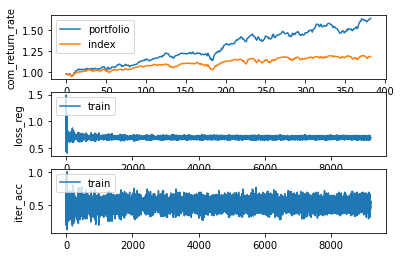

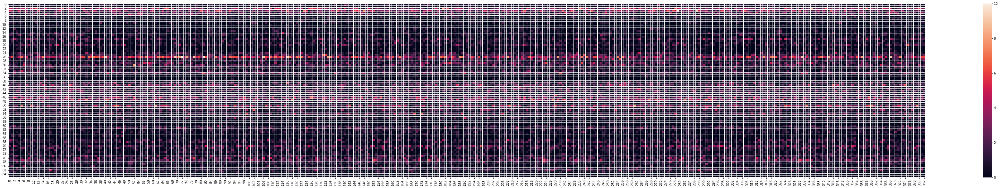

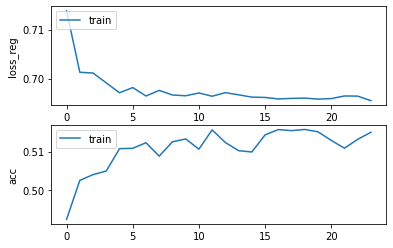

Epochs :  23 Iterations :  9192 Loss :  0.6954989753877525 ACC :  0.5150053915093524 MCC :  0.026986175990151608 Precision :  0.5217759582911942
mode : validation


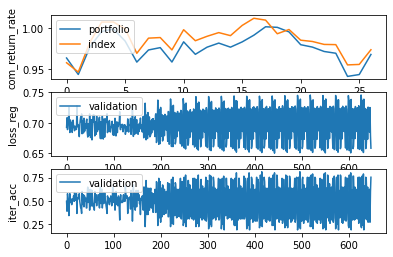

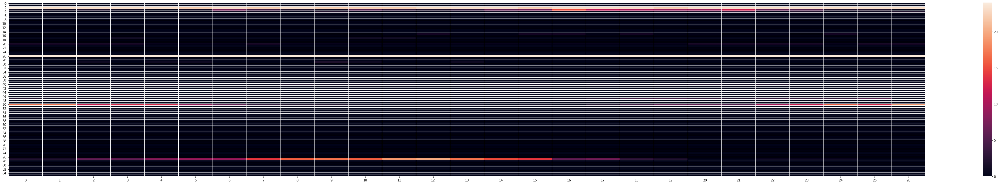

Epochs :  23 Iterations :  27 Loss :  0.695011991041678 ACC :  0.5006536079777612 MCC :  nan Precision :  0.4947839350336128


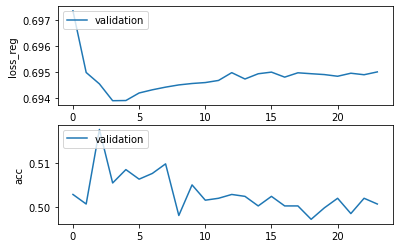

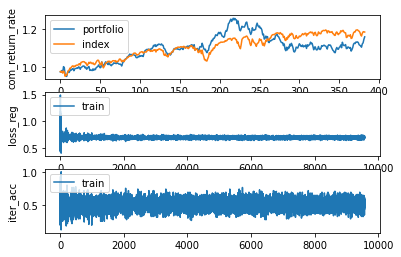

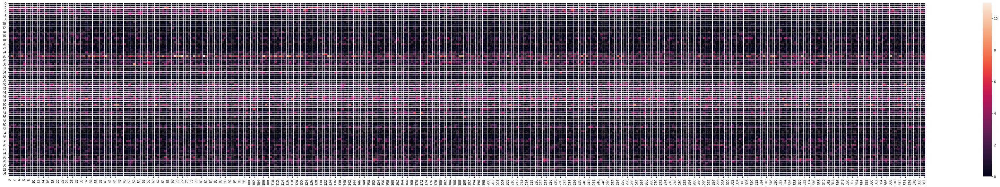

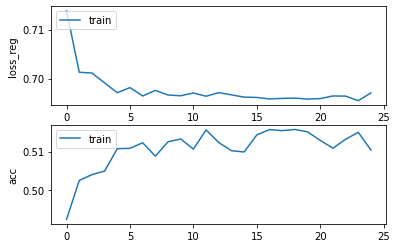

Epochs :  24 Iterations :  9575 Loss :  0.6970971702906855 ACC :  0.5103978048572341 MCC :  0.019400406947393485 Precision :  0.5197167289163674
mode : validation


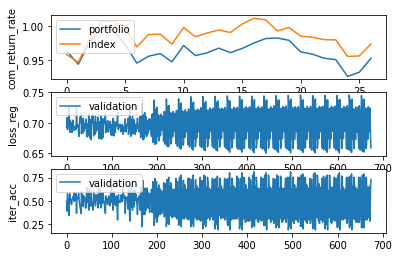

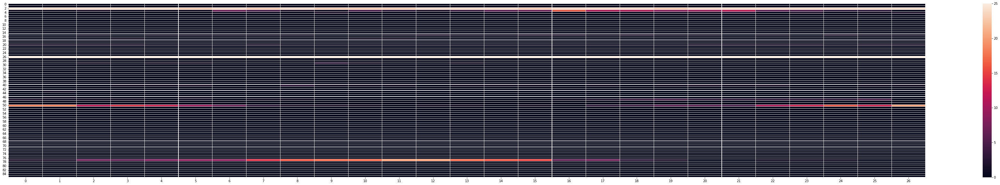

Epochs :  24 Iterations :  27 Loss :  0.694930719004737 ACC :  0.5015250676208072 MCC :  nan Precision :  0.49216690390474266


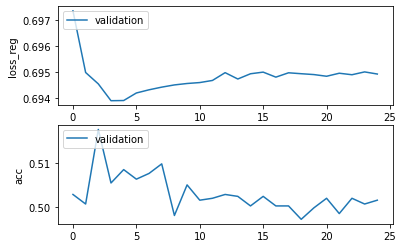

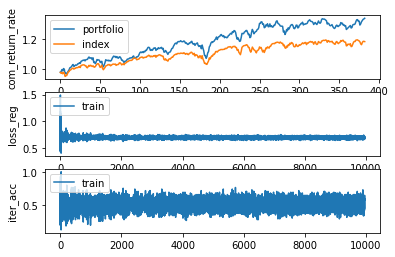

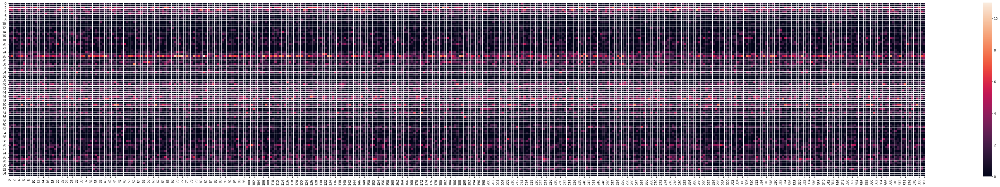

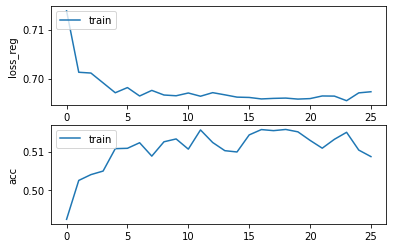

Epochs :  25 Iterations :  9958 Loss :  0.6973274284803525 ACC :  0.5087083554765885 MCC :  0.019283963696983722 Precision :  0.5179426912996461
mode : validation


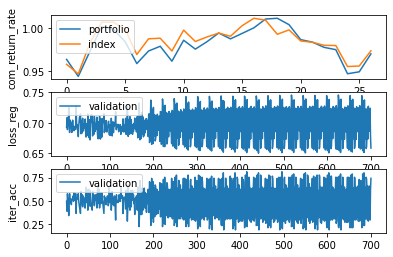

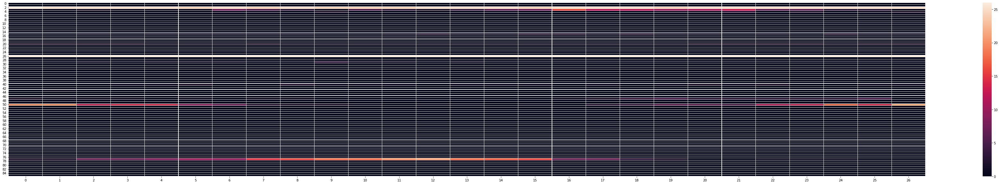

Epochs :  25 Iterations :  27 Loss :  0.6949269440439012 ACC :  0.5041394465499454 MCC :  nan Precision :  0.494385771729328


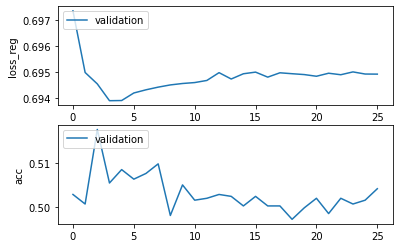

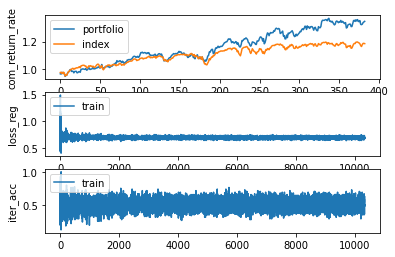

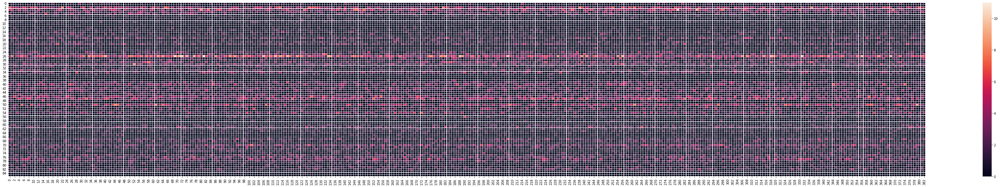

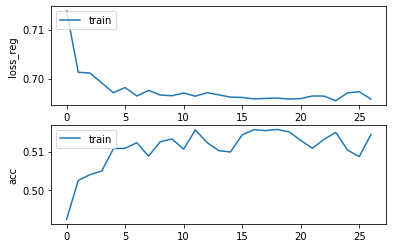

Epochs :  26 Iterations :  10341 Loss :  0.6958357262237888 ACC :  0.5144217634481176 MCC :  0.030929953399705203 Precision :  0.5218856470712872
mode : validation


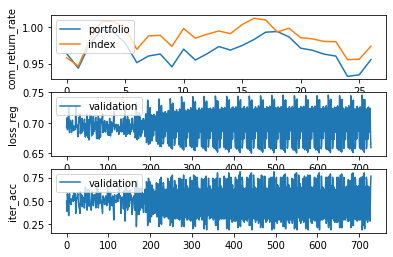

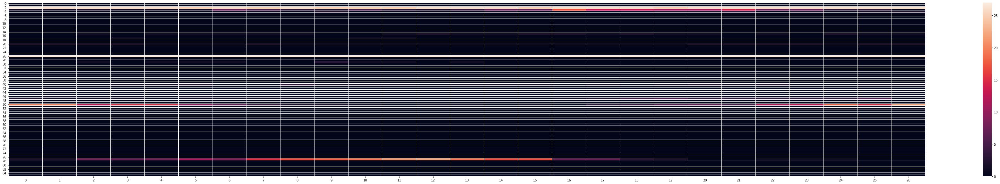

Epochs :  26 Iterations :  27 Loss :  0.6950816622486821 ACC :  0.5054466365664093 MCC :  nan Precision :  0.49394512493853215


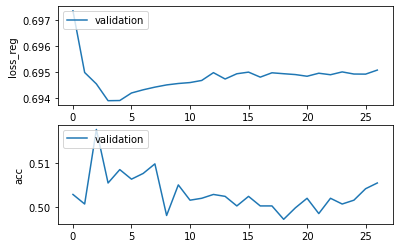

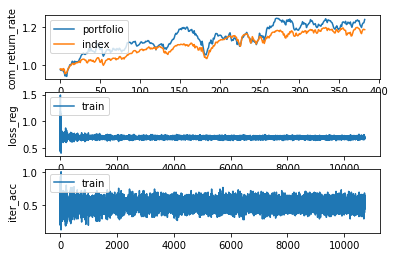

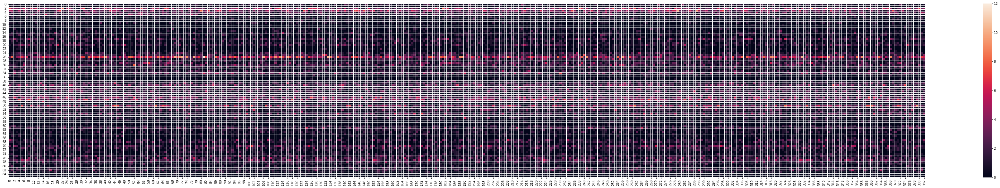

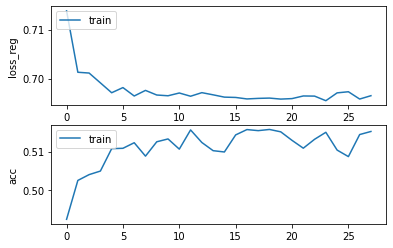

Epochs :  27 Iterations :  10724 Loss :  0.6965199853670504 ACC :  0.5152204126975555 MCC :  0.03276159350915907 Precision :  0.5246846871766658
mode : validation


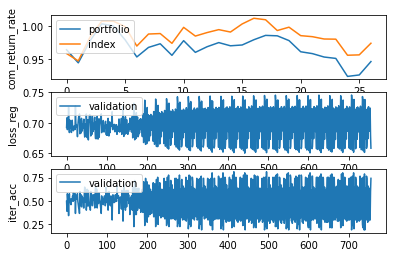

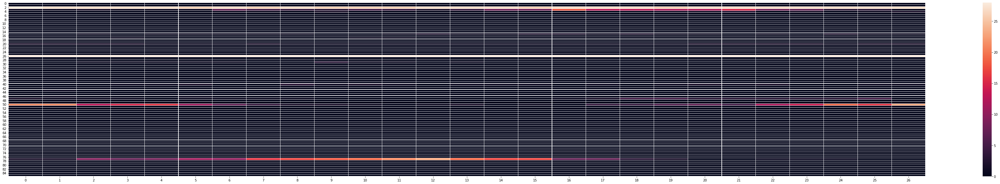

Epochs :  27 Iterations :  27 Loss :  0.6949146323733859 ACC :  0.49934641851319206 MCC :  nan Precision :  0.4936880665934748


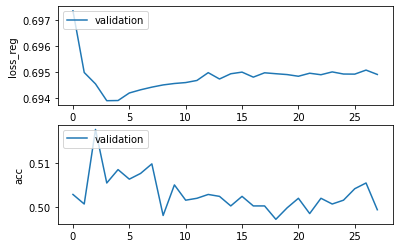

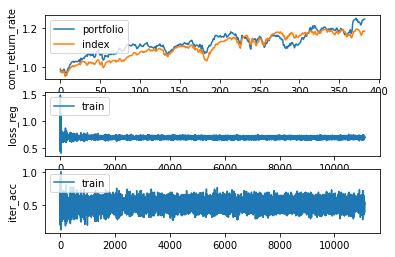

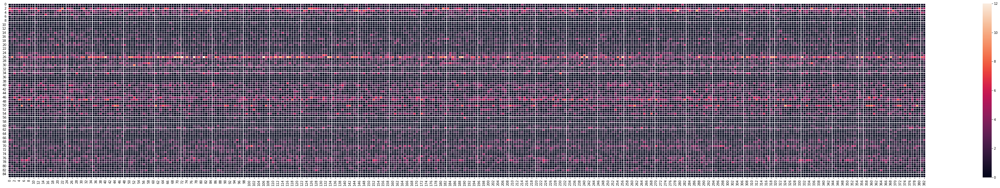

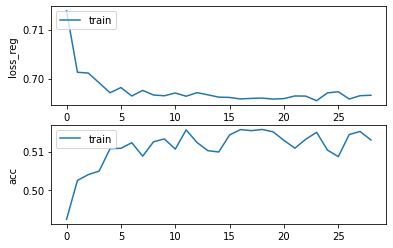

Epochs :  28 Iterations :  11107 Loss :  0.6966135175047593 ACC :  0.5130087717706168 MCC :  0.020823128071130927 Precision :  0.520202723767015
mode : validation


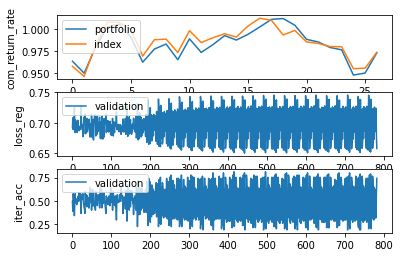

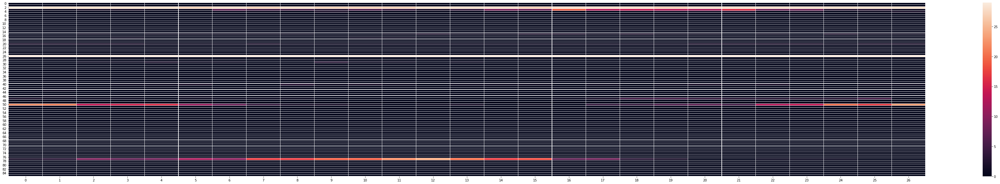

Epochs :  28 Iterations :  27 Loss :  0.6948174569341872 ACC :  0.5019607974423302 MCC :  nan Precision :  0.49166447131170166


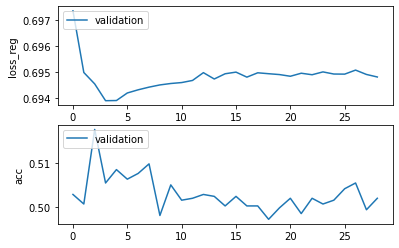

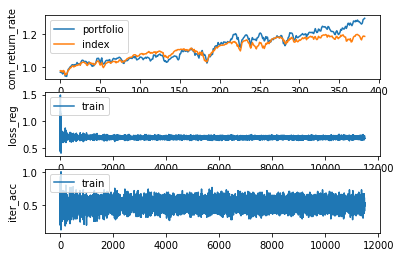

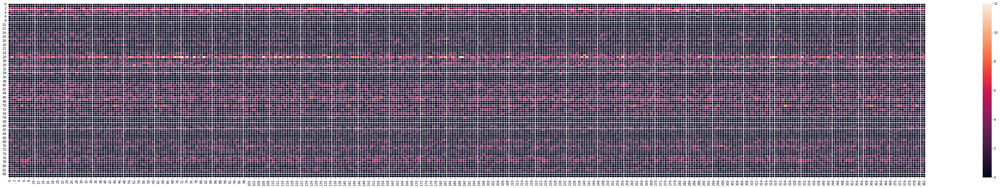

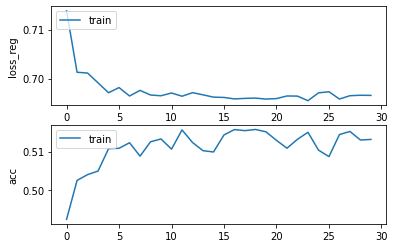

Epochs :  29 Iterations :  11490 Loss :  0.6965827135753383 ACC :  0.5131623567551297 MCC :  0.02288098576115128 Precision :  0.5203237638276255
mode : validation


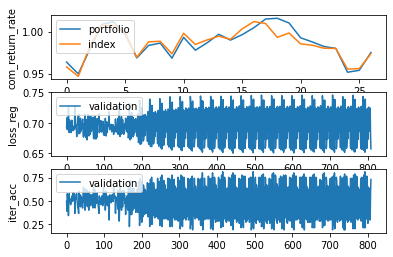

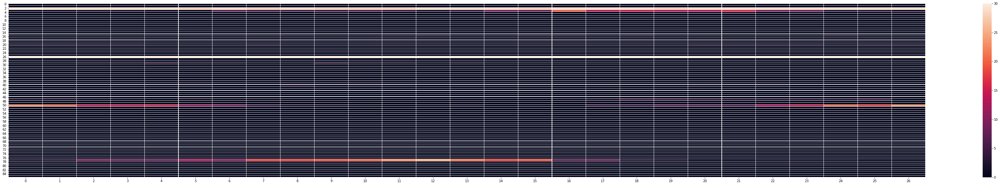

Epochs :  29 Iterations :  27 Loss :  0.6948095582149647 ACC :  0.4997821483347151 MCC :  nan Precision :  0.49182053427729344


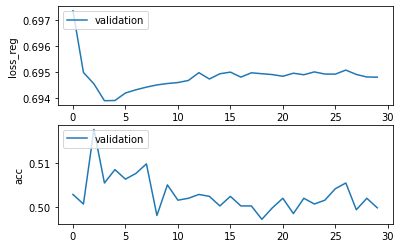

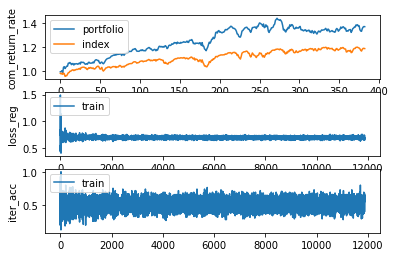

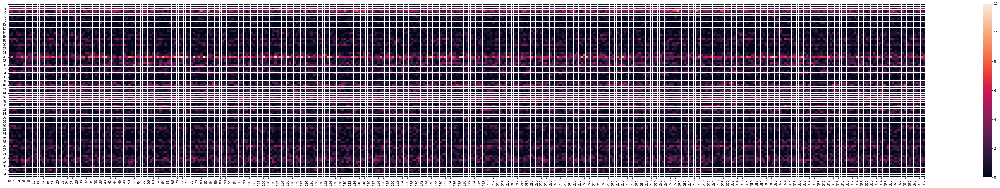

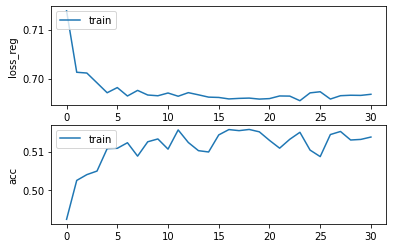

Epochs :  30 Iterations :  11873 Loss :  0.6968092523106707 ACC :  0.5137767022178938 MCC :  0.02429114388941493 Precision :  0.5206002771183265
mode : validation


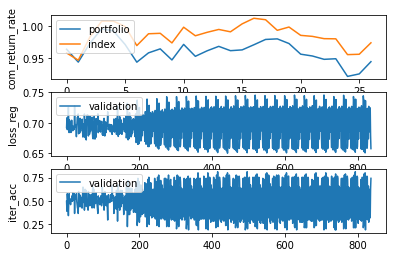

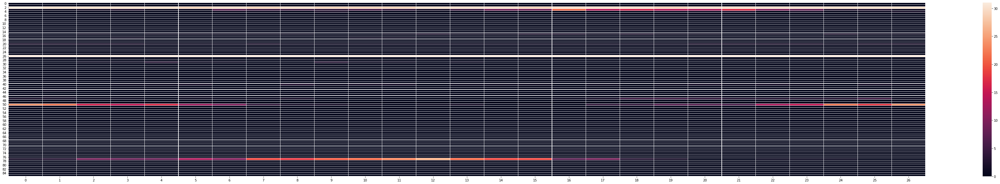

Epochs :  30 Iterations :  27 Loss :  0.6949451455363521 ACC :  0.5071895553006066 MCC :  nan Precision :  0.4936006662470323


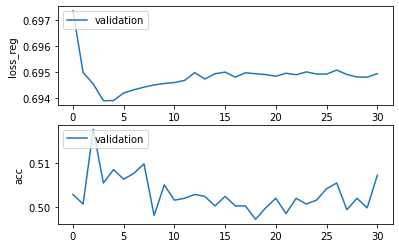

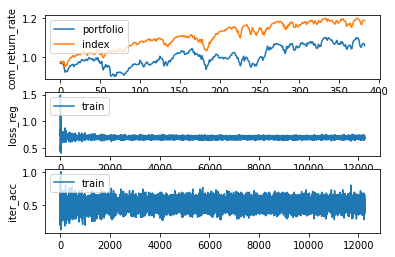

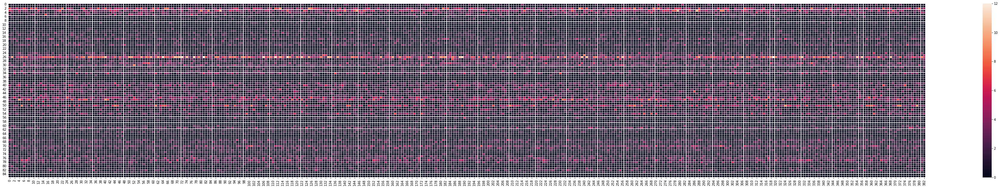

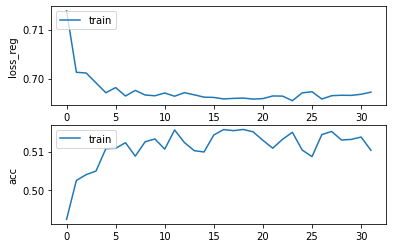

Epochs :  31 Iterations :  12256 Loss :  0.6972475305549781 ACC :  0.5103363702098009 MCC :  0.02164818216467826 Precision :  0.520342953425319
mode : validation


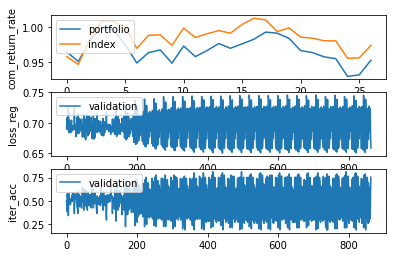

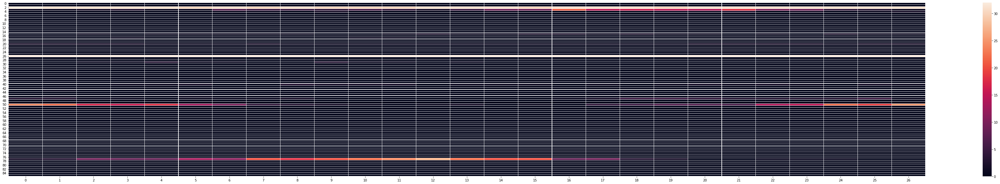

Epochs :  31 Iterations :  27 Loss :  0.6947984298070272 ACC :  0.4997821483347151 MCC :  nan Precision :  0.49379699352990697


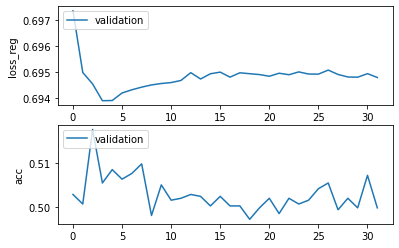

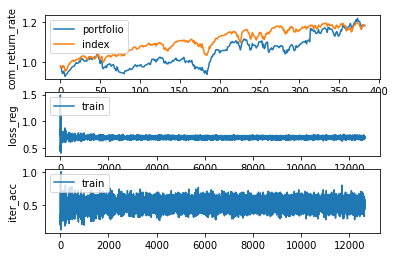

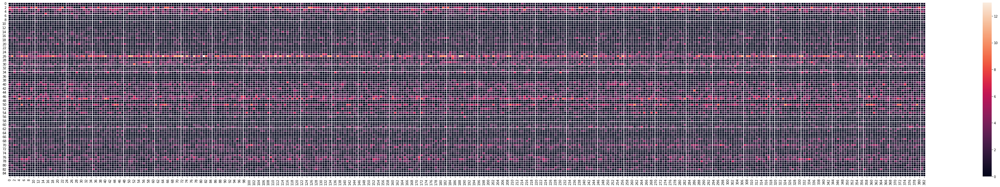

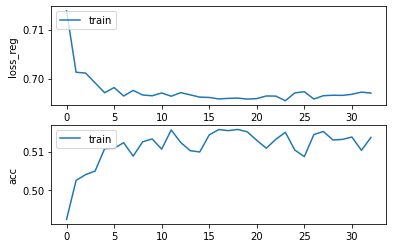

Epochs :  32 Iterations :  12639 Loss :  0.6970489750331749 ACC :  0.5136845500911185 MCC :  0.02401112911246435 Precision :  0.520057284742516
mode : validation


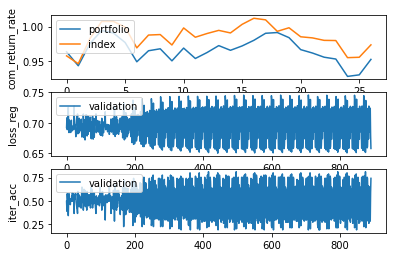

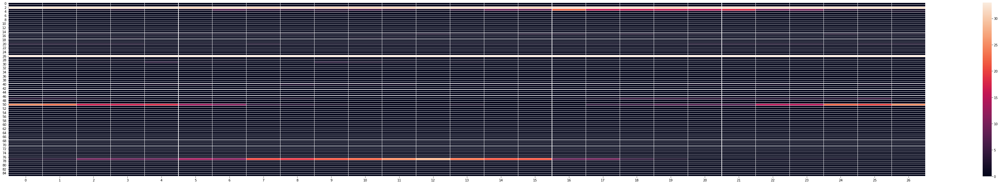

Epochs :  32 Iterations :  27 Loss :  0.6949222992967676 ACC :  0.5028322570853763 MCC :  nan Precision :  0.49356473823664365


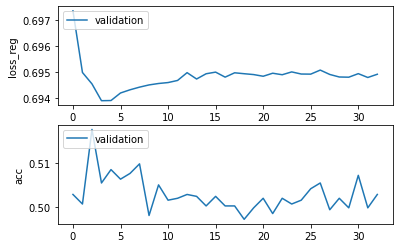

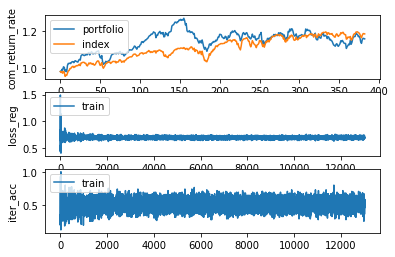

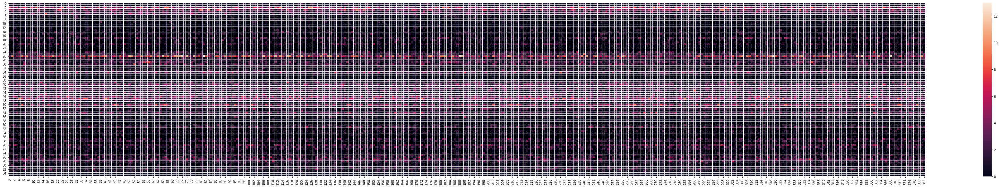

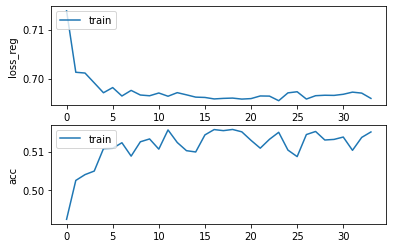

Epochs :  33 Iterations :  13022 Loss :  0.6959665458133887 ACC :  0.515097544025192 MCC :  0.02346668499655652 Precision :  0.5209042373412427
mode : validation


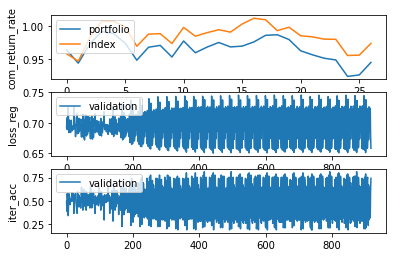

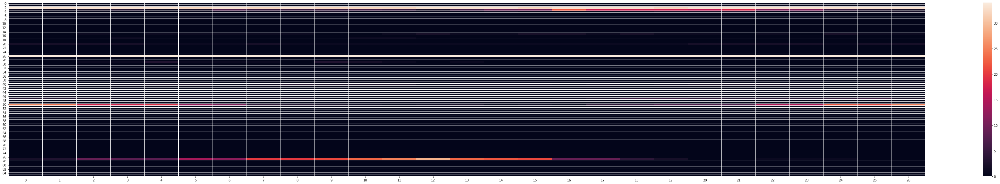

Epochs :  33 Iterations :  27 Loss :  0.6951163918883713 ACC :  0.4993464179612972 MCC :  nan Precision :  0.4926028864251243


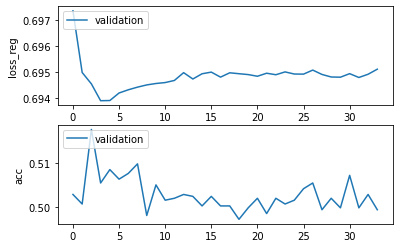

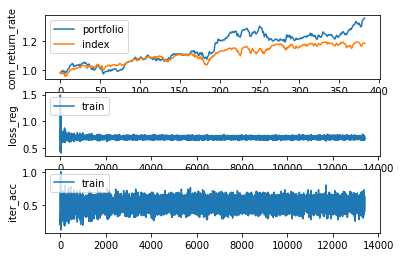

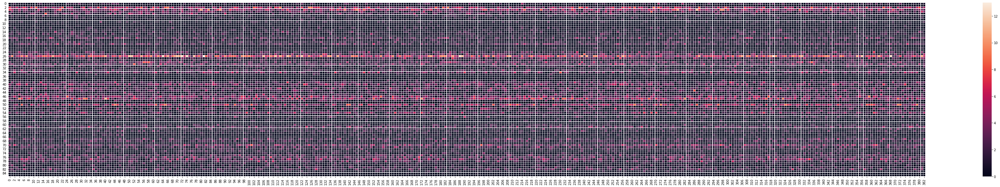

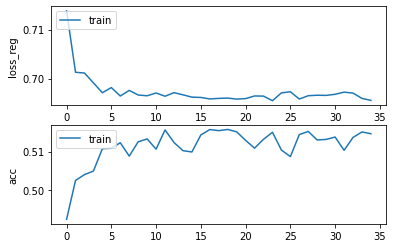

Epochs :  34 Iterations :  13405 Loss :  0.6955650383436337 ACC :  0.514636785025385 MCC :  0.026023001228909035 Precision :  0.5209756608196479
mode : validation


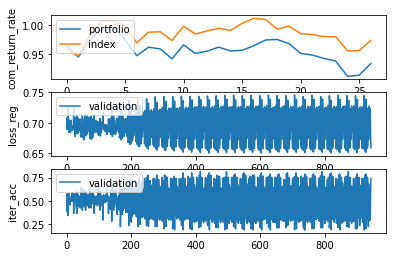

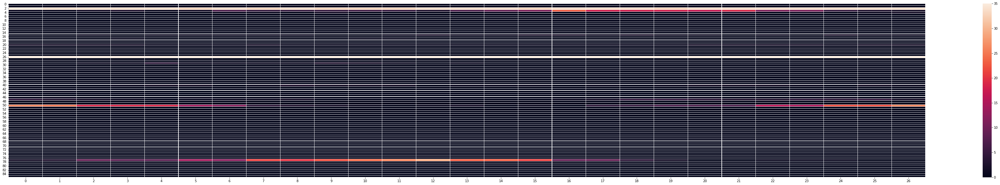

Epochs :  34 Iterations :  27 Loss :  0.6950061056349013 ACC :  0.49934641851319206 MCC :  nan Precision :  0.494564615259016


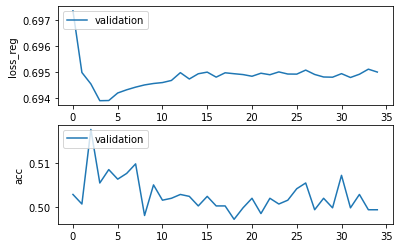

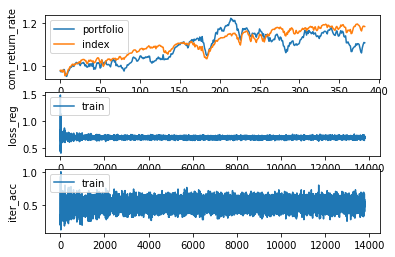

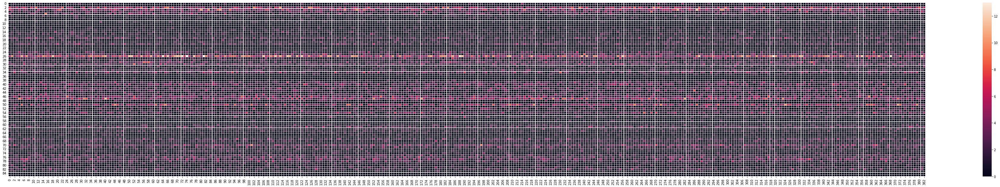

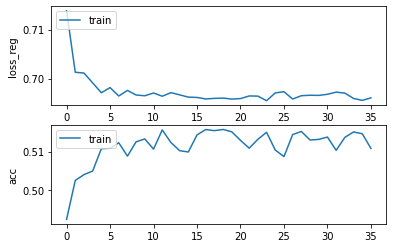

Epochs :  35 Iterations :  13788 Loss :  0.6960762158697641 ACC :  0.5108278464555118 MCC :  0.023284625615219417 Precision :  0.5197306549998472
mode : validation


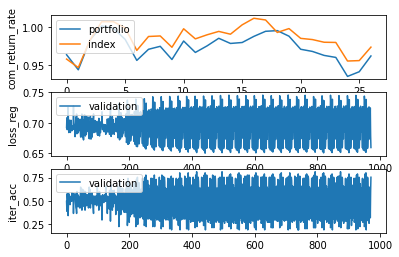

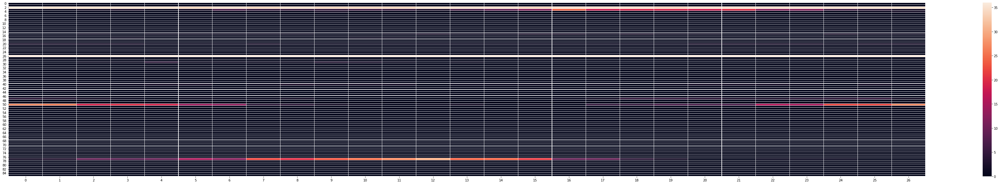

Epochs :  35 Iterations :  27 Loss :  0.6948620058872081 ACC :  0.5006536079777612 MCC :  nan Precision :  0.49195489721993607


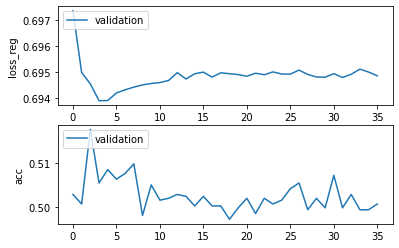

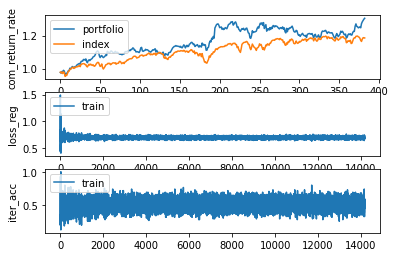

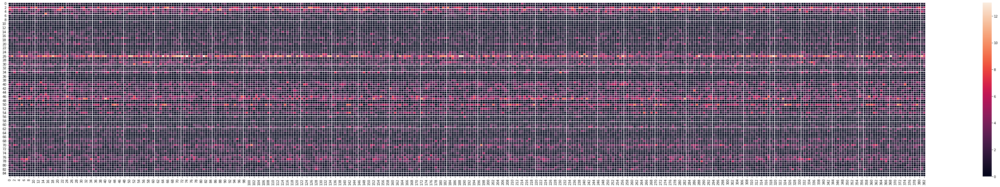

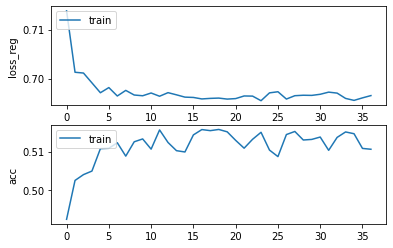

Epochs :  36 Iterations :  14171 Loss :  0.6965430324444883 ACC :  0.5106128250338702 MCC :  0.02058059866336483 Precision :  0.5193031045800323
mode : validation


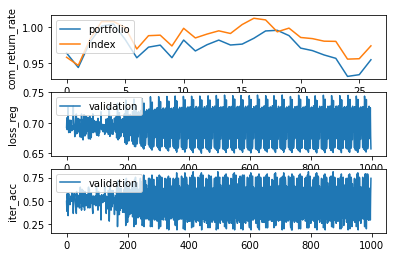

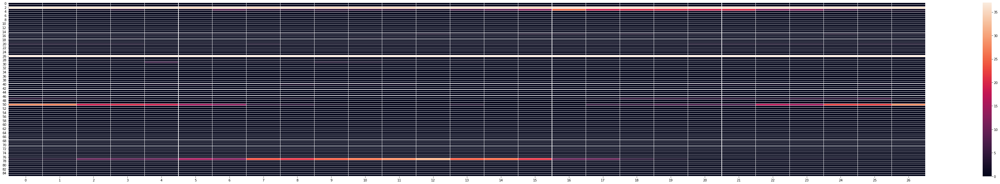

Epochs :  36 Iterations :  27 Loss :  0.6950094942693357 ACC :  0.5041394465499454 MCC :  nan Precision :  0.4934870570346161


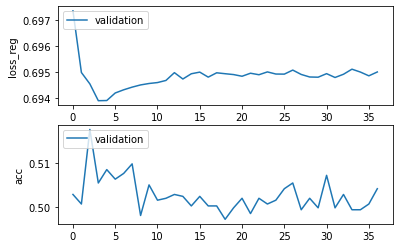

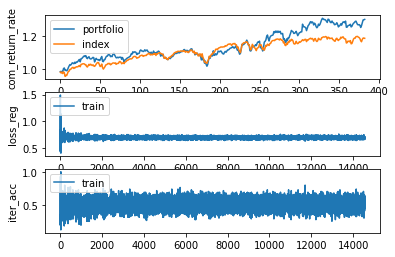

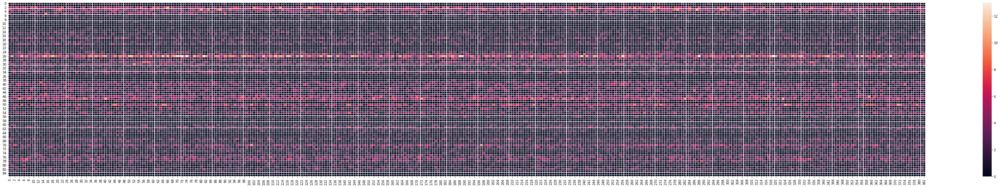

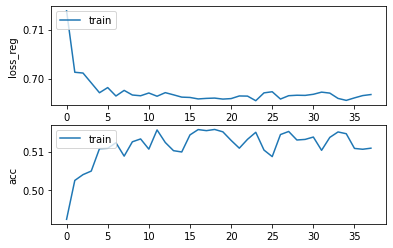

Epochs :  37 Iterations :  14554 Loss :  0.6967574614768862 ACC :  0.5108892798579393 MCC :  0.019368449596240726 Precision :  0.518759980243351
mode : validation


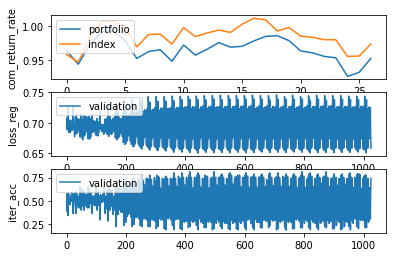

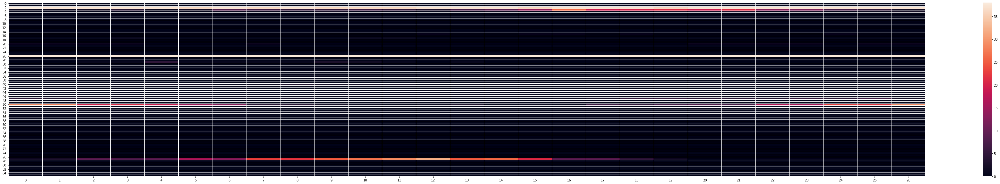

Epochs :  37 Iterations :  27 Loss :  0.6950942653196829 ACC :  0.5015250676208072 MCC :  nan Precision :  0.4935607794948198


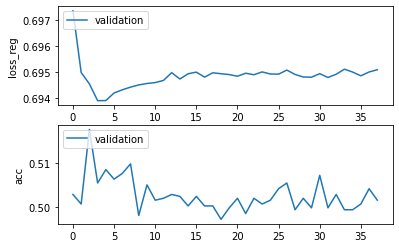

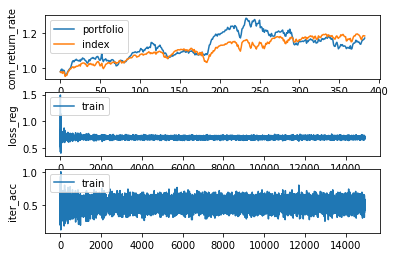

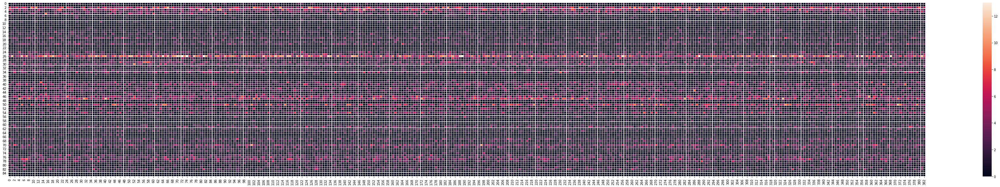

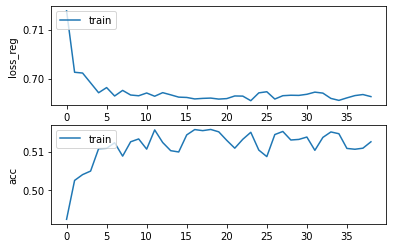

Epochs :  38 Iterations :  14937 Loss :  0.6963358807812783 ACC :  0.5125480109033012 MCC :  0.021847781892099925 Precision :  0.5192076228996715
mode : validation


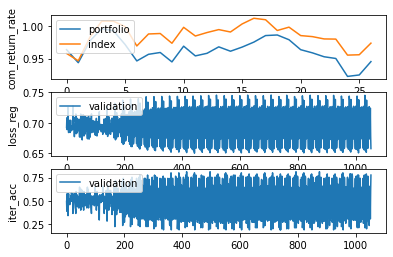

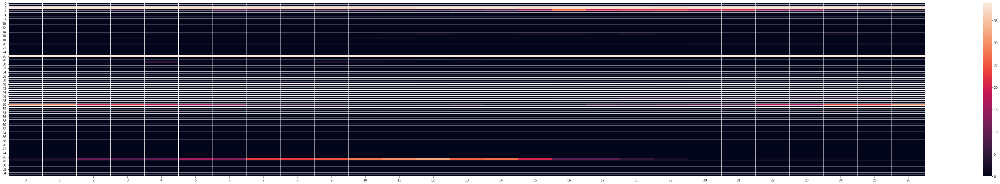

Epochs :  38 Iterations :  27 Loss :  0.6948297973032351 ACC :  0.5010893372473894 MCC :  nan Precision :  0.49307297232250374


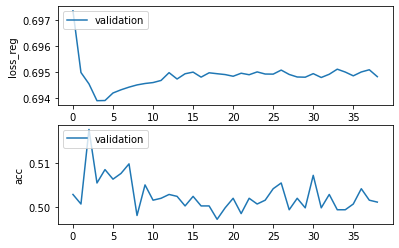

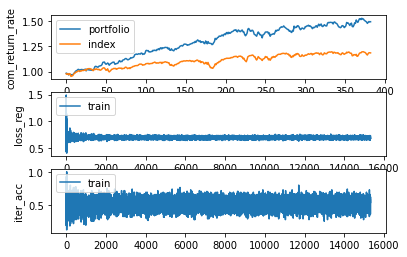

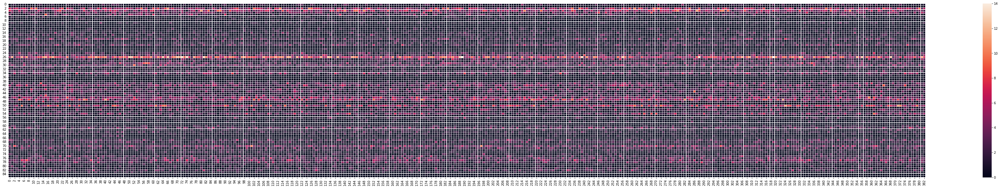

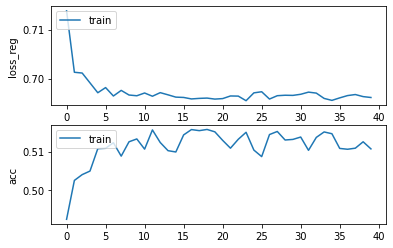

Epochs :  39 Iterations :  15320 Loss :  0.6961532353421104 ACC :  0.5107049768493941 MCC :  0.020235329616405118 Precision :  0.5190257721680263
mode : validation


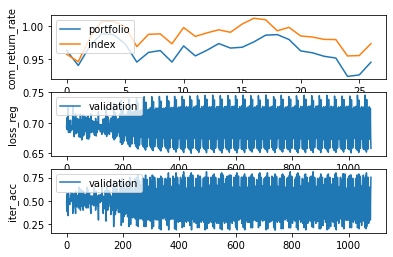

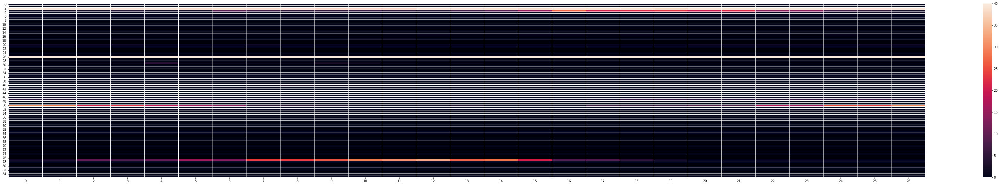

Epochs :  39 Iterations :  27 Loss :  0.6949531789179202 ACC :  0.5037037167284224 MCC :  nan Precision :  0.4941908525371993


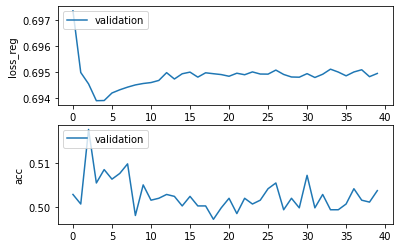

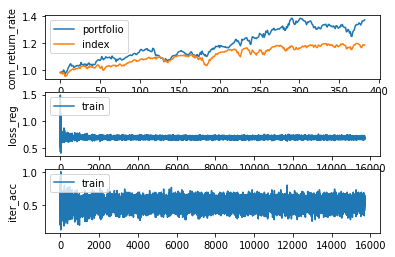

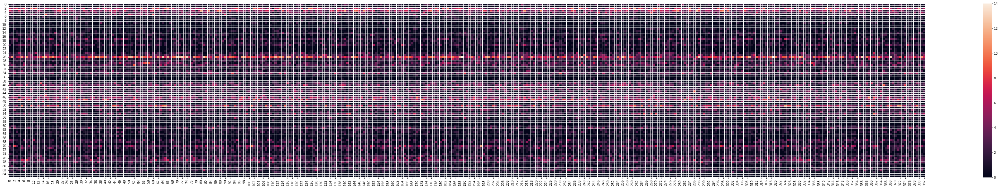

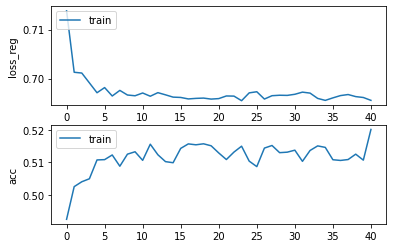

Epochs :  40 Iterations :  15703 Loss :  0.6955701413104802 ACC :  0.5201658895214918 MCC :  0.038206802209955947 Precision :  0.5253809482666516
mode : validation


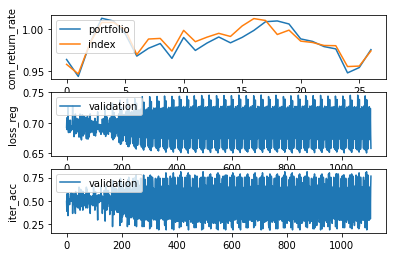

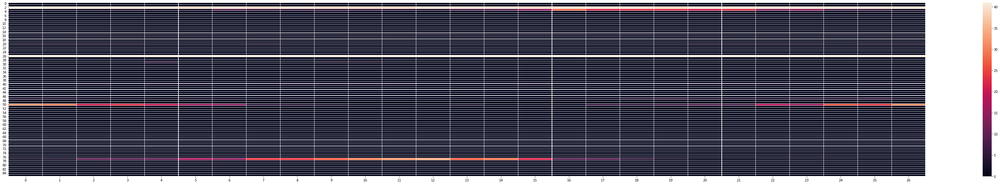

Epochs :  40 Iterations :  27 Loss :  0.6948694145237958 ACC :  0.5058823658360375 MCC :  nan Precision :  0.4940361164648224


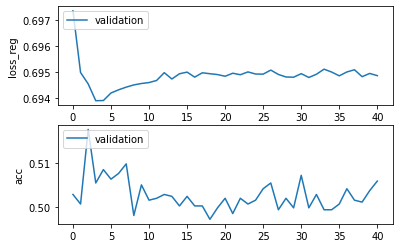

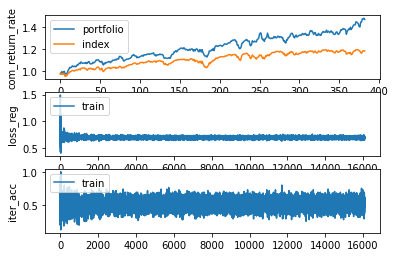

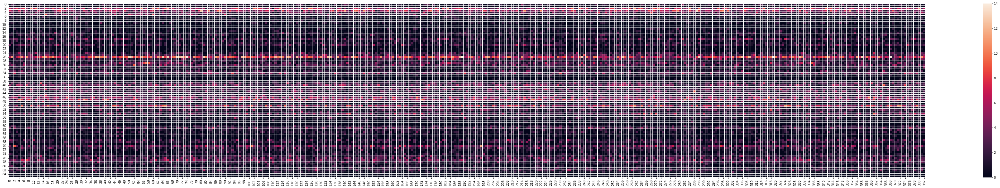

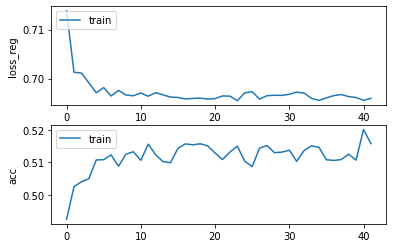

Epochs :  41 Iterations :  16086 Loss :  0.6959804603076168 ACC :  0.5158040407587903 MCC :  0.031918072027419316 Precision :  0.5236574366309391
mode : validation


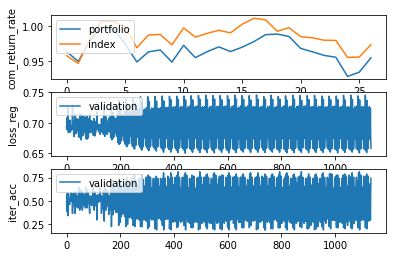

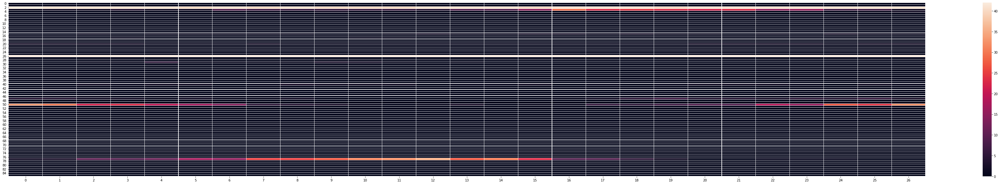

Epochs :  41 Iterations :  27 Loss :  0.6947446487568043 ACC :  0.5002178781562381 MCC :  nan Precision :  0.4921004198905494


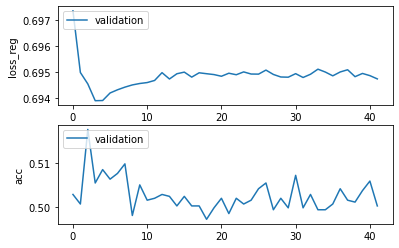

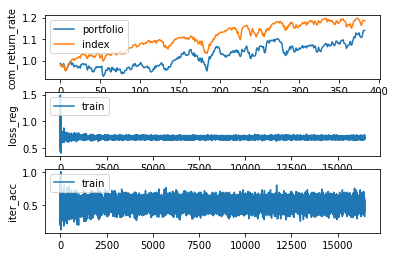

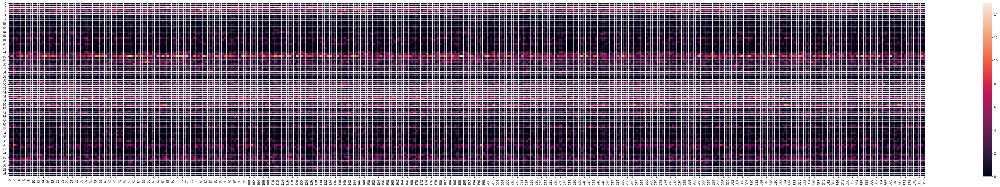

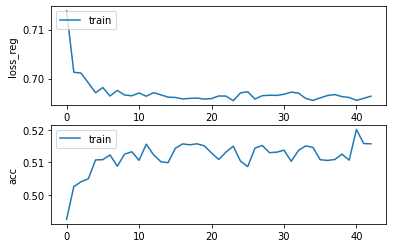

Epochs :  42 Iterations :  16469 Loss :  0.6964182547116092 ACC :  0.5157426060335443 MCC :  0.031397811407053125 Precision :  0.5230710254276935
mode : validation


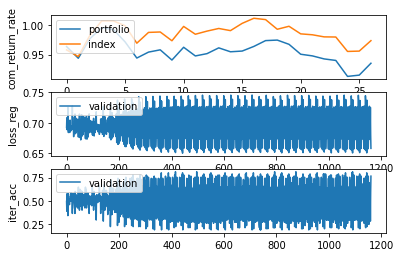

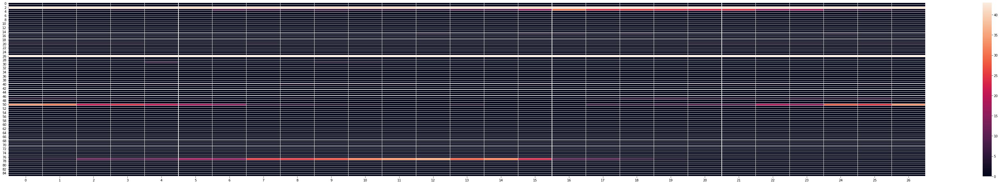

Epochs :  42 Iterations :  27 Loss :  0.6951450109481812 ACC :  0.496732039032159 MCC :  nan Precision :  0.49019412558387826


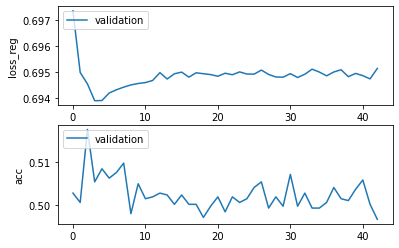

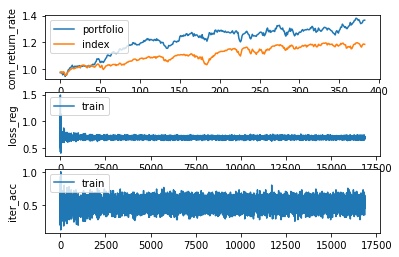

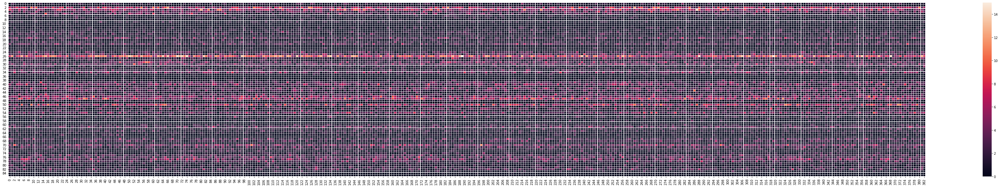

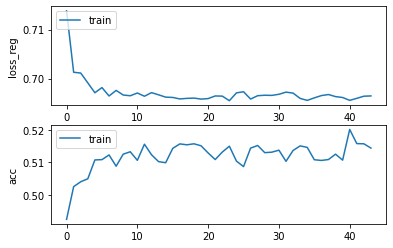

Epochs :  43 Iterations :  16852 Loss :  0.6964728908501469 ACC :  0.5144217636815561 MCC :  0.021930556713181545 Precision :  0.5193983388592929
mode : validation


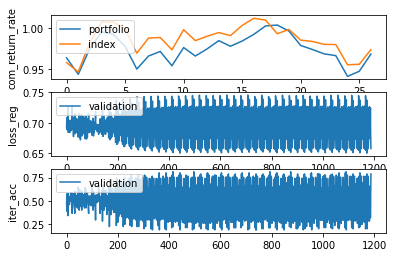

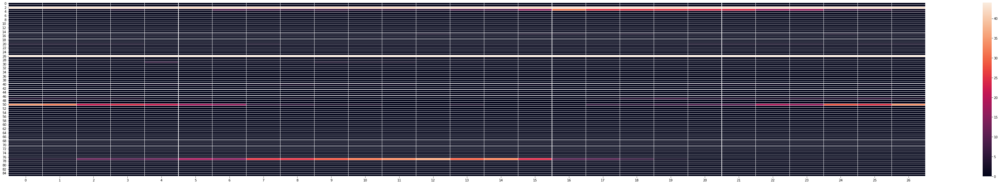

Epochs :  43 Iterations :  27 Loss :  0.6947182328612717 ACC :  0.5019607974423302 MCC :  nan Precision :  0.49177813516170893


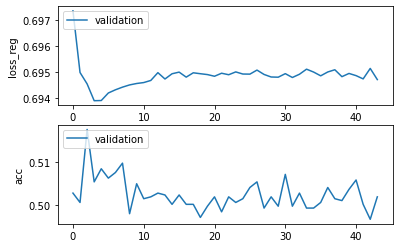

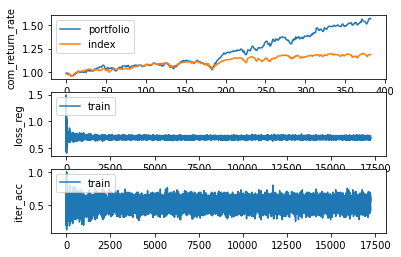

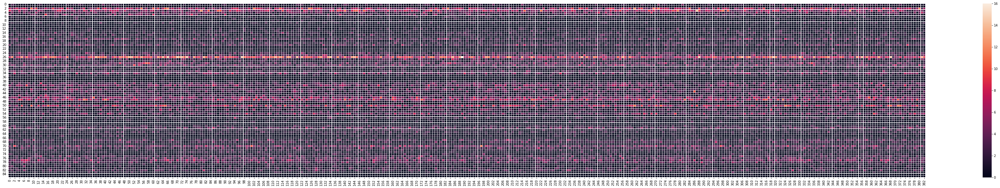

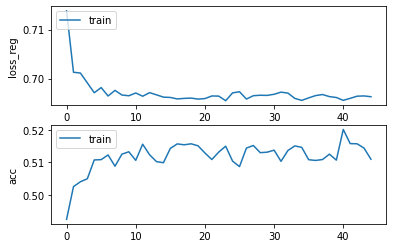

Epochs :  44 Iterations :  17235 Loss :  0.6963132263474925 ACC :  0.510981431829089 MCC :  0.01930863147099349 Precision :  0.5189743329753842
mode : validation


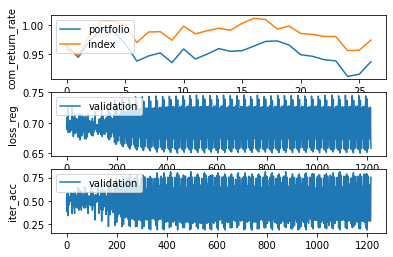

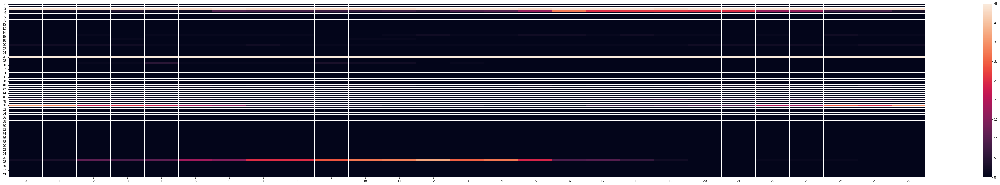

Epochs :  44 Iterations :  27 Loss :  0.6949356970963655 ACC :  0.5023965272638533 MCC :  nan Precision :  0.49289001427866797


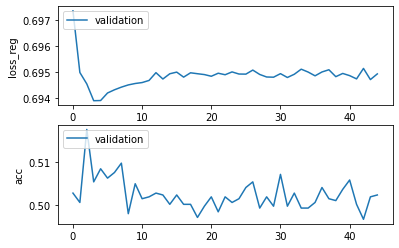

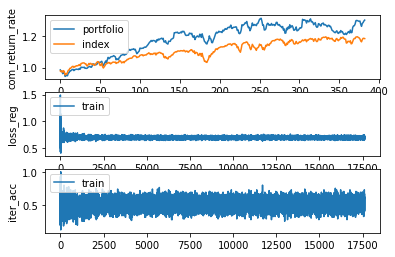

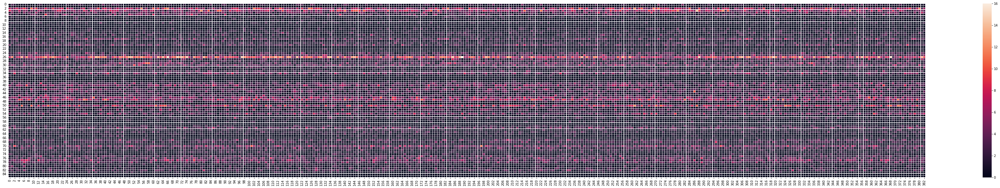

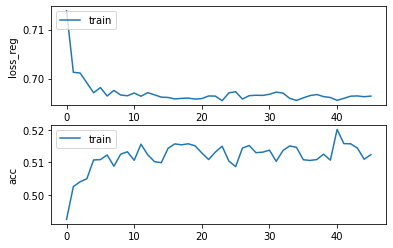

Epochs :  45 Iterations :  17618 Loss :  0.6964437132093365 ACC :  0.5123944258409754 MCC :  0.01907940597581013 Precision :  0.51878002123523
mode : validation


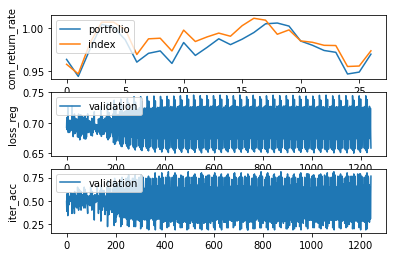

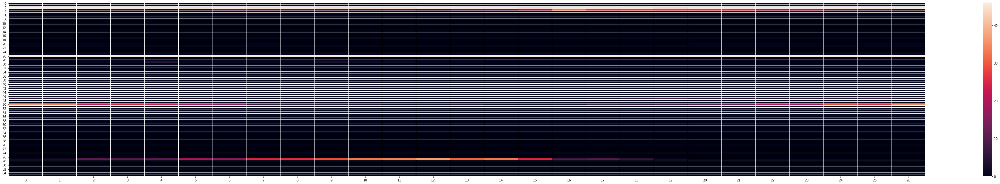

Epochs :  45 Iterations :  27 Loss :  0.695010002012606 ACC :  0.5002178781562381 MCC :  nan Precision :  0.4915448240245934


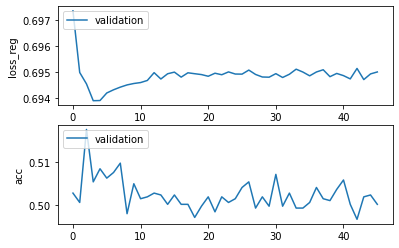

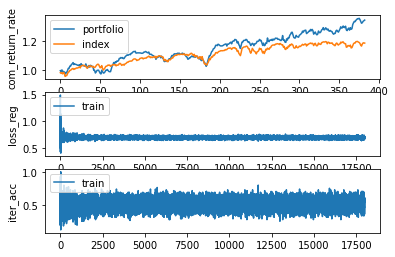

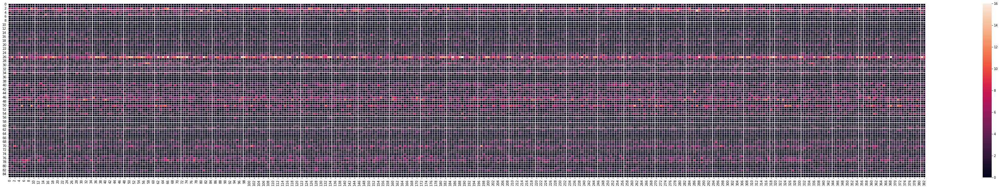

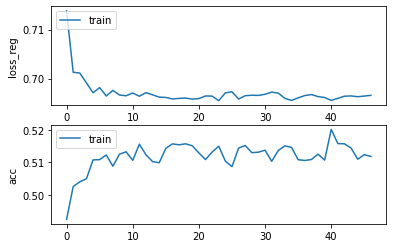

Epochs :  46 Iterations :  18001 Loss :  0.6965925449179607 ACC :  0.5118415151034572 MCC :  0.019439294504174386 Precision :  0.5183481409338451
mode : validation


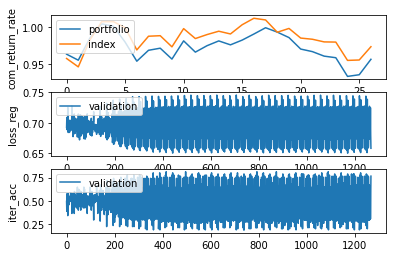

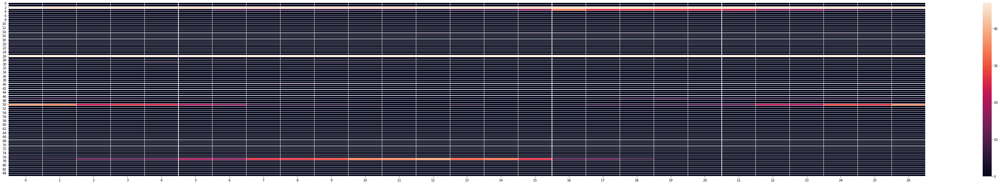

Epochs :  46 Iterations :  27 Loss :  0.6950001230946293 ACC :  0.5010893377992842 MCC :  nan Precision :  0.49229835546403017


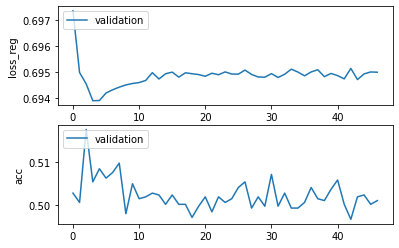

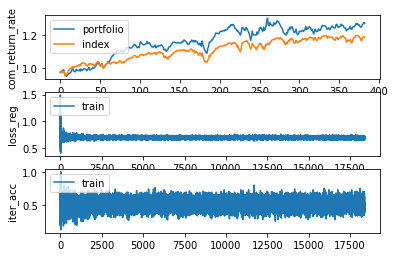

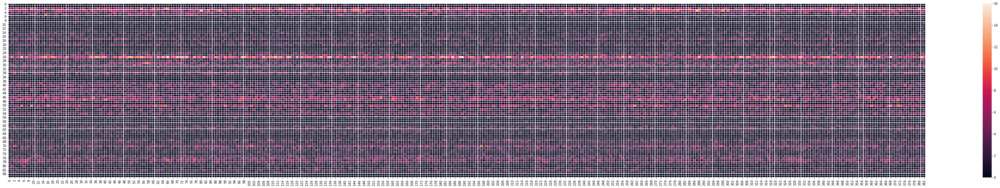

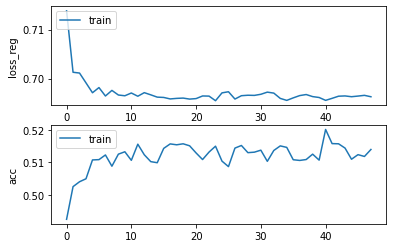

Epochs :  47 Iterations :  18384 Loss :  0.6963060881076842 ACC :  0.5139917227835942 MCC :  0.024713603107929815 Precision :  0.5208866282830662
mode : validation


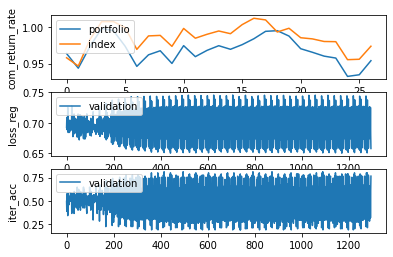

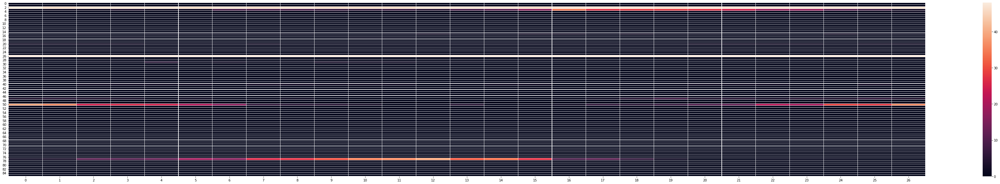

Epochs :  47 Iterations :  27 Loss :  0.6949107448259989 ACC :  0.5098039342297448 MCC :  nan Precision :  0.49419023538077317


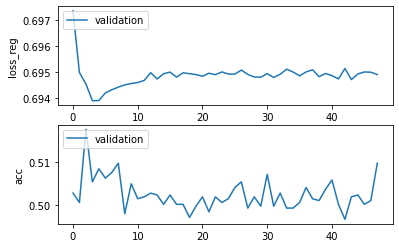

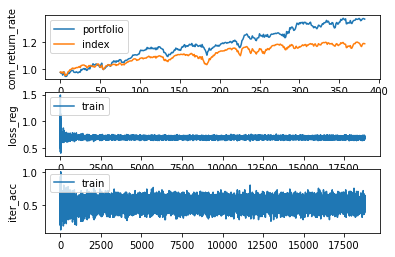

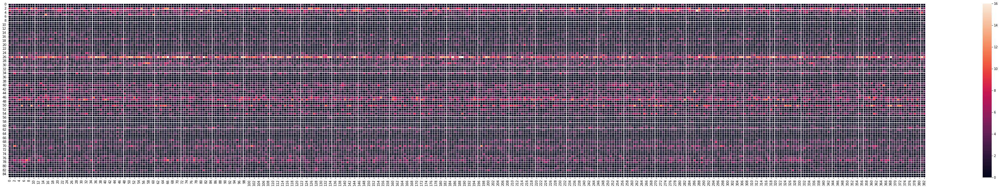

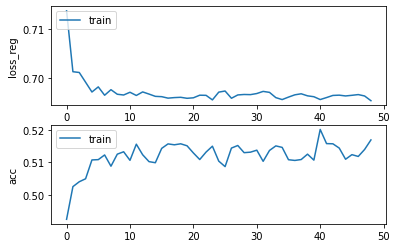

Epochs :  48 Iterations :  18767 Loss :  0.6953326862101143 ACC :  0.5169405787794148 MCC :  0.02991399965835638 Precision :  0.5219000165323987
mode : validation


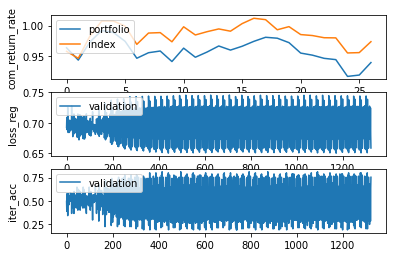

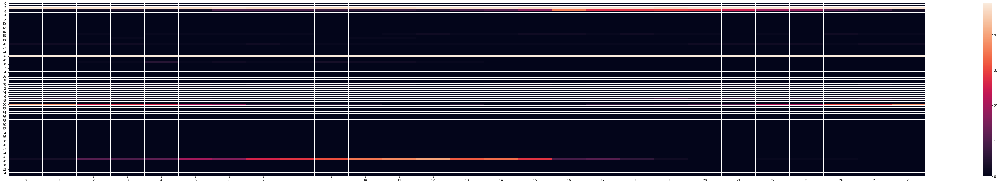

Epochs :  48 Iterations :  27 Loss :  0.6950246890385946 ACC :  0.5002178776043432 MCC :  nan Precision :  0.49230350864430267


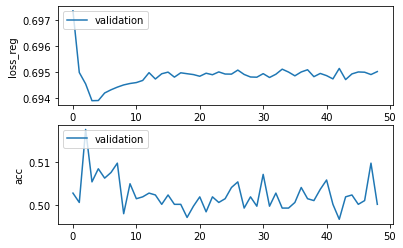

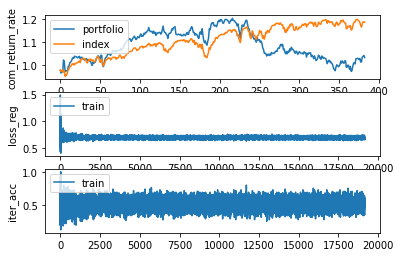

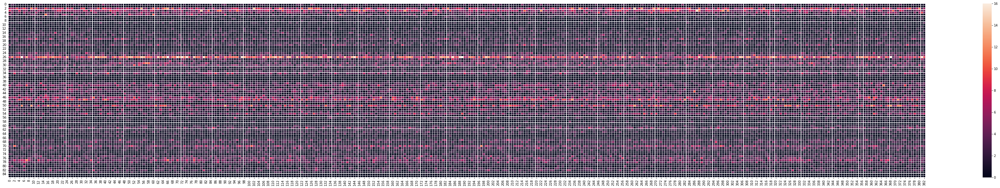

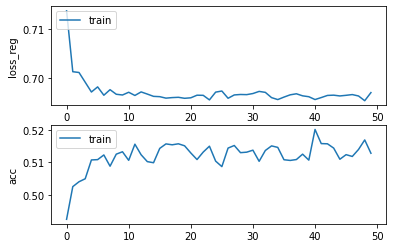

Epochs :  49 Iterations :  19150 Loss :  0.6970012086801056 ACC :  0.5128244669723759 MCC :  0.02240769810869429 Precision :  0.5202663957576605
mode : validation


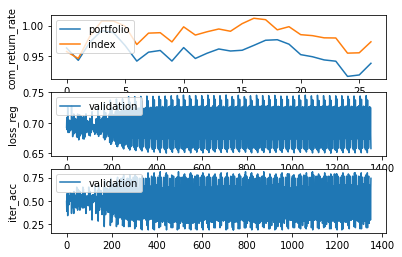

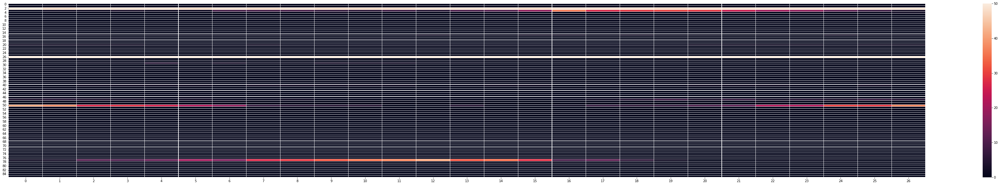

Epochs :  49 Iterations :  27 Loss :  0.6950098231986717 ACC :  0.5041394465499454 MCC :  nan Precision :  0.49251685774436704


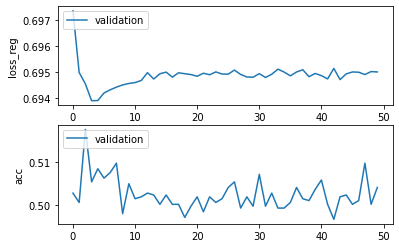

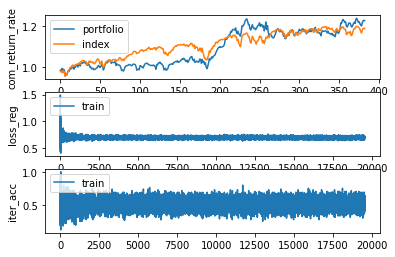

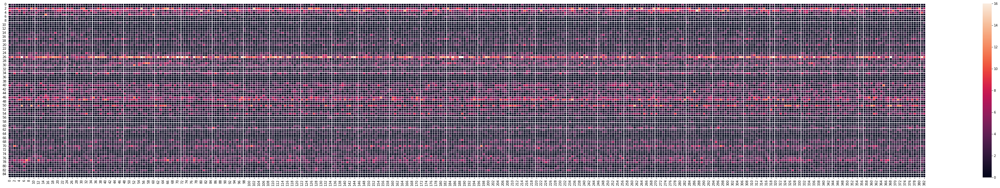

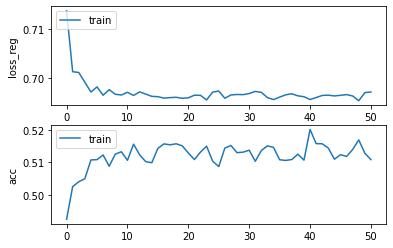

Epochs :  50 Iterations :  19533 Loss :  0.6971302936656045 ACC :  0.5108585633123512 MCC :  0.022275607356030794 Precision :  0.5192516405310472
mode : validation


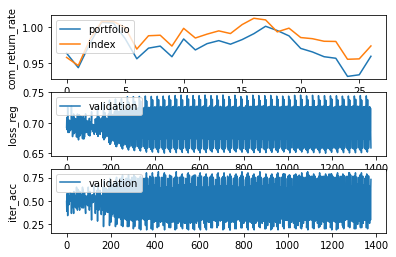

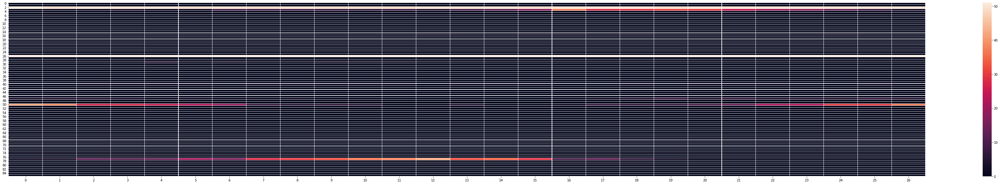

Epochs :  50 Iterations :  27 Loss :  0.6949782481899968 ACC :  0.5037037167284224 MCC :  nan Precision :  0.494936757893474


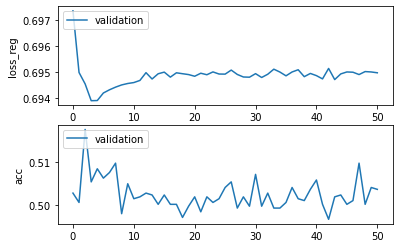

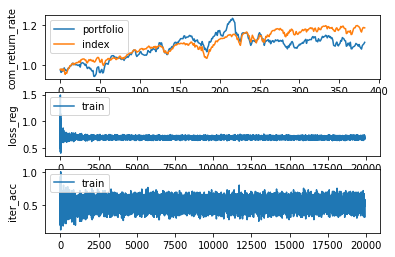

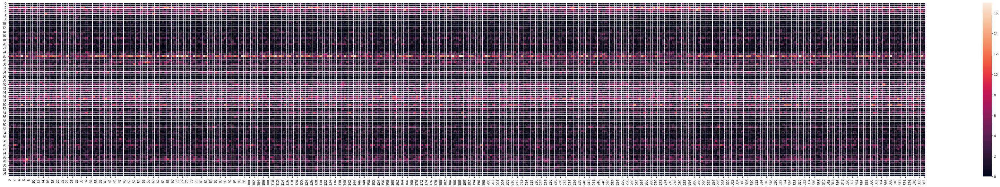

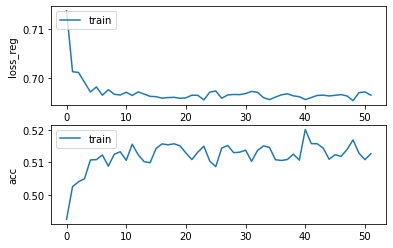

Epochs :  51 Iterations :  19916 Loss :  0.6964707670261592 ACC :  0.5126708810541089 MCC :  0.02106372997278406 Precision :  0.5190025754662002
mode : validation


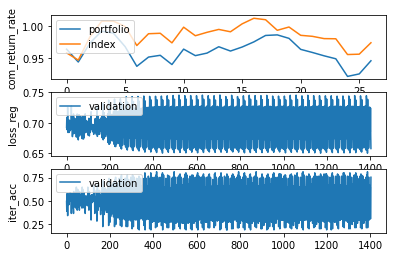

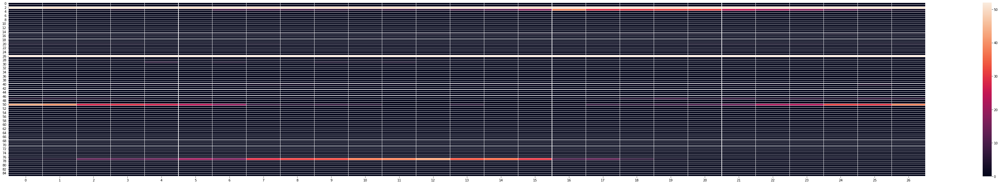

Epochs :  51 Iterations :  27 Loss :  0.6948995457755195 ACC :  0.5037037167284224 MCC :  nan Precision :  0.49259101606353567


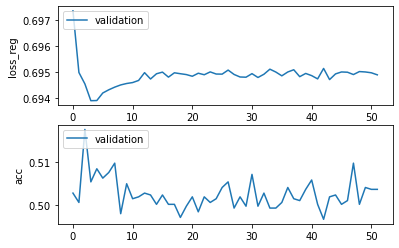

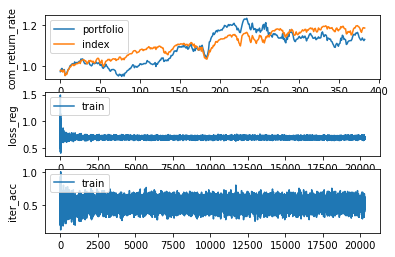

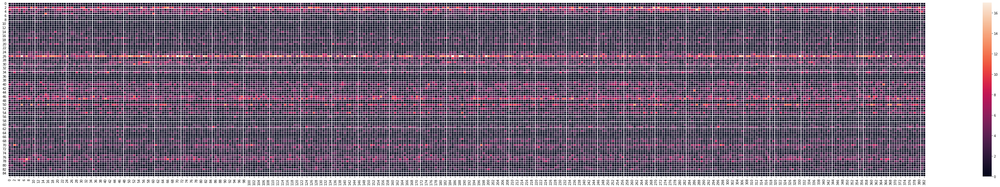

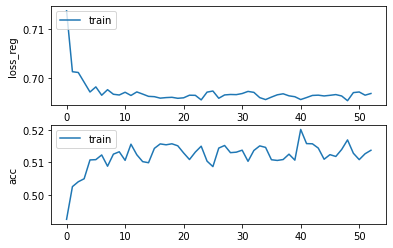

Epochs :  52 Iterations :  20299 Loss :  0.6968185481452444 ACC :  0.5137459842716745 MCC :  0.022867835795521426 Precision :  0.520295127083404
mode : validation


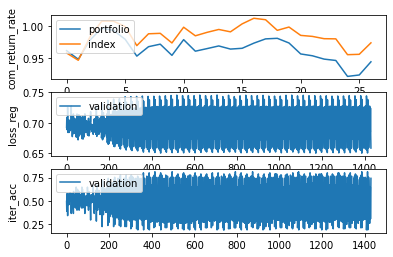

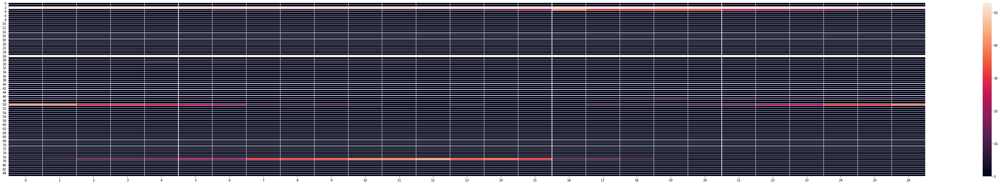

Epochs :  52 Iterations :  27 Loss :  0.6948583192295499 ACC :  0.5002178781562381 MCC :  nan Precision :  0.49250755866092666


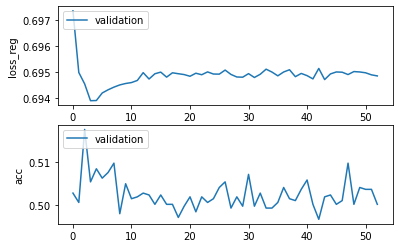

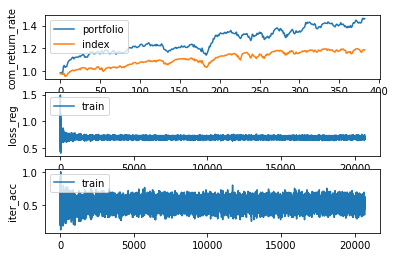

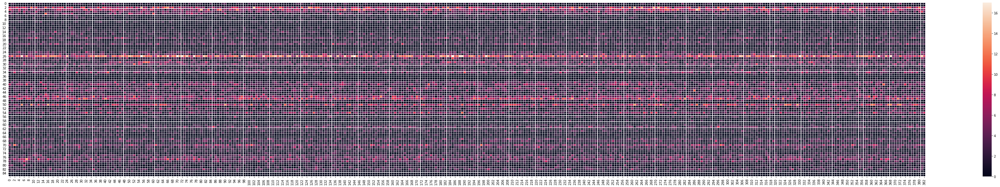

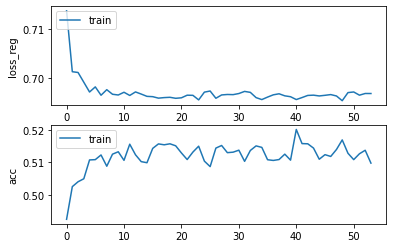

Epochs :  53 Iterations :  20682 Loss :  0.6968119275165289 ACC :  0.509783459316657 MCC :  0.017480039131990574 Precision :  0.5174878294781512
mode : validation


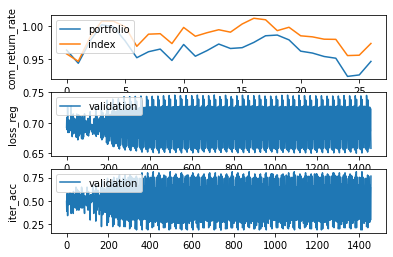

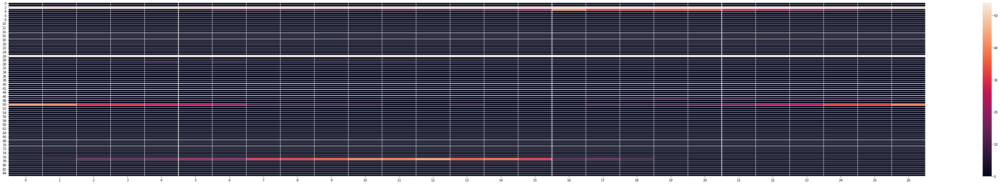

Epochs :  53 Iterations :  27 Loss :  0.6948523609726517 ACC :  0.49934641851319206 MCC :  nan Precision :  0.4930817182003348


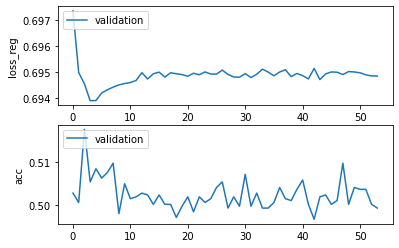

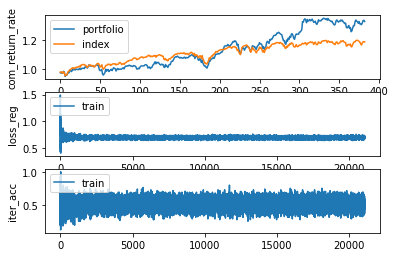

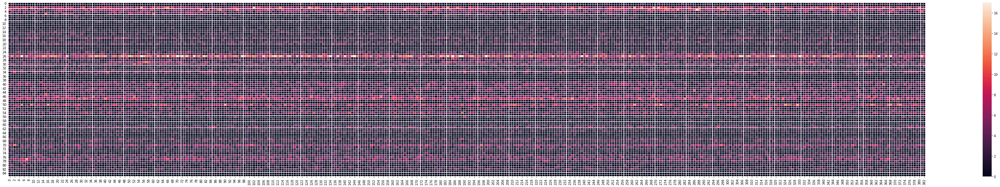

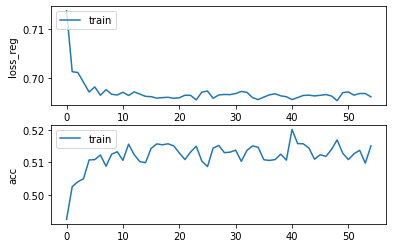

Epochs :  54 Iterations :  21065 Loss :  0.6961304630996664 ACC :  0.5150975442586306 MCC :  0.02778671283470029 Precision :  0.5213995880688062
mode : validation


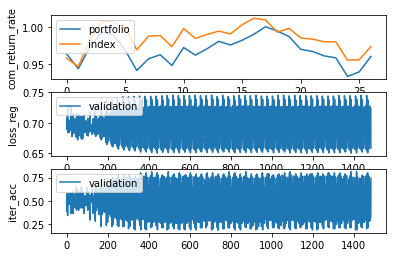

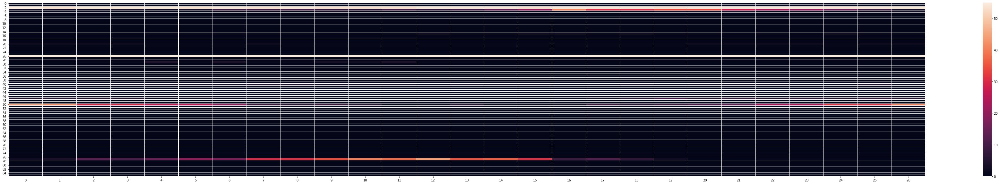

Epochs :  54 Iterations :  27 Loss :  0.6948429014947679 ACC :  0.5037037167284224 MCC :  nan Precision :  0.4918196701479179


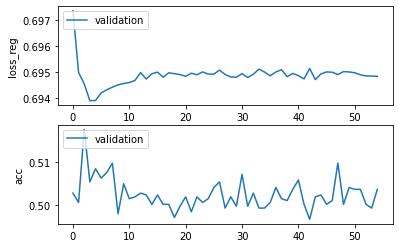

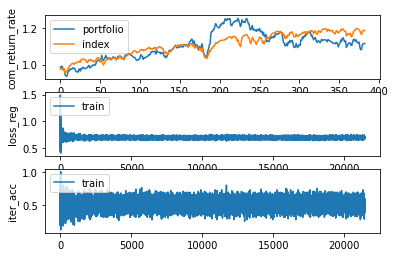

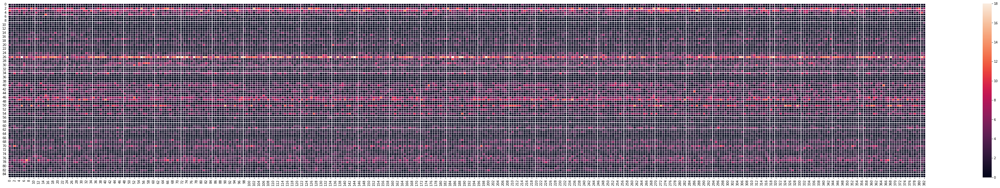

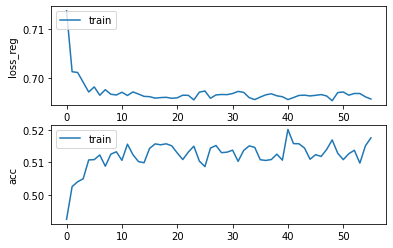

Epochs :  55 Iterations :  21448 Loss :  0.6956739078613859 ACC :  0.5175856416437085 MCC :  0.03199839198371571 Precision :  0.5236486508547482
mode : validation


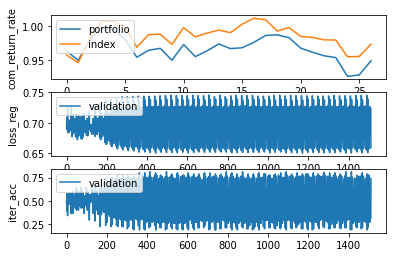

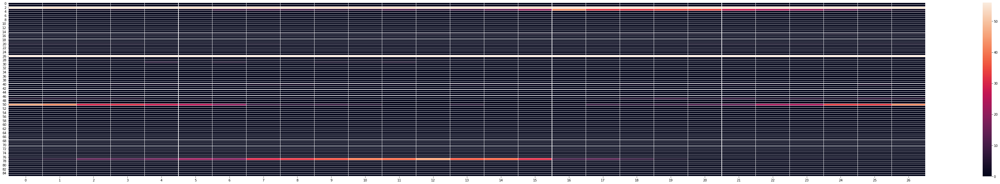

Epochs :  55 Iterations :  27 Loss :  0.6948909869900456 ACC :  0.5032679869068993 MCC :  nan Precision :  0.4943255069493144


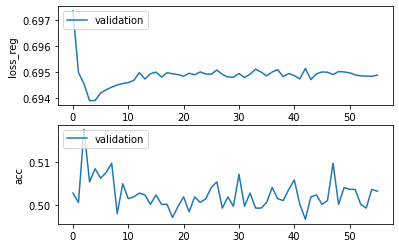

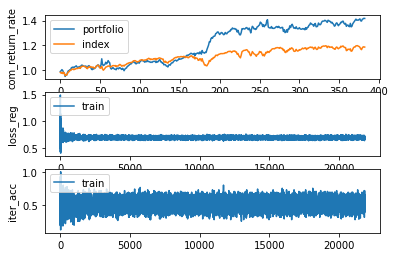

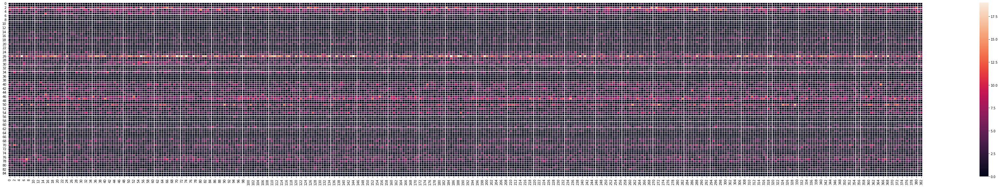

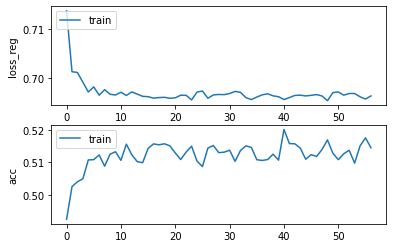

Epochs :  56 Iterations :  21831 Loss :  0.6963142635928121 ACC :  0.5145139152636415 MCC :  0.02445981545919703 Precision :  0.5204269368512746
mode : validation


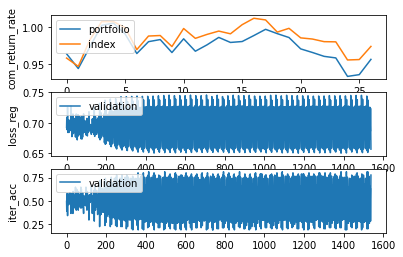

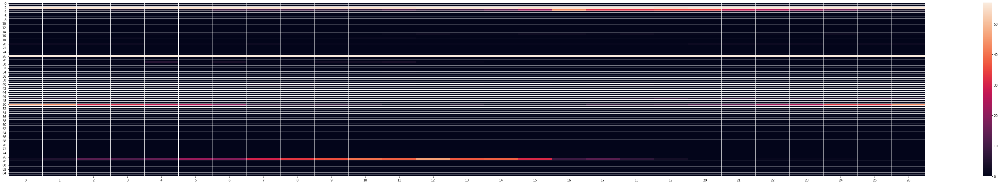

Epochs :  56 Iterations :  27 Loss :  0.6948232231316743 ACC :  0.5050109061929915 MCC :  nan Precision :  0.4943279266633369


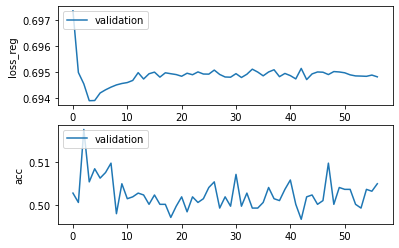

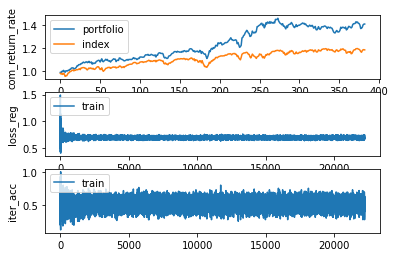

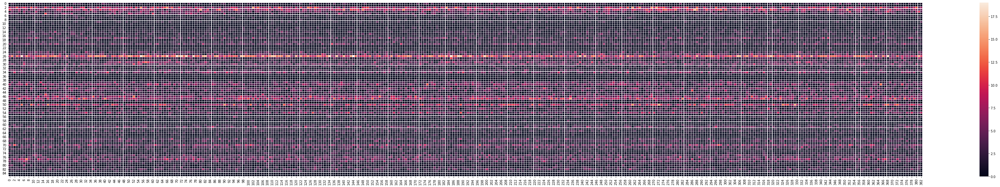

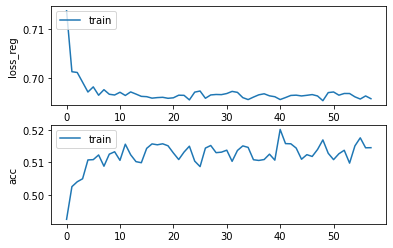

Epochs :  57 Iterations :  22214 Loss :  0.6957438745324357 ACC :  0.5145446334432995 MCC :  0.030701581857412782 Precision :  0.5232073499896508
mode : validation


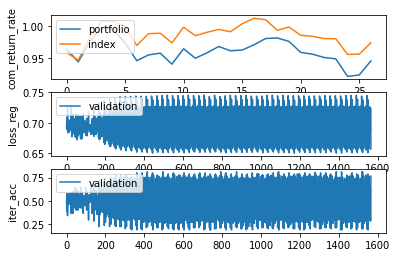

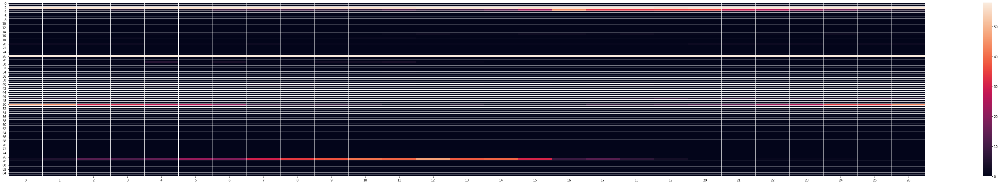

Epochs :  57 Iterations :  27 Loss :  0.6949259727089493 ACC :  0.5037037167284224 MCC :  nan Precision :  0.4943023303316699


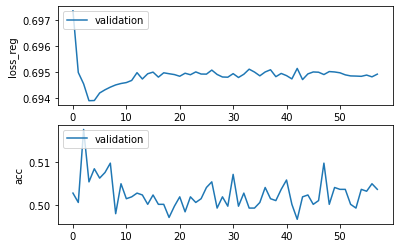

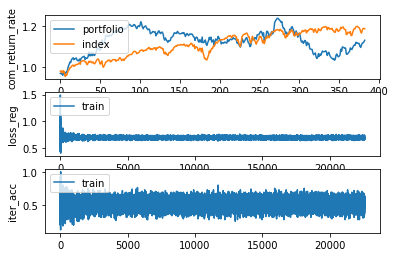

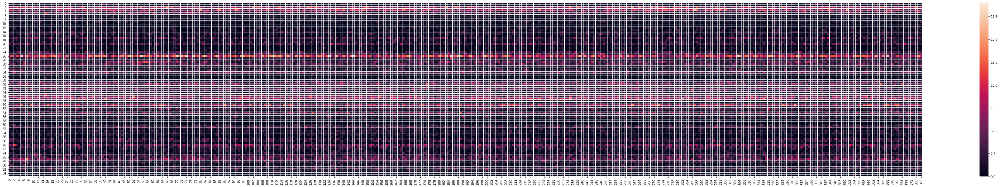

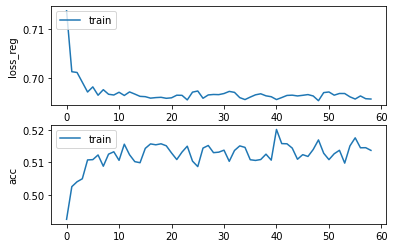

Epochs :  58 Iterations :  22597 Loss :  0.6956781475724502 ACC :  0.5137152672592094 MCC :  0.025266927374708016 Precision :  0.521622266707937
mode : validation


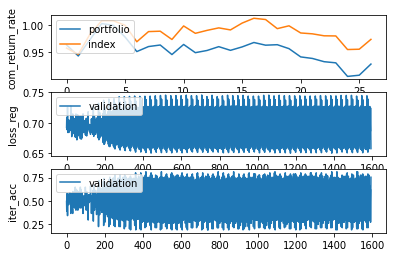

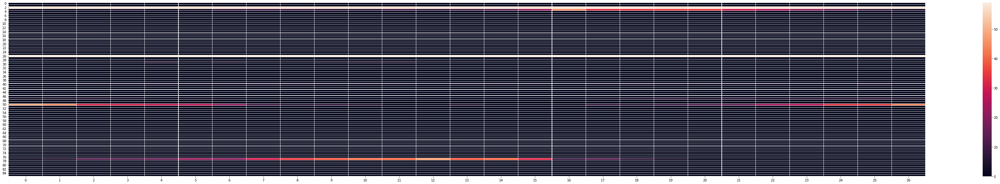

Epochs :  58 Iterations :  27 Loss :  0.6950867308510674 ACC :  0.5002178781562381 MCC :  nan Precision :  0.49142101420848455


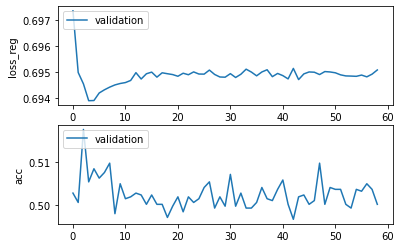

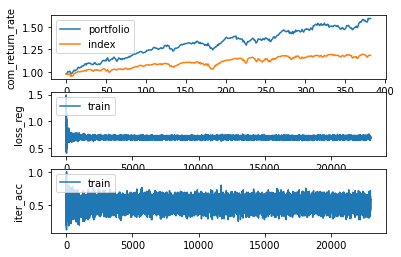

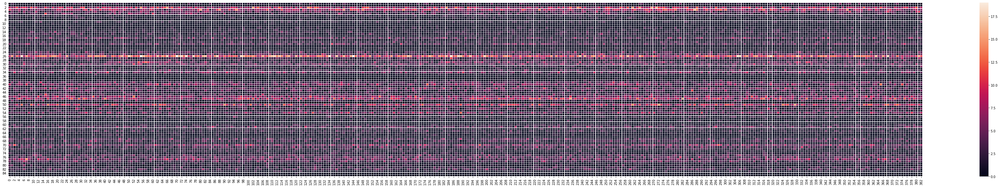

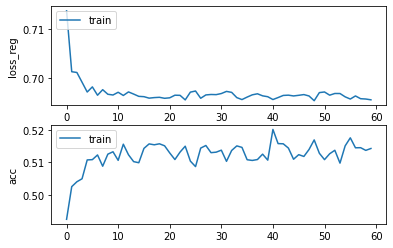

Epochs :  59 Iterations :  22980 Loss :  0.6955157347198566 ACC :  0.5142988957873212 MCC :  0.022159728293025056 Precision :  0.5201826879302376
mode : validation


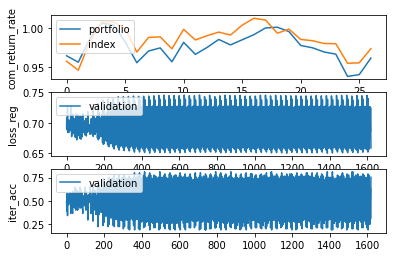

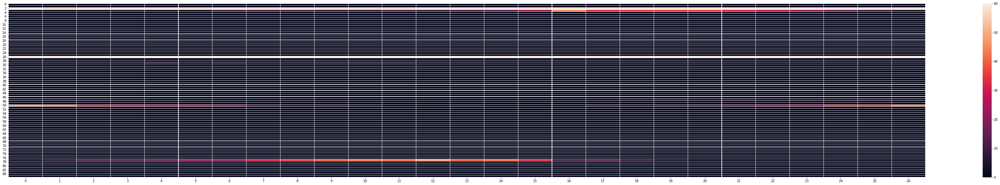

Epochs :  59 Iterations :  27 Loss :  0.6952018053443344 ACC :  0.49455338937264903 MCC :  nan Precision :  0.491575480128328


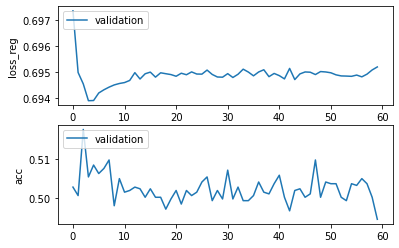

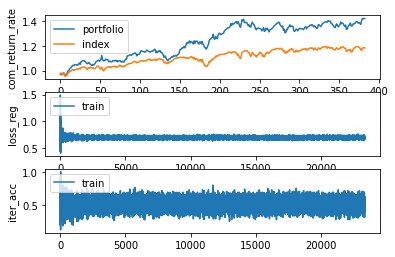

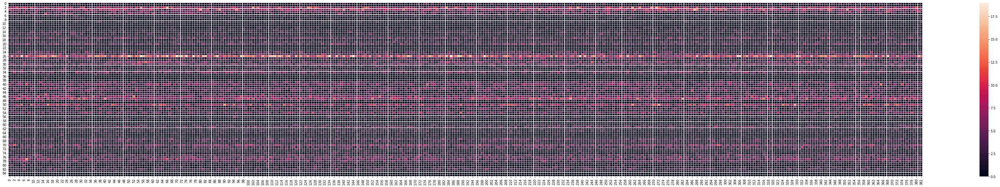

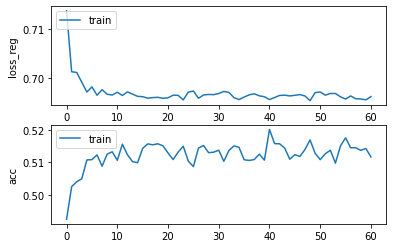

Epochs :  60 Iterations :  23363 Loss :  0.6961685450207783 ACC :  0.5116879284070615 MCC :  0.020736545457610465 Precision :  0.5196179637622195
mode : validation


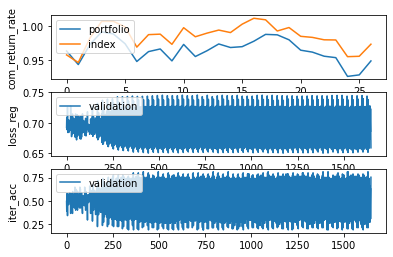

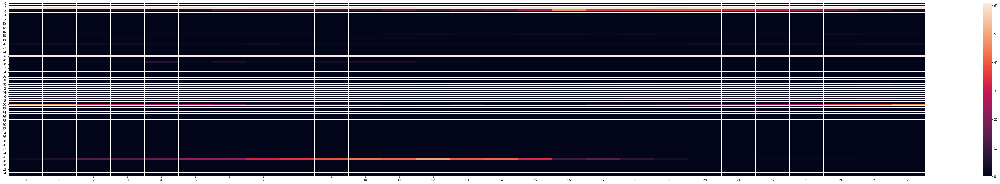

Epochs :  60 Iterations :  27 Loss :  0.6949779016000254 ACC :  0.49891068869166905 MCC :  nan Precision :  0.4916097007829834


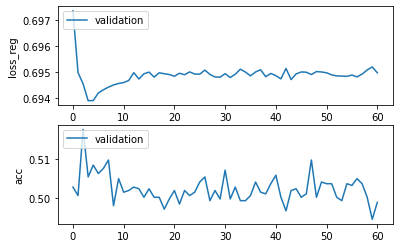

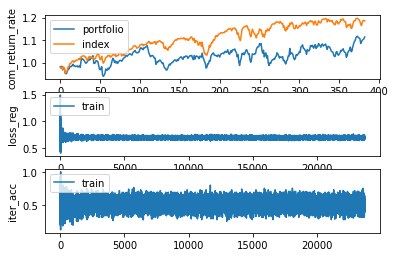

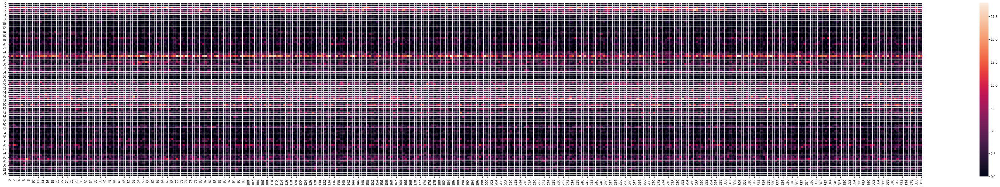

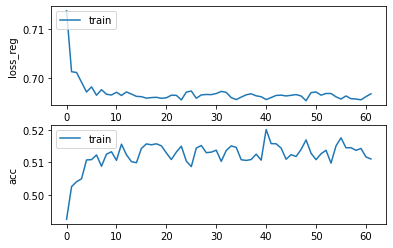

Epochs :  61 Iterations :  23746 Loss :  0.6967507115232104 ACC :  0.5110735844227415 MCC :  0.016436094332756303 Precision :  0.5181541187790838
mode : validation


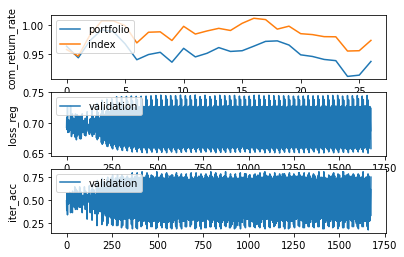

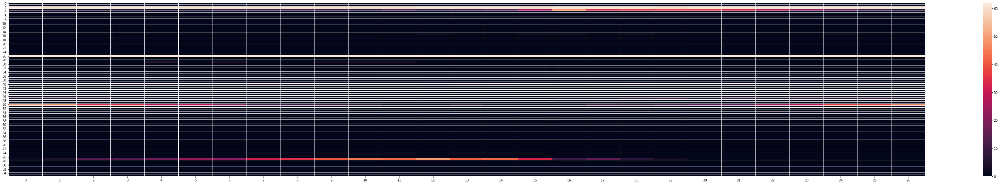

Epochs :  61 Iterations :  27 Loss :  0.6949423176270945 ACC :  0.49498912029796177 MCC :  nan Precision :  0.48950408102461584


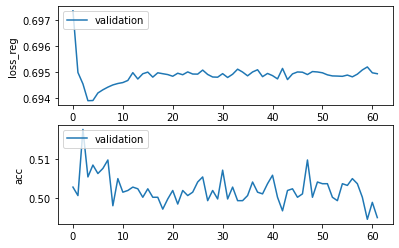

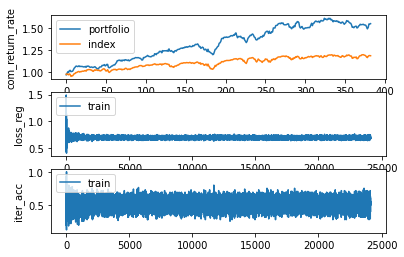

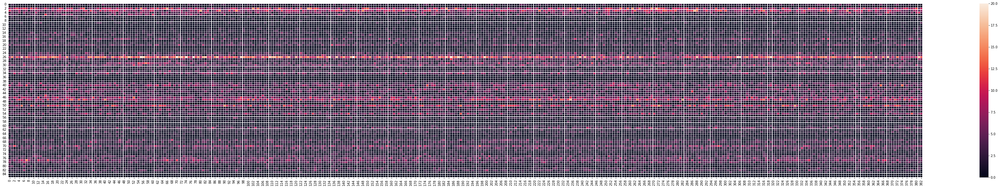

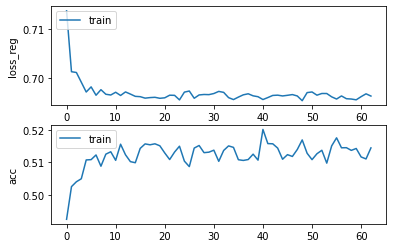

Epochs :  62 Iterations :  24129 Loss :  0.6962878192062477 ACC :  0.5144831991071178 MCC :  0.02948303150034974 Precision :  0.5222921468385595
mode : validation


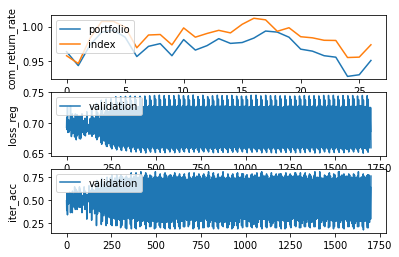

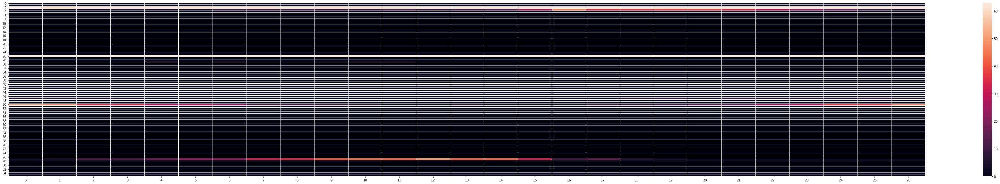

Epochs :  62 Iterations :  27 Loss :  0.6948905013225697 ACC :  0.5028322570853763 MCC :  nan Precision :  0.49268426966887935


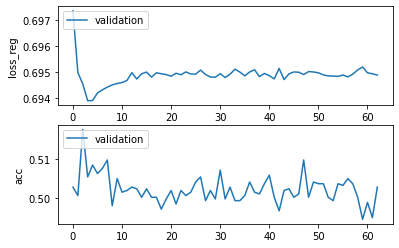

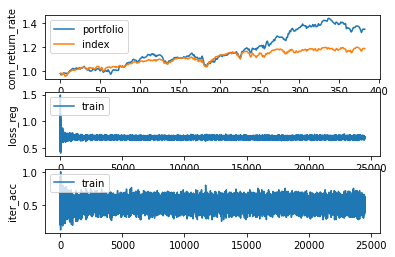

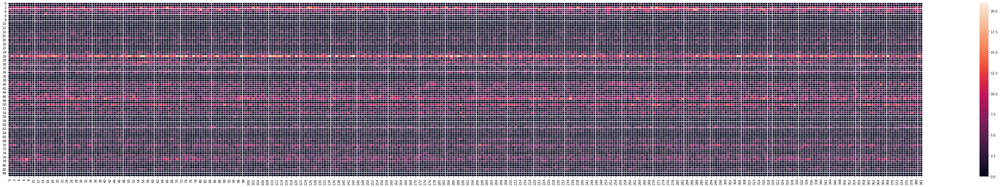

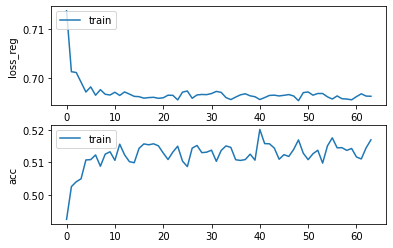

Epochs :  63 Iterations :  24512 Loss :  0.6962440401393502 ACC :  0.5169712961031314 MCC :  0.03025182574475549 Precision :  0.5227694027125835
mode : validation


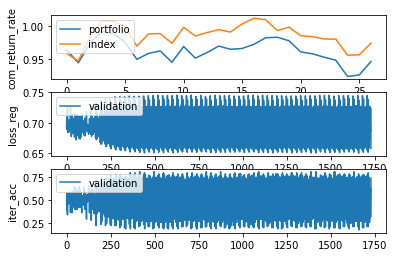

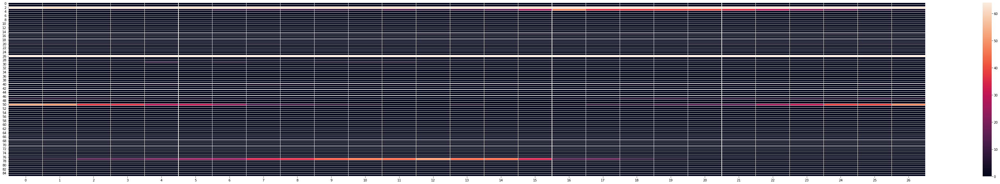

Epochs :  63 Iterations :  27 Loss :  0.6948831898194773 ACC :  0.5023965272638533 MCC :  nan Precision :  0.4916525243057145


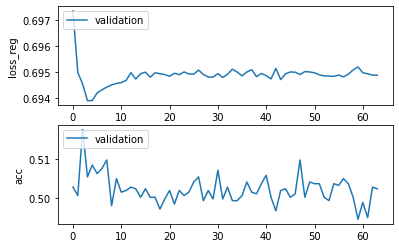

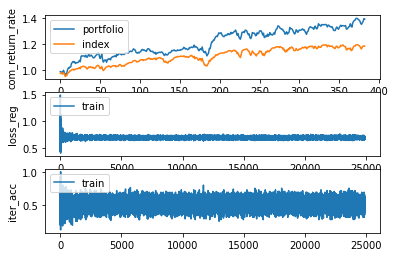

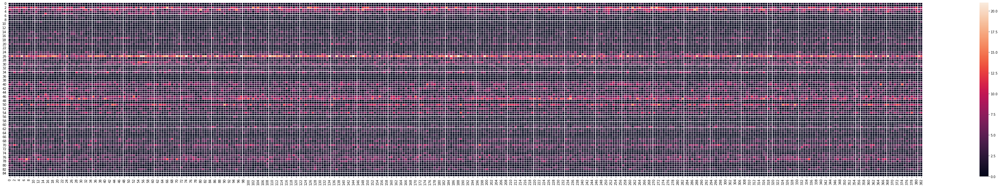

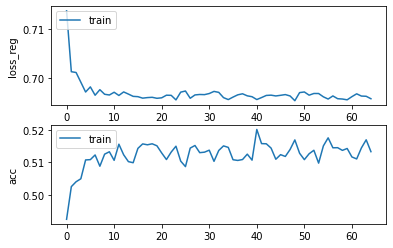

Epochs :  64 Iterations :  24895 Loss :  0.6957367999435405 ACC :  0.5133159436849639 MCC :  0.02495316170276369 Precision :  0.5216145800042401
mode : validation


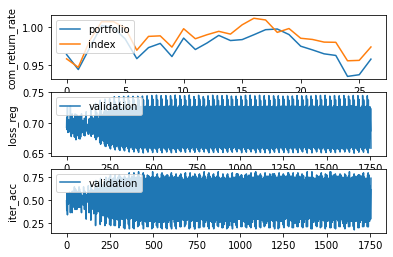

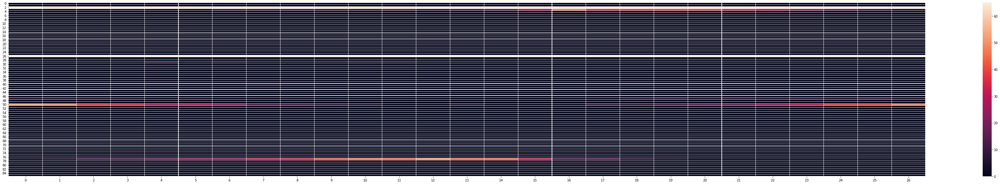

Epochs :  64 Iterations :  27 Loss :  0.6949337345582468 ACC :  0.4989106892435639 MCC :  nan Precision :  0.4909610474413192


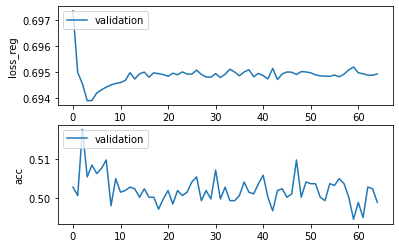

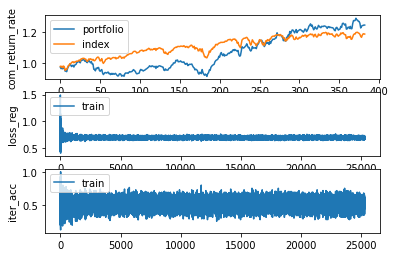

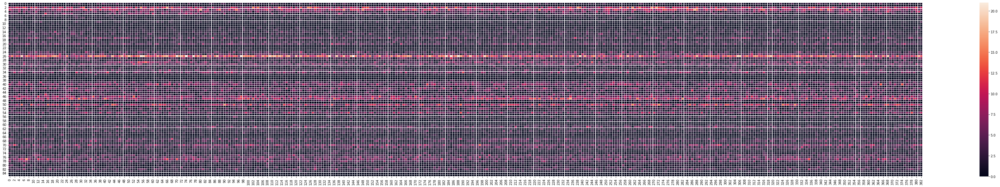

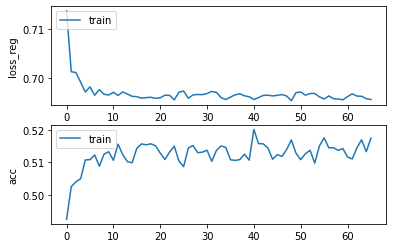

Epochs :  65 Iterations :  25278 Loss :  0.6955800459528094 ACC :  0.5174934886609917 MCC :  0.027728322965874734 Precision :  0.5224565397899393
mode : validation


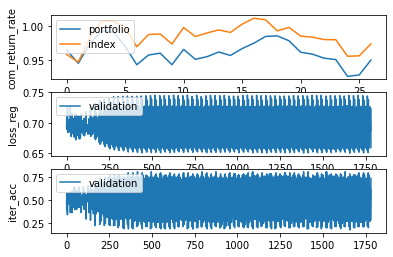

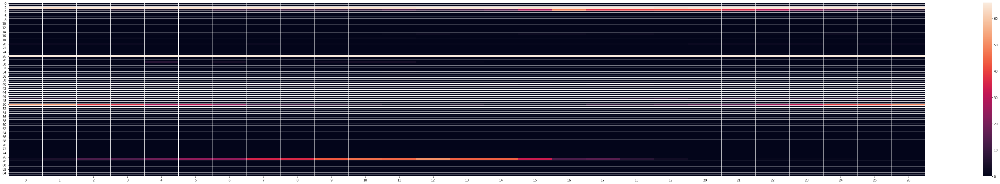

Epochs :  65 Iterations :  27 Loss :  0.6949163609080844 ACC :  0.5028322570853763 MCC :  nan Precision :  0.4935148254174877


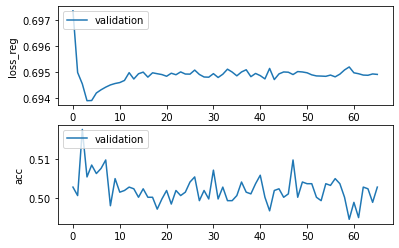

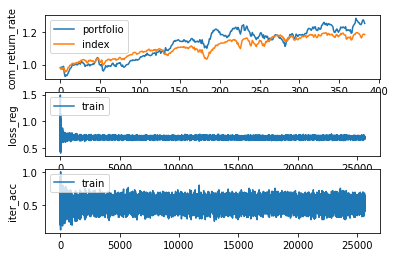

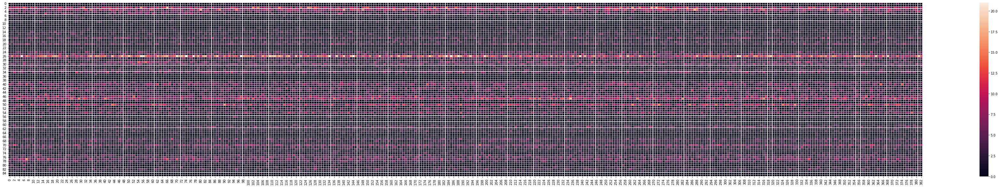

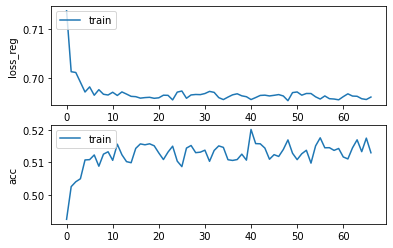

Epochs :  66 Iterations :  25661 Loss :  0.6960869918604121 ACC :  0.5129780532797074 MCC :  0.015551443192129104 Precision :  0.5176572212244216
mode : validation


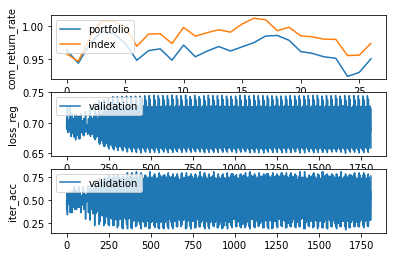

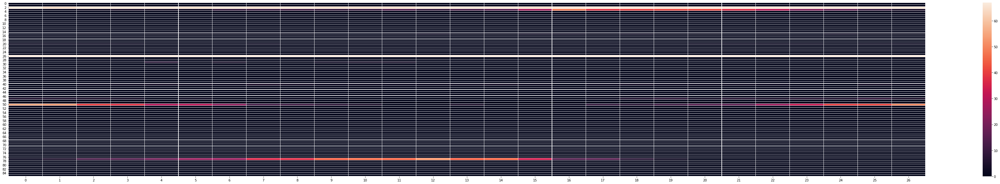

Epochs :  66 Iterations :  27 Loss :  0.6950269076559279 ACC :  0.4997821483347151 MCC :  nan Precision :  0.4927065384194807


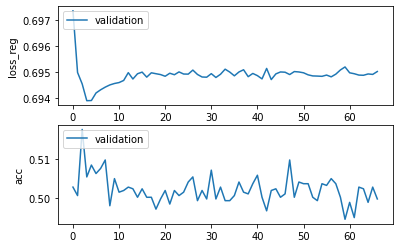

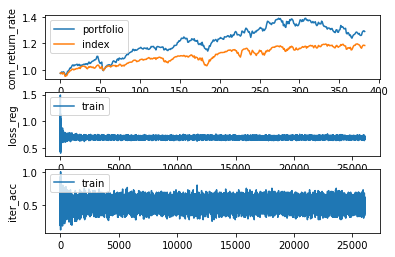

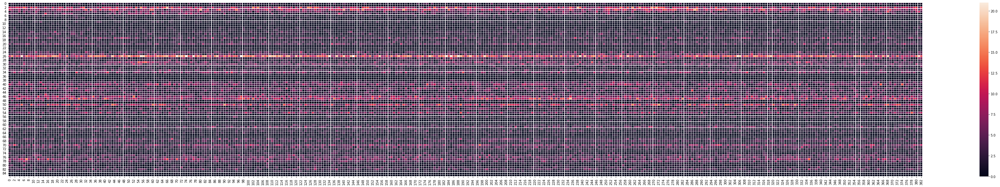

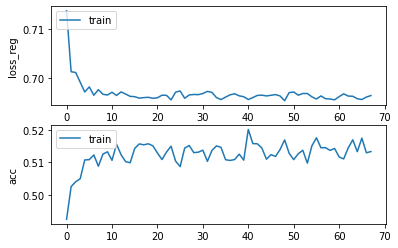

Epochs :  67 Iterations :  26044 Loss :  0.6963948327318495 ACC :  0.513346660230552 MCC :  0.019919572136511993 Precision :  0.5189376934419335
mode : validation


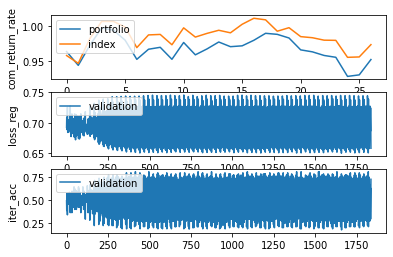

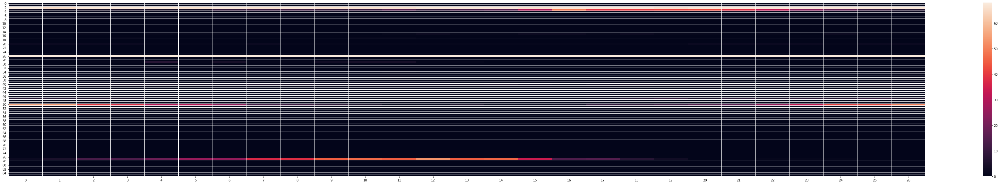

Epochs :  67 Iterations :  27 Loss :  0.6950034234258864 ACC :  0.49847495887014603 MCC :  nan Precision :  0.49209005758166313


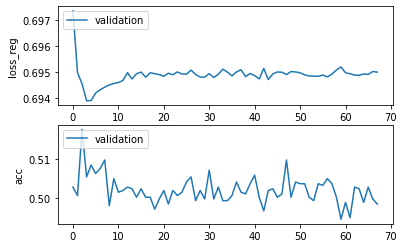

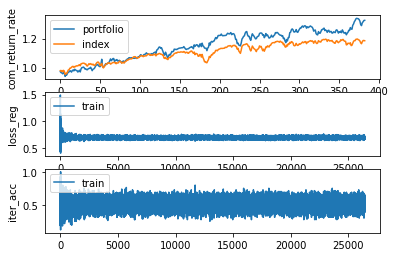

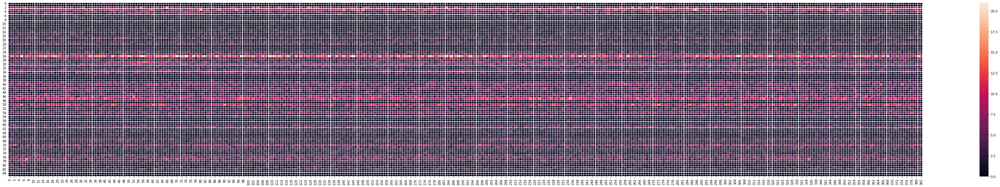

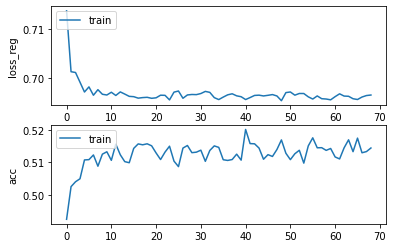

Epochs :  68 Iterations :  26427 Loss :  0.6965012749554905 ACC :  0.5144524818612141 MCC :  0.027815909445280933 Precision :  0.5221252942083321
mode : validation


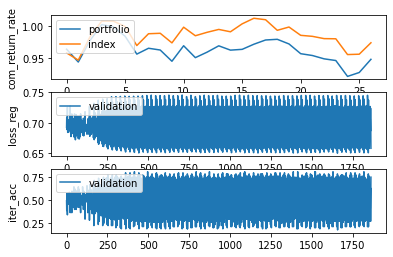

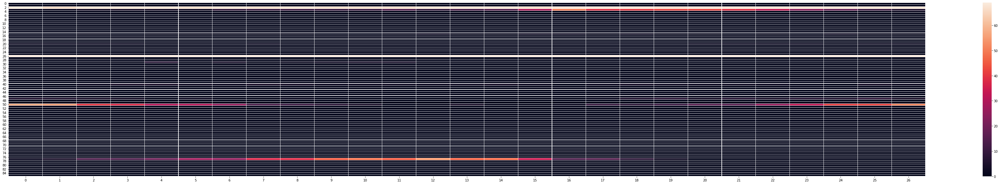

Epochs :  68 Iterations :  27 Loss :  0.6951030139569883 ACC :  0.5015250676208072 MCC :  nan Precision :  0.49206679059123554


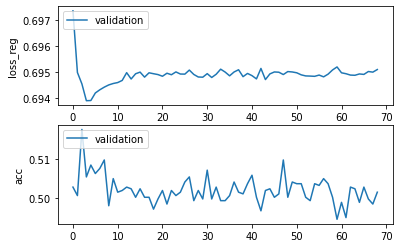

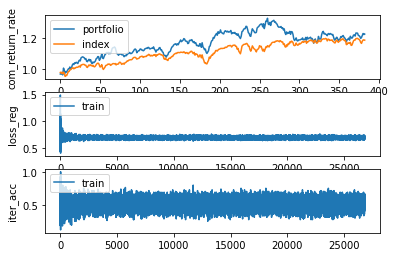

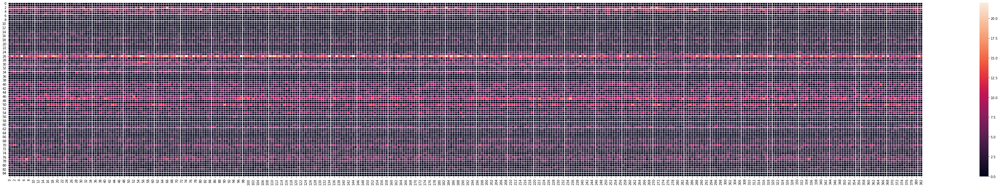

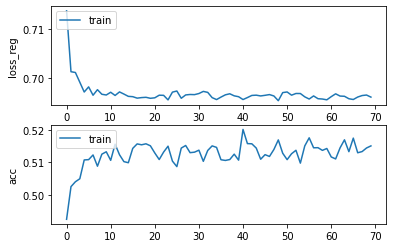

Epochs :  69 Iterations :  26810 Loss :  0.6960701919099992 ACC :  0.5150975434026892 MCC :  0.02662372315368146 Precision :  0.5209820029123956
mode : validation


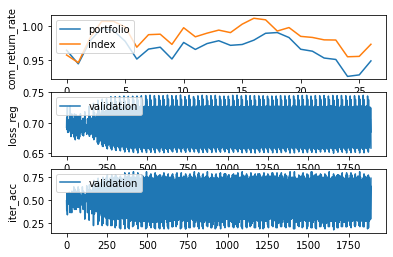

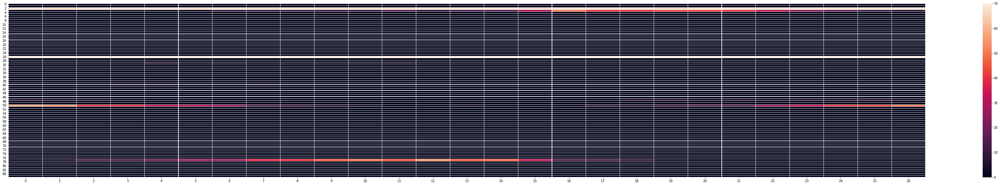

Epochs :  69 Iterations :  27 Loss :  0.6949632344422517 ACC :  0.49891068869166905 MCC :  nan Precision :  0.492899725627568


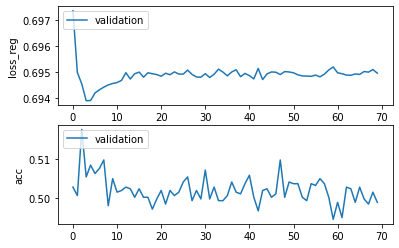

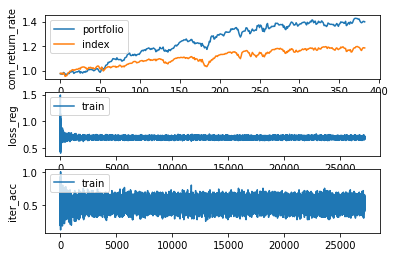

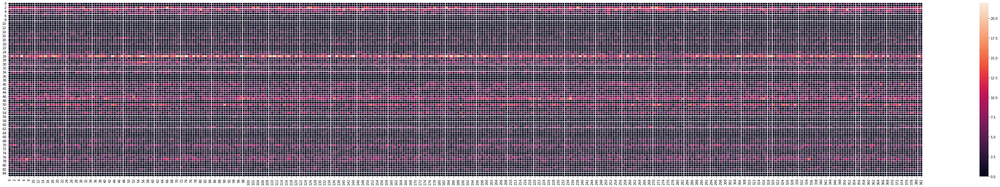

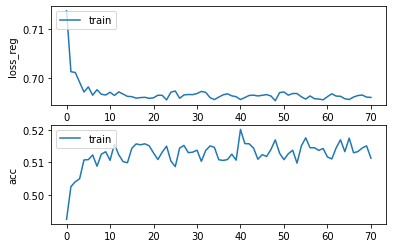

Epochs :  70 Iterations :  27193 Loss :  0.6960081458091736 ACC :  0.5113193215340298 MCC :  0.020828107449131248 Precision :  0.5199229632535896
mode : validation


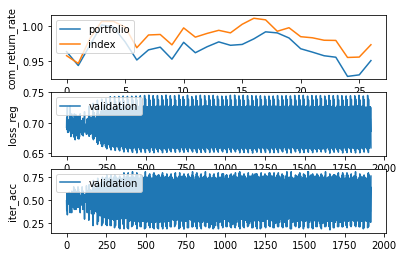

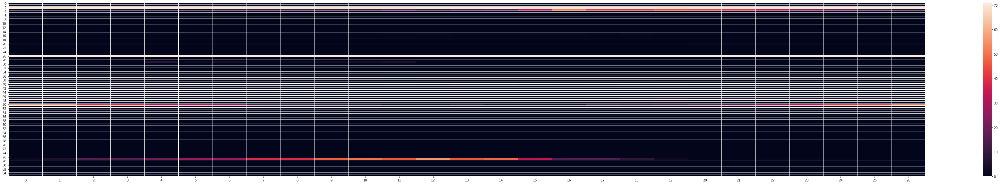

Epochs :  70 Iterations :  27 Loss :  0.695047261538329 ACC :  0.5019607974423302 MCC :  nan Precision :  0.4925274460541981


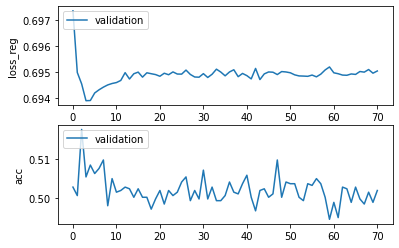

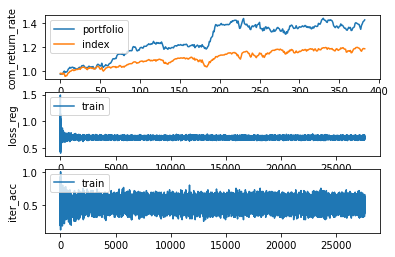

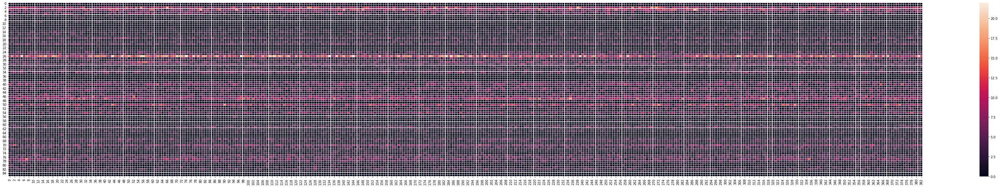

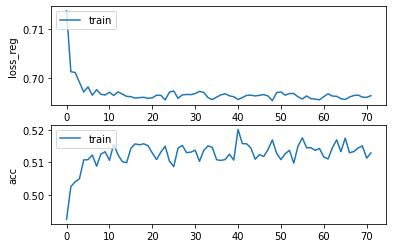

Epochs :  71 Iterations :  27576 Loss :  0.6963783715785951 ACC :  0.5129166191769642 MCC :  0.023053381632005567 Precision :  0.5206716505727942
mode : validation


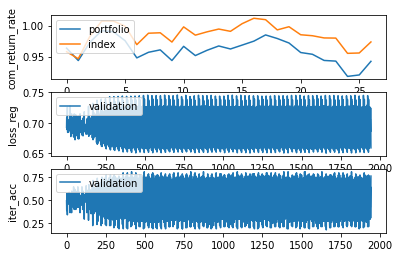

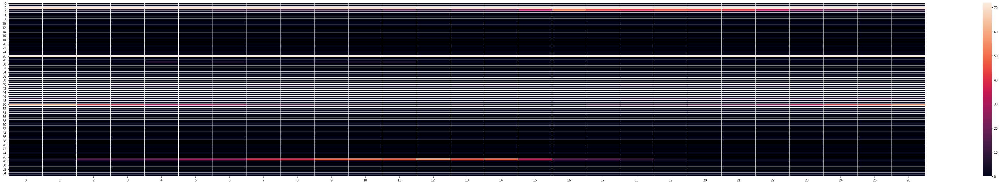

Epochs :  71 Iterations :  27 Loss :  0.6948517229821947 ACC :  0.5037037167284224 MCC :  nan Precision :  0.4934857076516858


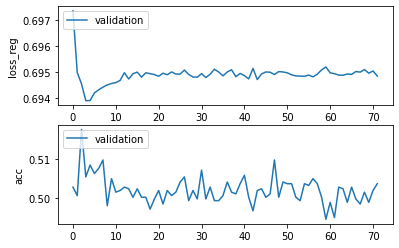

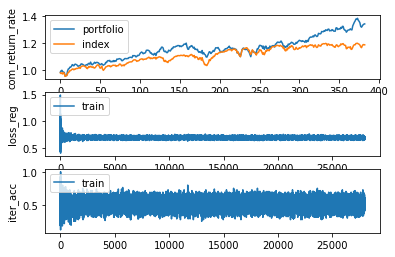

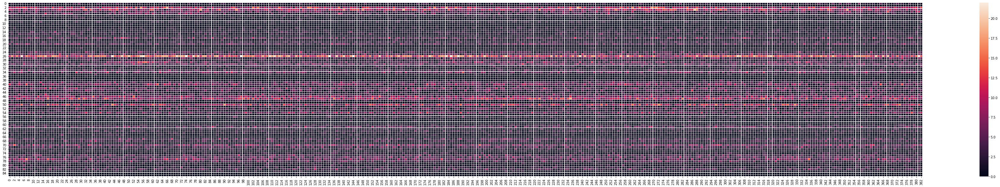

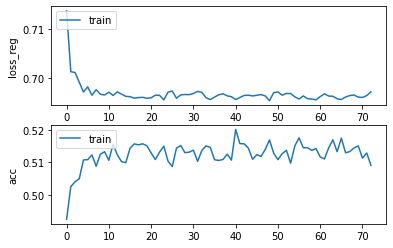

Epochs :  72 Iterations :  27959 Loss :  0.6971828201420935 ACC :  0.5091076799067754 MCC :  0.015462668748163952 Precision :  0.5171523143539775
mode : validation


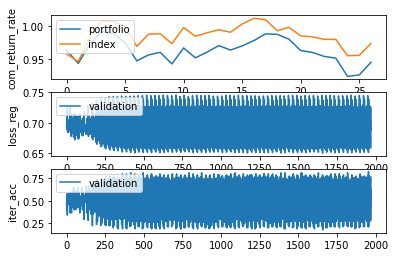

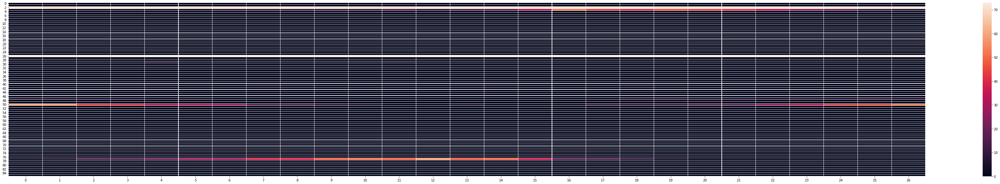

Epochs :  72 Iterations :  27 Loss :  0.6950581404897902 ACC :  0.5041394465499454 MCC :  nan Precision :  0.4945563889901947


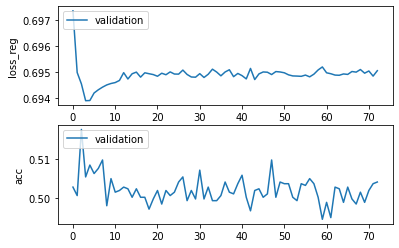

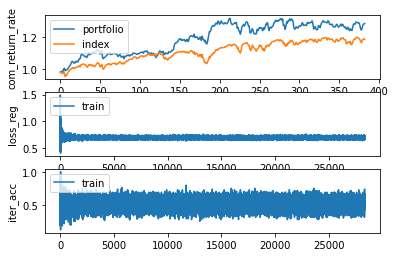

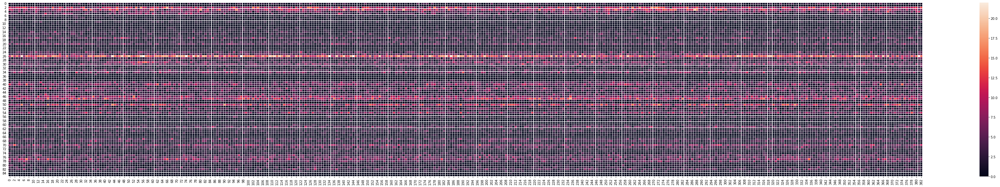

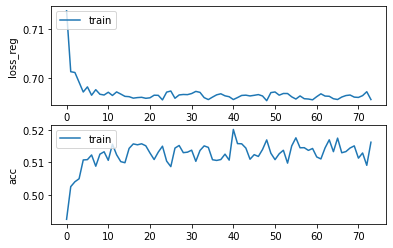

Epochs :  73 Iterations :  28342 Loss :  0.6955698515354186 ACC :  0.5162340821236294 MCC :  0.026160735545762603 Precision :  0.5214969825252462
mode : validation


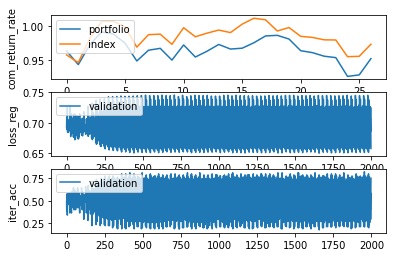

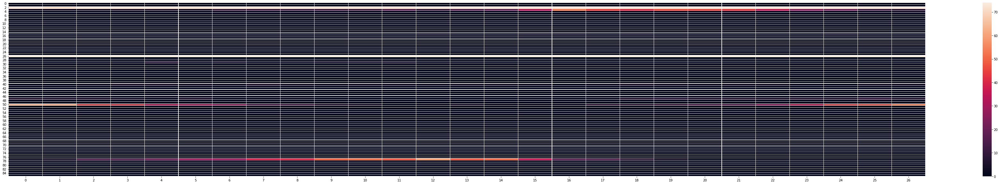

Epochs :  73 Iterations :  27 Loss :  0.694991668065389 ACC :  0.49847495887014603 MCC :  nan Precision :  0.4914099067035649


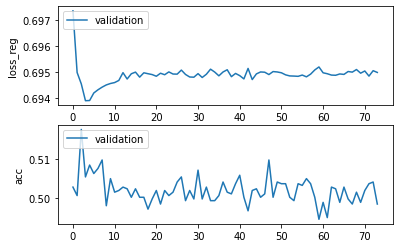

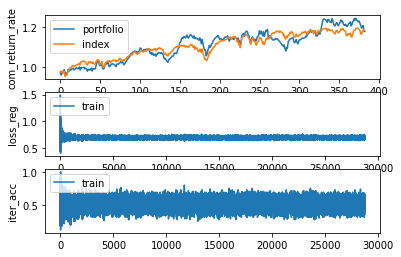

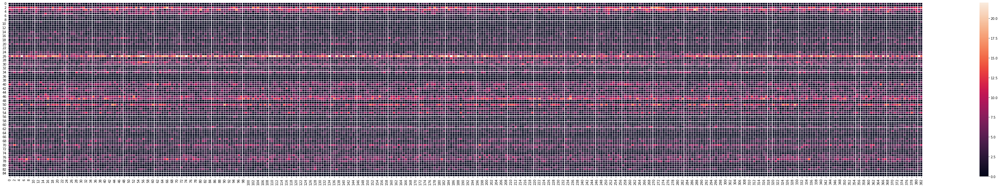

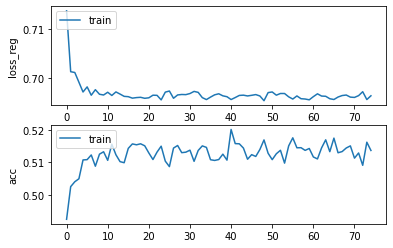

Epochs :  74 Iterations :  28725 Loss :  0.6963442847249403 ACC :  0.5136845503245571 MCC :  0.029418165172242338 Precision :  0.5220355776092402
mode : validation


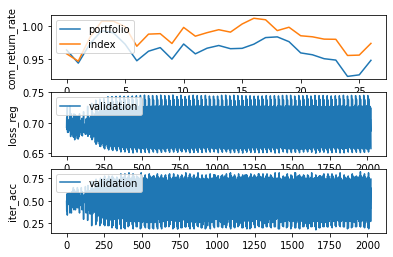

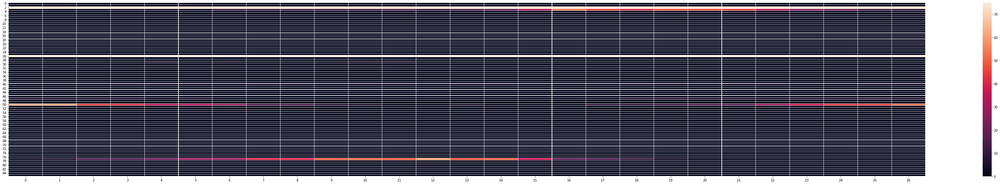

Epochs :  74 Iterations :  27 Loss :  0.6951025260819329 ACC :  0.5028322570853763 MCC :  nan Precision :  0.4944598641660478


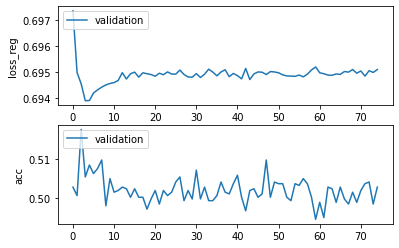

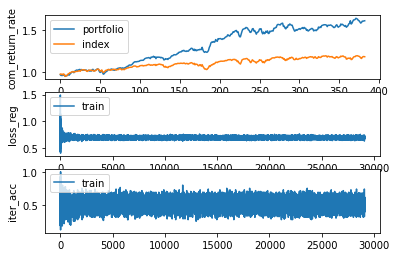

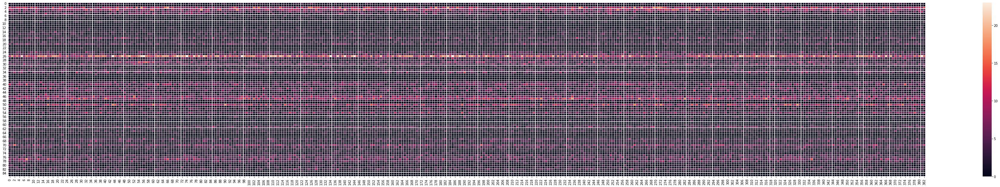

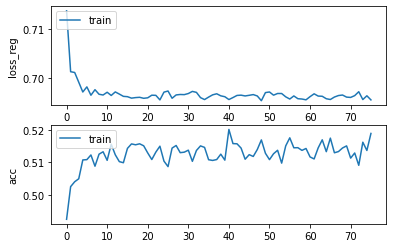

Epochs :  75 Iterations :  29108 Loss :  0.6954966360221644 ACC :  0.5189371999187818 MCC :  0.03295305182010801 Precision :  0.5237583695149765
mode : validation


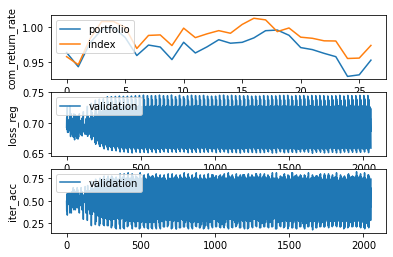

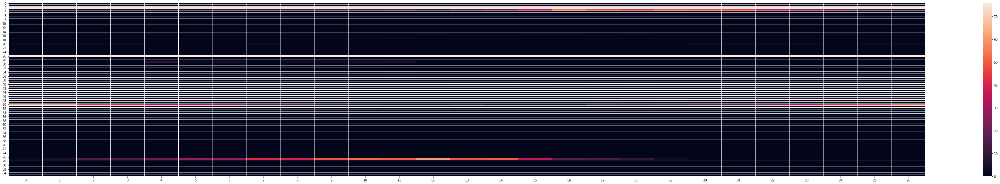

Epochs :  75 Iterations :  27 Loss :  0.6948890178291885 ACC :  0.5041394459980505 MCC :  nan Precision :  0.495823056264608


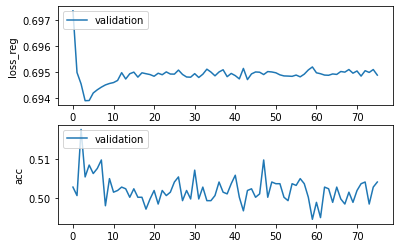

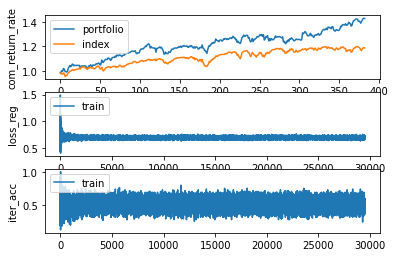

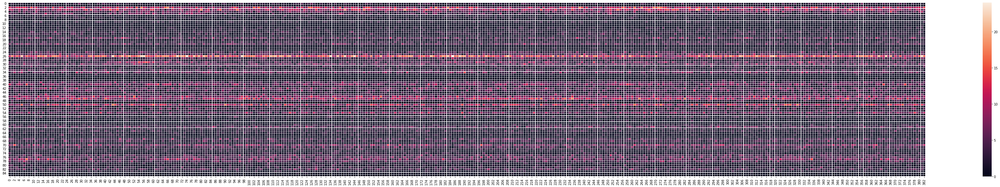

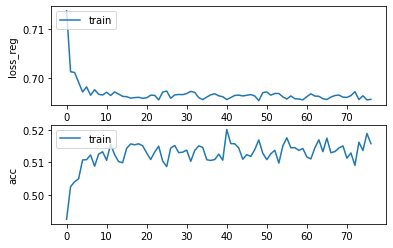

Epochs :  76 Iterations :  29491 Loss :  0.6956119577816199 ACC :  0.5157733236296058 MCC :  0.03371945067321609 Precision :  0.5230653042620529
mode : validation


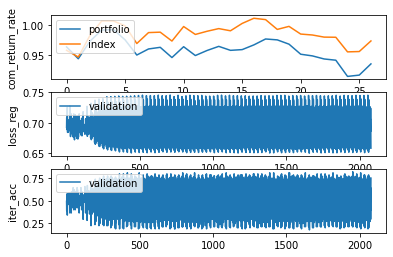

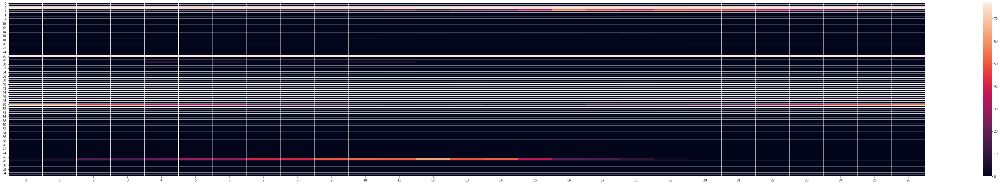

Epochs :  76 Iterations :  27 Loss :  0.6947890498020031 ACC :  0.5041394465499454 MCC :  nan Precision :  0.49434839375317097


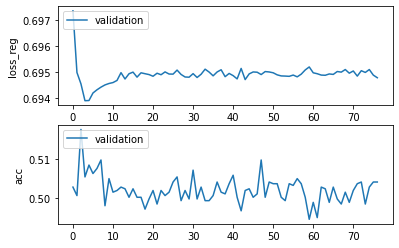

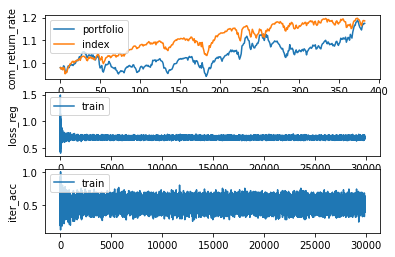

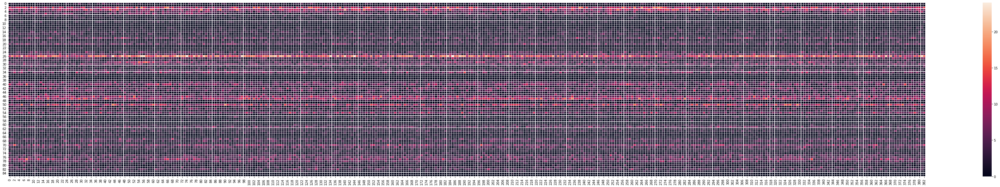

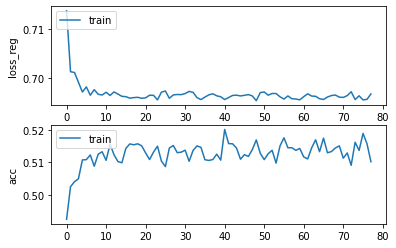

Epochs :  77 Iterations :  29874 Loss :  0.6967280488412623 ACC :  0.510213500292432 MCC :  0.02489289735941163 Precision :  0.5206057276557304
mode : validation


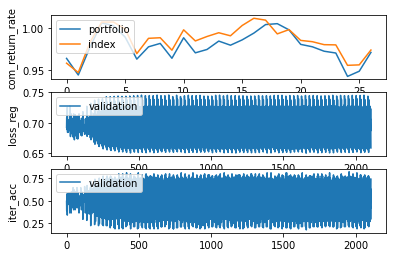

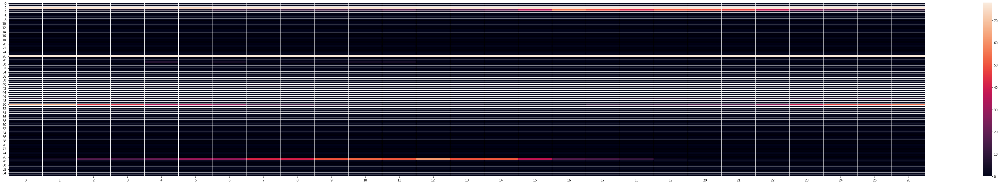

Epochs :  77 Iterations :  27 Loss :  0.694900221294827 ACC :  0.5002178781562381 MCC :  nan Precision :  0.49400994905995


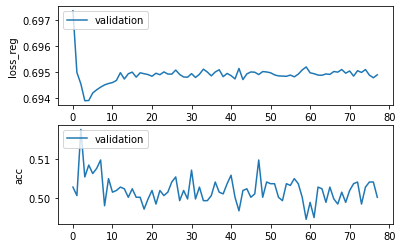

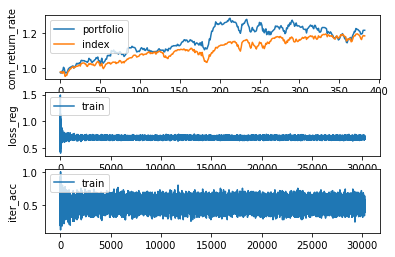

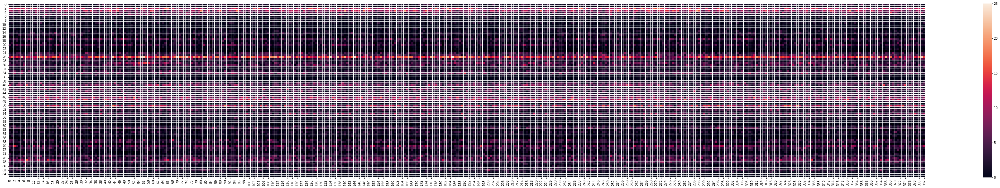

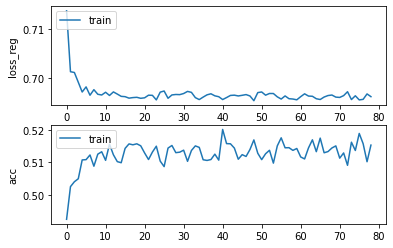

Epochs :  78 Iterations :  30257 Loss :  0.6961651847505694 ACC :  0.5153432814477318 MCC :  0.02861283419990557 Precision :  0.5220926782607488
mode : validation


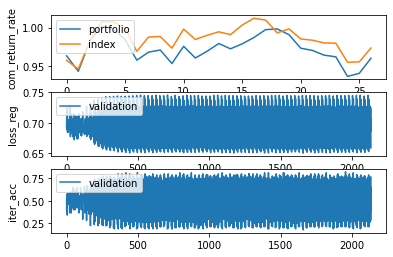

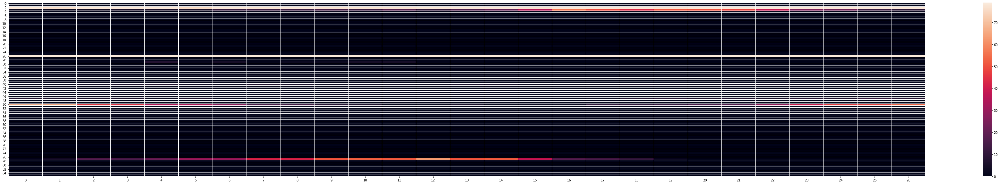

Epochs :  78 Iterations :  27 Loss :  0.695120996899075 ACC :  0.500653608529656 MCC :  nan Precision :  0.4911854446486191


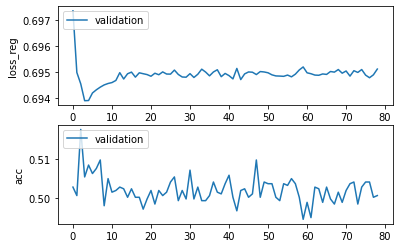

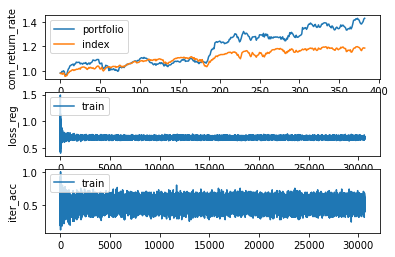

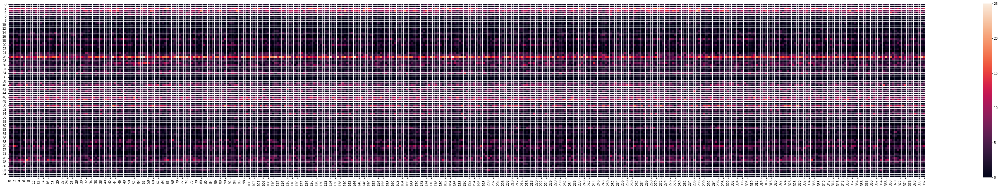

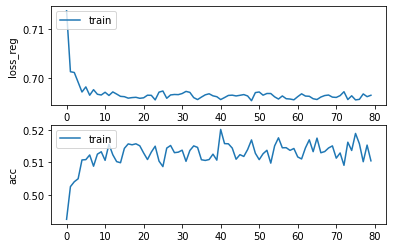

Epochs :  79 Iterations :  30640 Loss :  0.6964530073320274 ACC :  0.5104899565171324 MCC :  0.020041582155145957 Precision :  0.5185318564456297
mode : validation


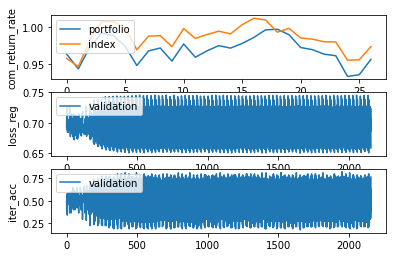

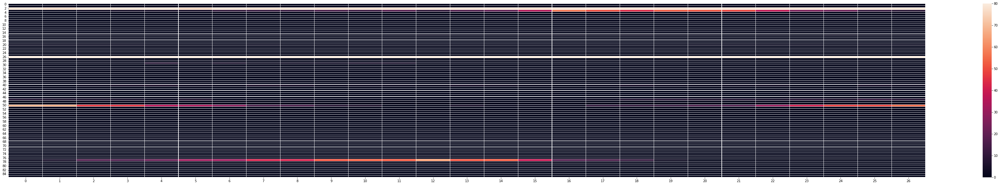

Epochs :  79 Iterations :  27 Loss :  0.6948493939858896 ACC :  0.5023965272638533 MCC :  nan Precision :  0.4917098841871376


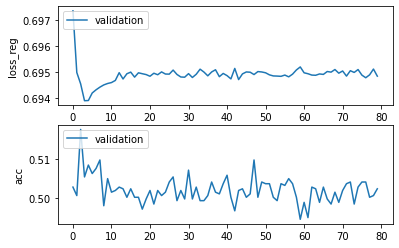

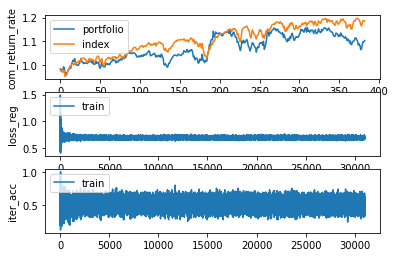

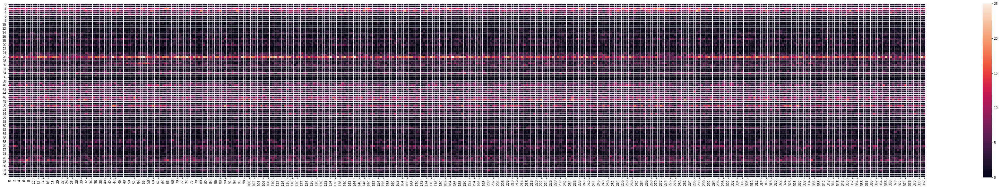

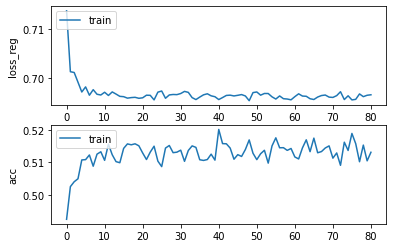

Epochs :  80 Iterations :  31023 Loss :  0.6965503837358858 ACC :  0.5131316402873545 MCC :  0.024365568397823216 Precision :  0.5210231298400824
mode : validation


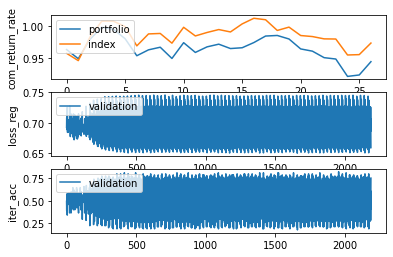

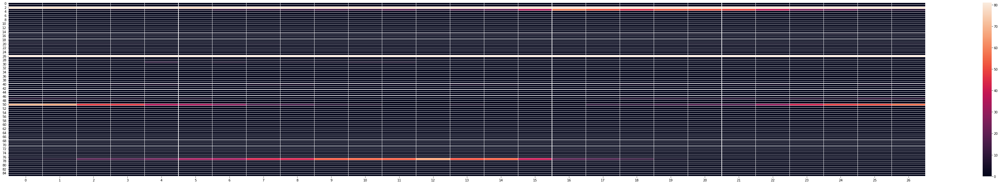

Epochs :  80 Iterations :  27 Loss :  0.6949262045047901 ACC :  0.5032679869068993 MCC :  nan Precision :  0.49260914725837884


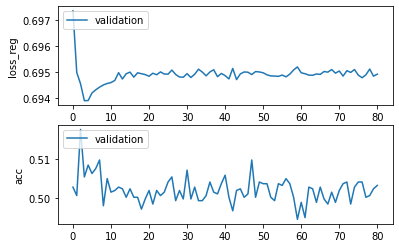

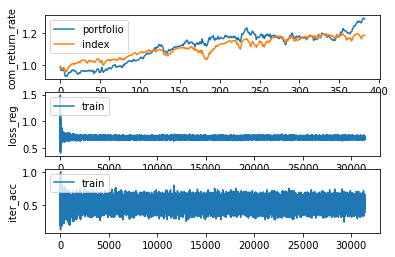

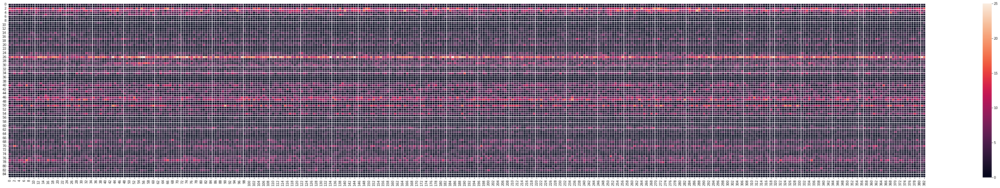

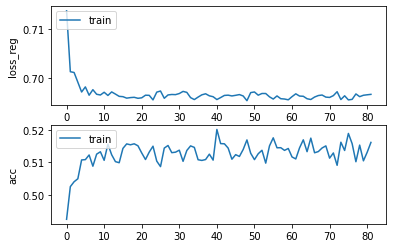

Epochs :  81 Iterations :  31406 Loss :  0.6966390503915731 ACC :  0.5161726473983834 MCC :  0.029283855690963704 Precision :  0.5227802732555735
mode : validation


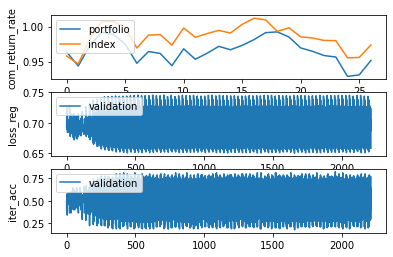

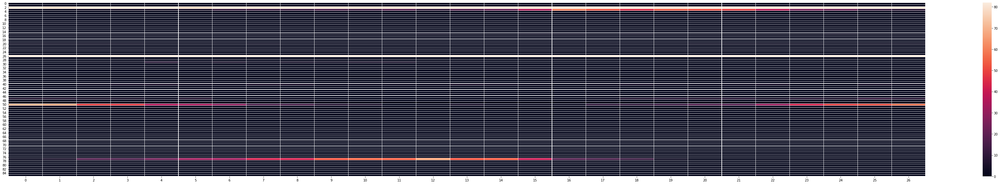

Epochs :  81 Iterations :  27 Loss :  0.695066198154732 ACC :  0.5015250676208072 MCC :  nan Precision :  0.4937753491793518


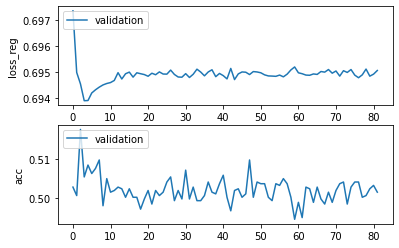

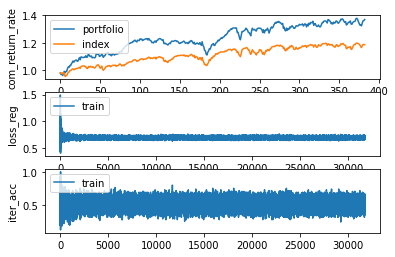

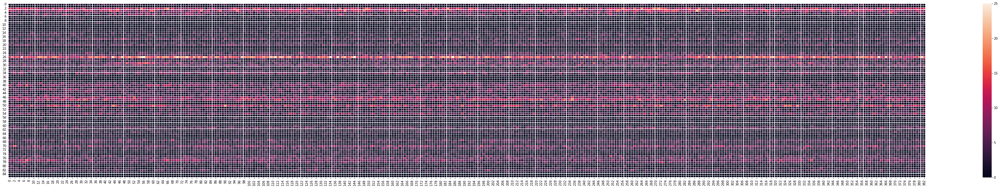

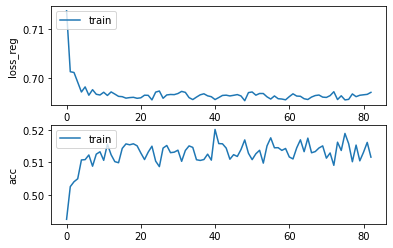

Epochs :  82 Iterations :  31789 Loss :  0.6970509684428222 ACC :  0.5116264932149384 MCC :  0.022069931612046092 Precision :  0.5194437977646335
mode : validation


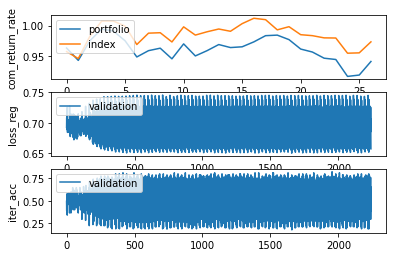

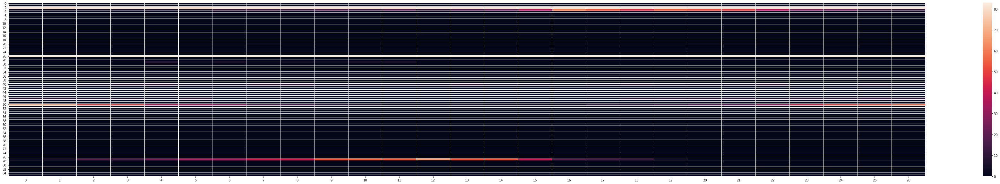

Epochs :  82 Iterations :  27 Loss :  0.6948885763133014 ACC :  0.5058823658360375 MCC :  nan Precision :  0.49366406682464814


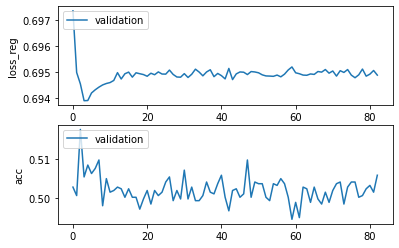

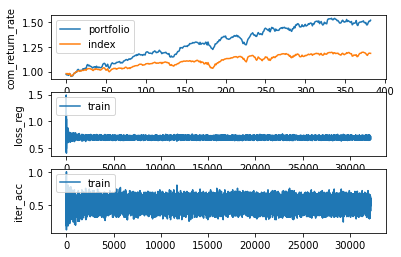

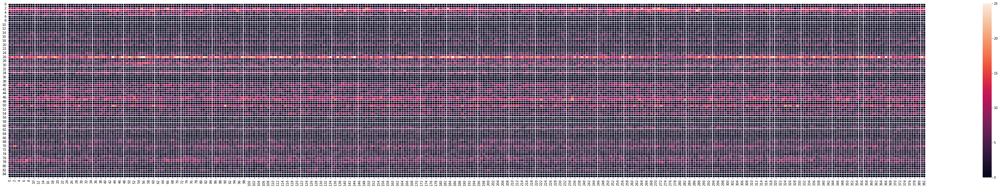

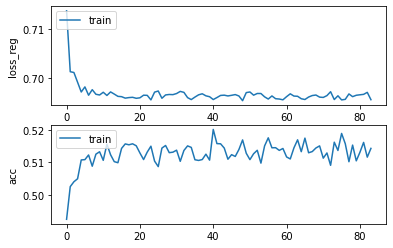

Epochs :  83 Iterations :  32172 Loss :  0.6955410105130069 ACC :  0.5143296129554121 MCC :  0.020975874894050586 Precision :  0.5201151857672954
mode : validation


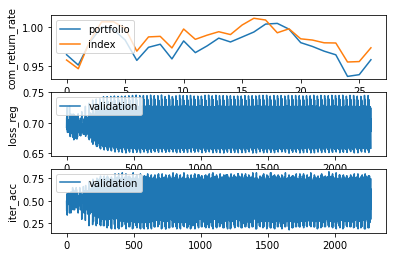

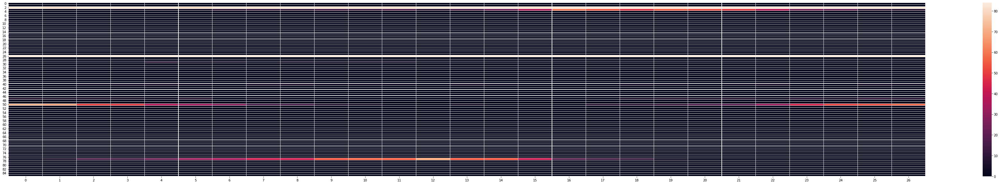

Epochs :  83 Iterations :  27 Loss :  0.6949167913860745 ACC :  0.4967320395840539 MCC :  nan Precision :  0.4921278892153943


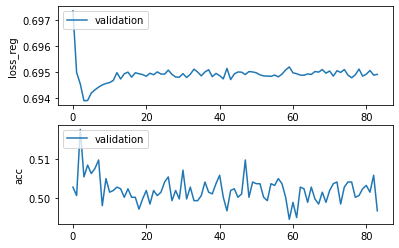

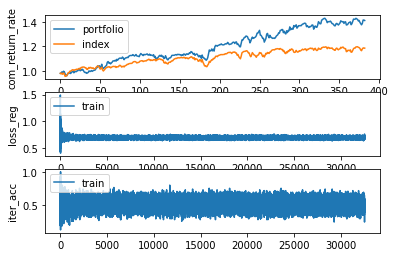

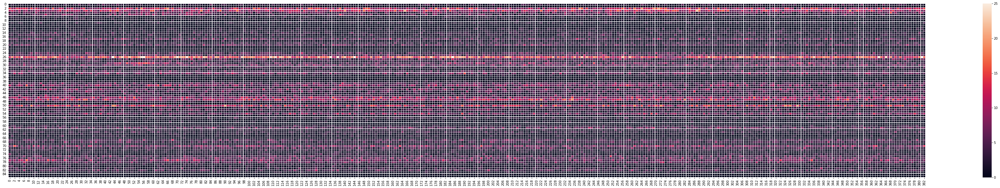

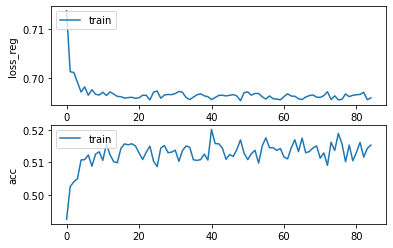

Epochs :  84 Iterations :  32555 Loss :  0.6959146981762221 ACC :  0.5153432815644511 MCC :  0.02693491063081336 Precision :  0.5218018241829723
mode : validation


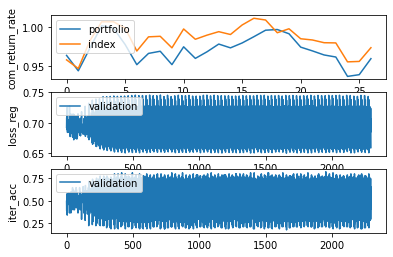

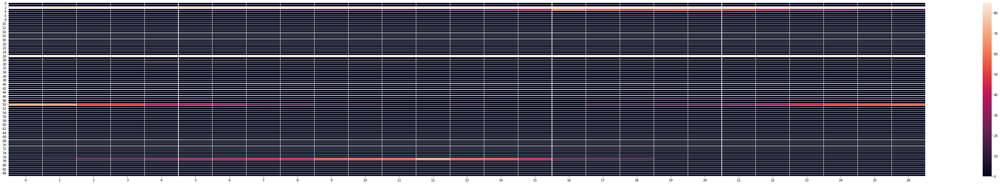

Epochs :  84 Iterations :  27 Loss :  0.6947341737923799 ACC :  0.5019607974423302 MCC :  nan Precision :  0.49260043801256903


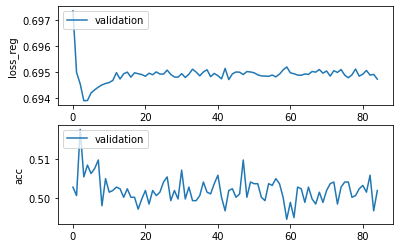

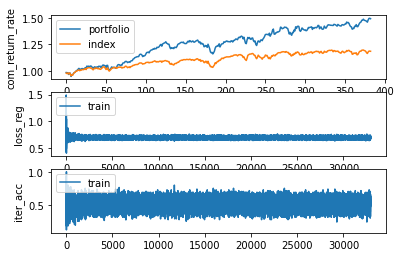

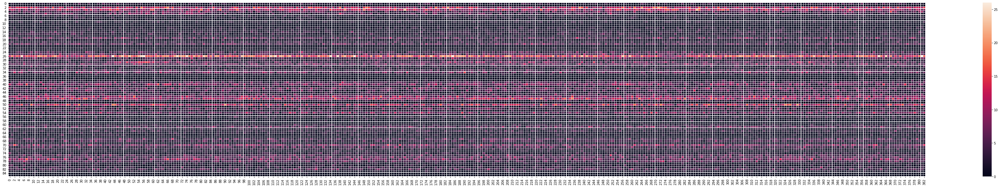

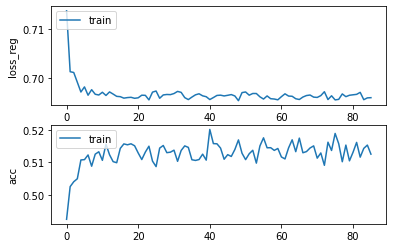

Epochs :  85 Iterations :  32938 Loss :  0.6959554120392463 ACC :  0.5125480114479911 MCC :  0.01883110511007259 Precision :  0.5183790686343341
mode : validation


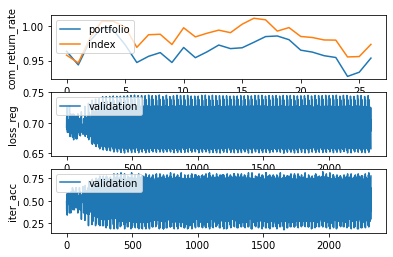

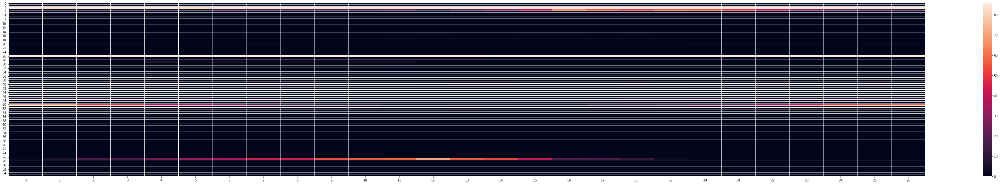

Epochs :  85 Iterations :  27 Loss :  0.6948837814507661 ACC :  0.5023965272638533 MCC :  nan Precision :  0.4924068069430413


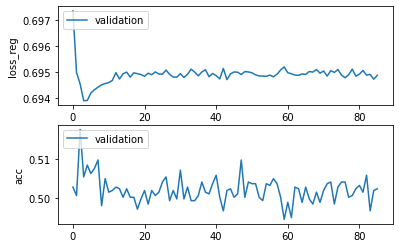

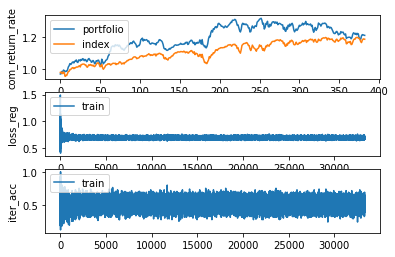

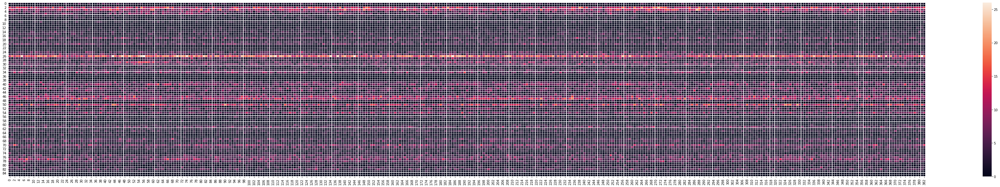

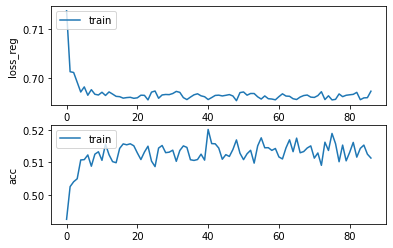

Epochs :  86 Iterations :  33321 Loss :  0.6972901751104907 ACC :  0.5113500386243078 MCC :  0.02291913382349142 Precision :  0.5207529901806508
mode : validation


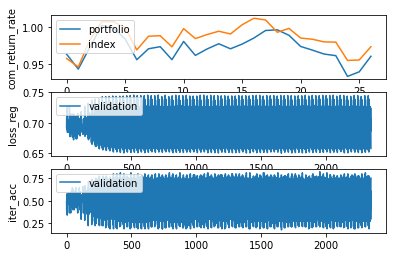

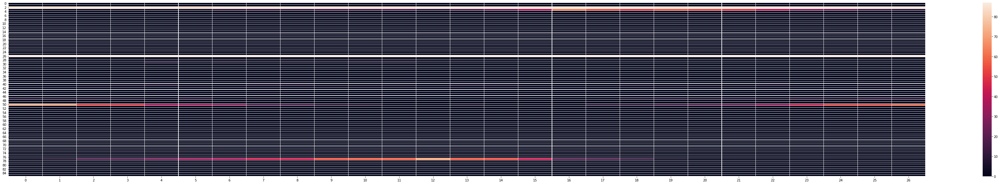

Epochs :  86 Iterations :  27 Loss :  0.6949358979860941 ACC :  0.5037037172803173 MCC :  nan Precision :  0.49438975737602625


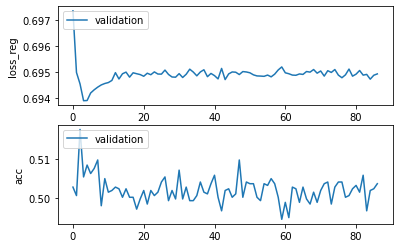

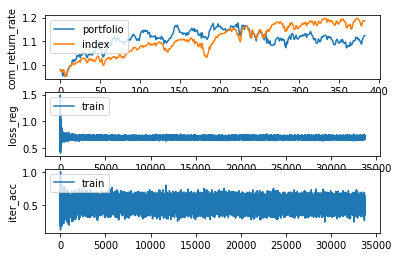

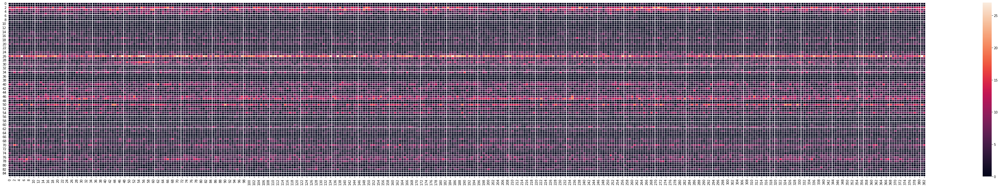

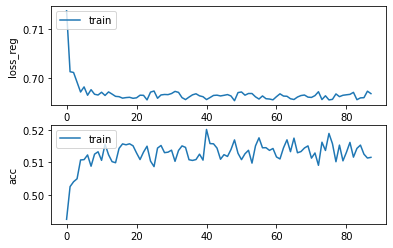

Epochs :  87 Iterations :  33704 Loss :  0.6967912190265506 ACC :  0.5115650596568853 MCC :  0.022236527186300478 Precision :  0.5207306983158498
mode : validation


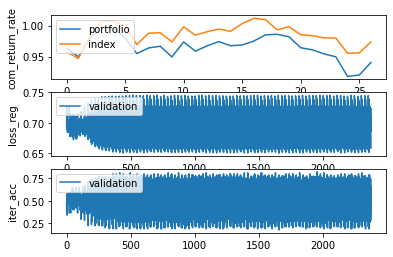

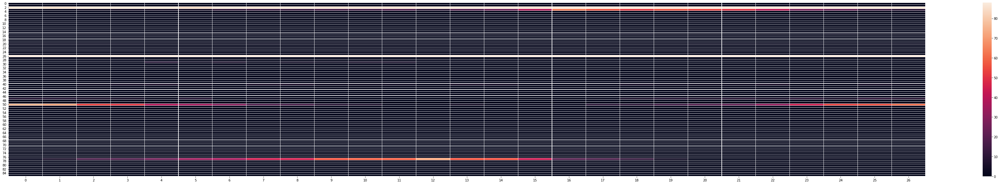

Epochs :  87 Iterations :  27 Loss :  0.6949724974455657 ACC :  0.5019607974423302 MCC :  nan Precision :  0.492441281883253


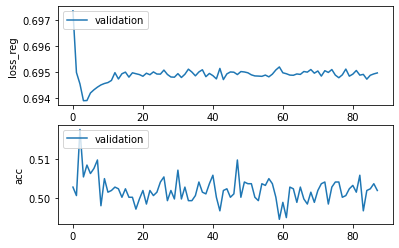

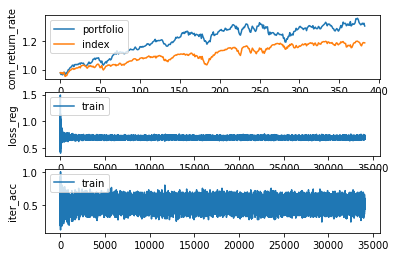

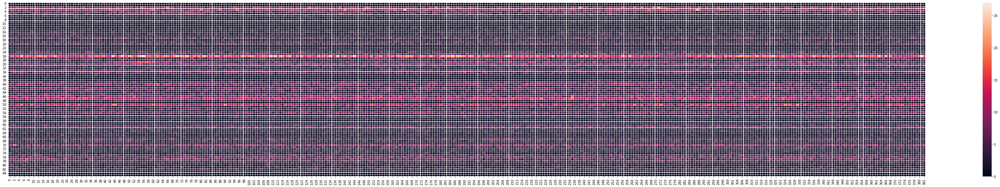

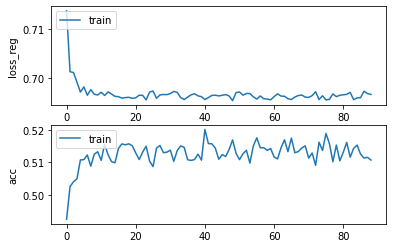

Epochs :  88 Iterations :  34087 Loss :  0.6966180521265334 ACC :  0.5107356947178007 MCC :  0.016432862014536486 Precision :  0.5183016143680864
mode : validation


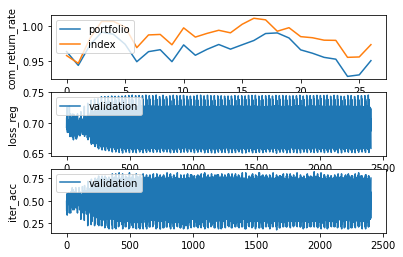

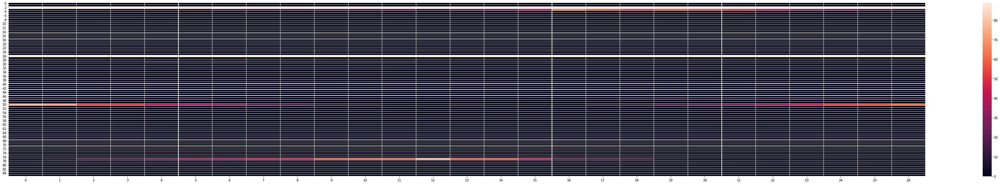

Epochs :  88 Iterations :  27 Loss :  0.6948498575775711 ACC :  0.4997821483347151 MCC :  nan Precision :  0.4919603704992268


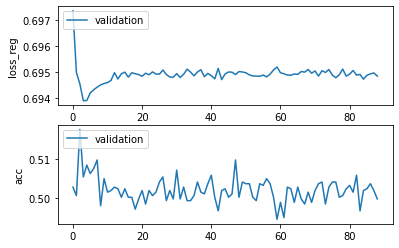

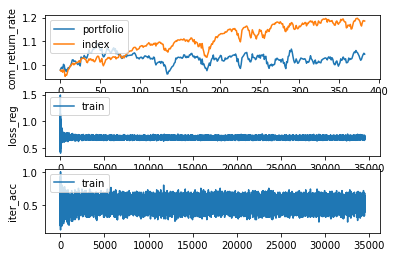

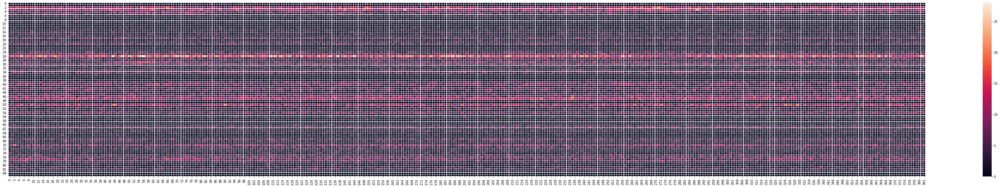

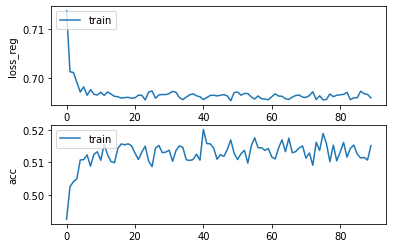

Epochs :  89 Iterations :  34470 Loss :  0.6959384841645044 ACC :  0.5151589789060638 MCC :  0.028158250570907584 Precision :  0.5219627864483753
mode : validation


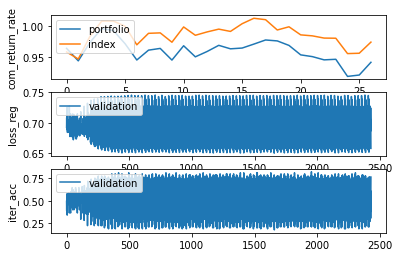

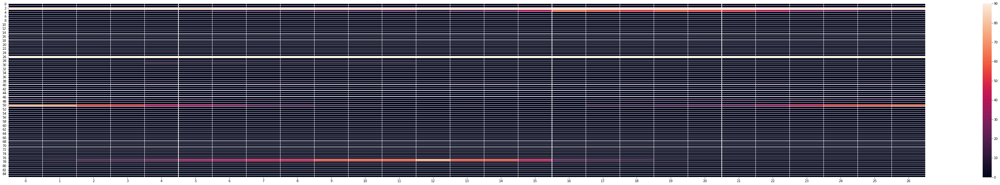

Epochs :  89 Iterations :  27 Loss :  0.6950518290201823 ACC :  0.5015250676208072 MCC :  nan Precision :  0.49308461868376646


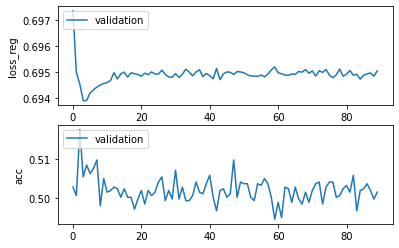

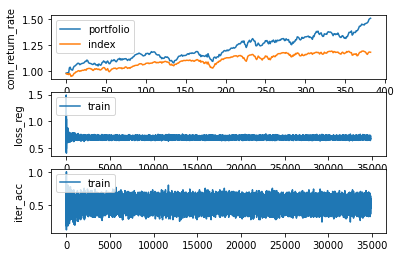

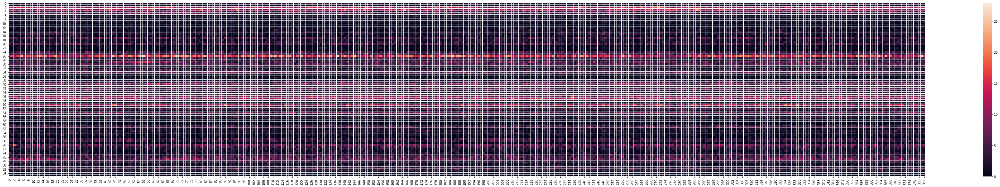

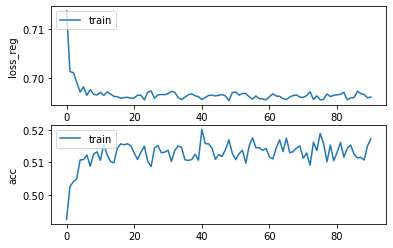

Epochs :  90 Iterations :  34853 Loss :  0.6960790541713605 ACC :  0.5173091857302593 MCC :  0.025645485119565874 Precision :  0.5216933054261046
mode : validation


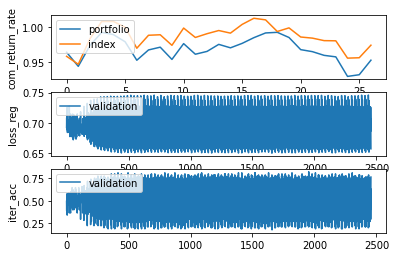

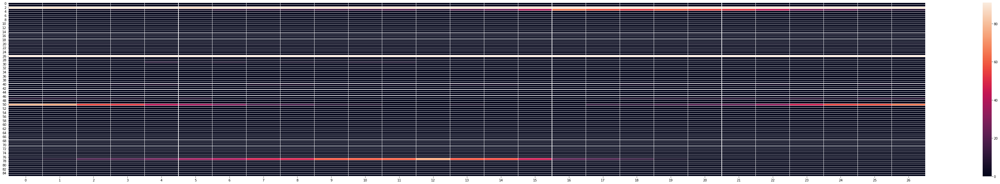

Epochs :  90 Iterations :  27 Loss :  0.6949226392640008 ACC :  0.5041394465499454 MCC :  nan Precision :  0.4951921133669438


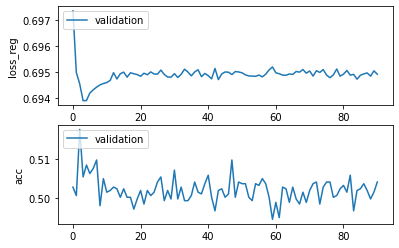

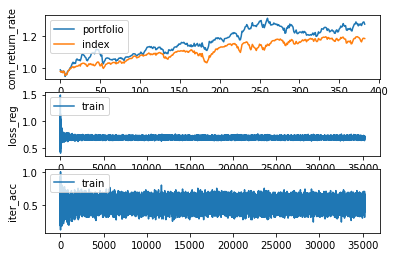

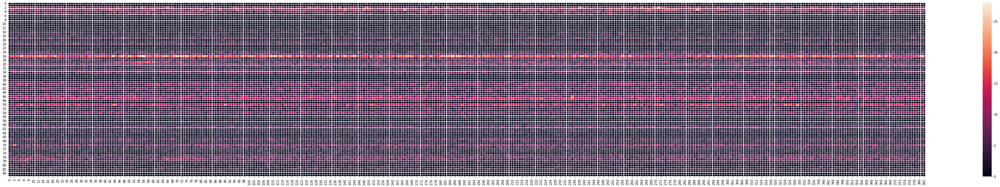

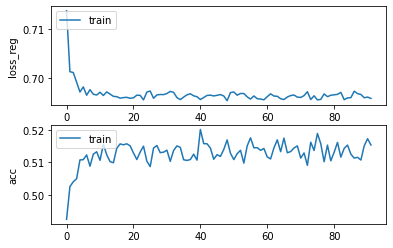

Epochs :  91 Iterations :  35236 Loss :  0.6957978280966338 ACC :  0.5153739978376941 MCC :  0.02610403157049649 Precision :  0.5204163883270467
mode : validation


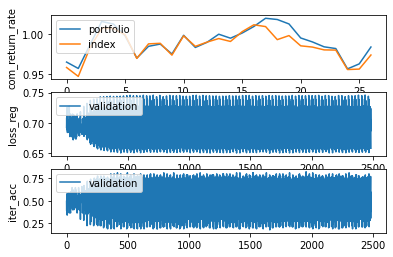

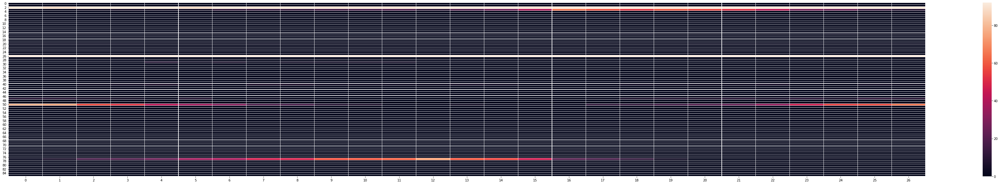

Epochs :  91 Iterations :  27 Loss :  0.6949919903719867 ACC :  0.5032679874587942 MCC :  nan Precision :  0.4919332092007001


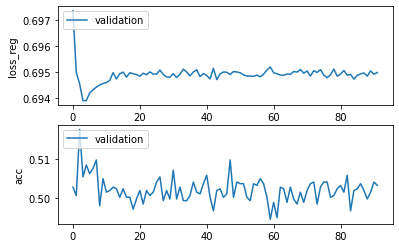

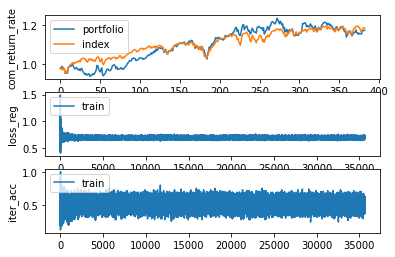

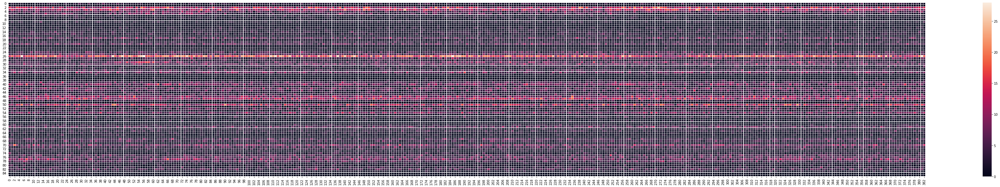

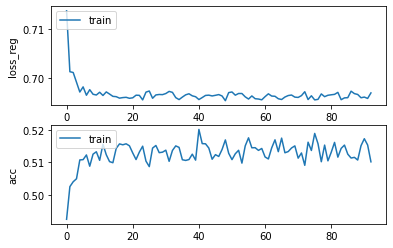

Epochs :  92 Iterations :  35619 Loss :  0.6969378841141185 ACC :  0.5101827838246568 MCC :  0.02143024955389841 Precision :  0.5204288674416336
mode : validation


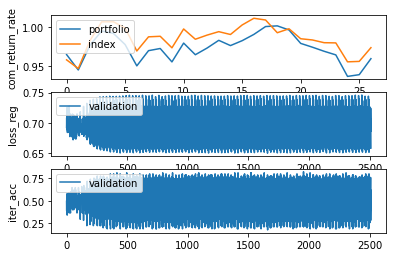

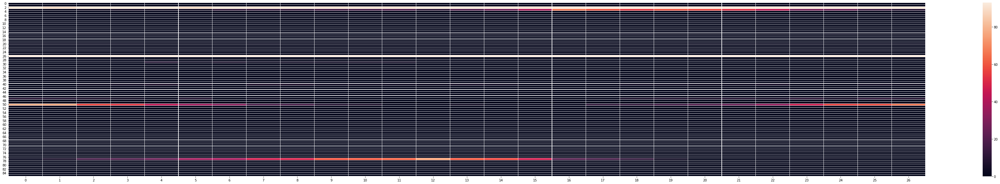

Epochs :  92 Iterations :  27 Loss :  0.6950693439554285 ACC :  0.49760349922709995 MCC :  nan Precision :  0.49063052775131333


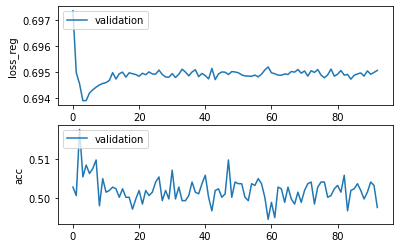

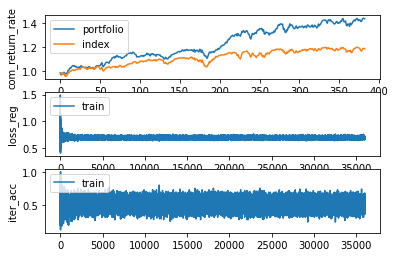

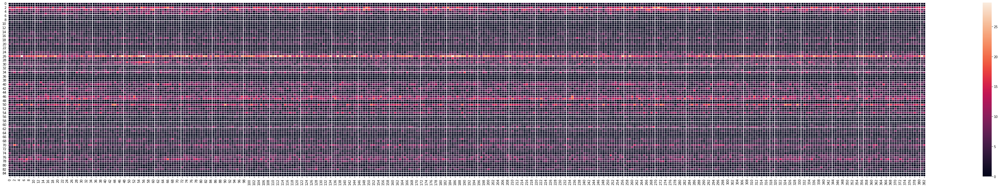

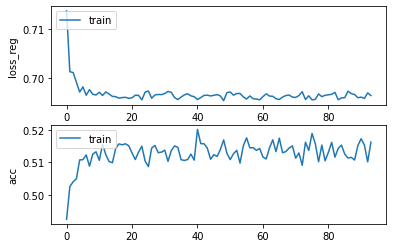

Epochs :  93 Iterations :  36002 Loss :  0.6964046189430178 ACC :  0.5162647992917203 MCC :  0.028759325274379376 Precision :  0.5225385340130049
mode : validation


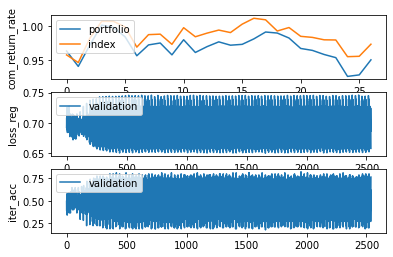

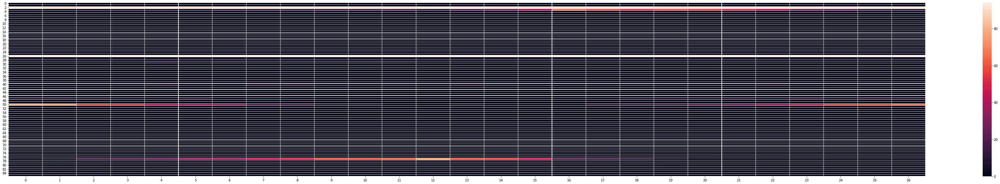

Epochs :  93 Iterations :  27 Loss :  0.6949433772652237 ACC :  0.5037037167284224 MCC :  nan Precision :  0.4936003702244273


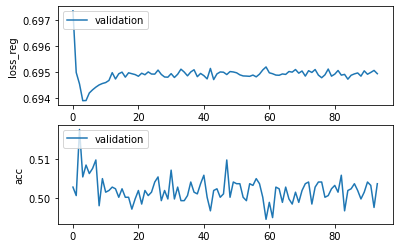

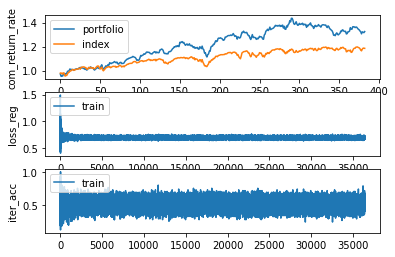

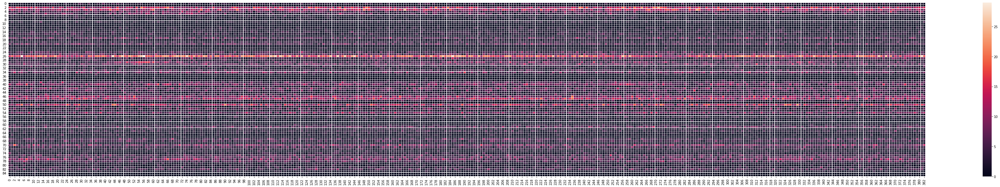

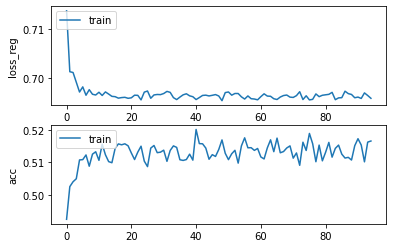

Epochs :  94 Iterations :  36385 Loss :  0.6958256877433537 ACC :  0.516602688529784 MCC :  0.028368772808146266 Precision :  0.5220731462573258
mode : validation


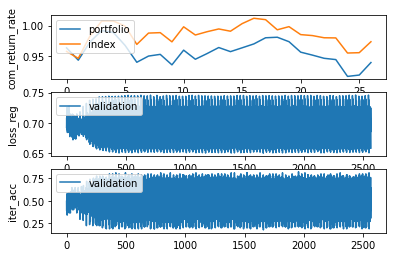

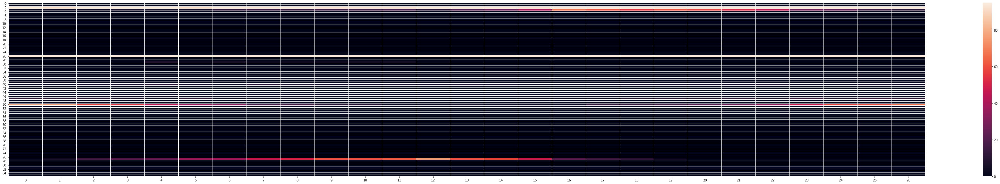

Epochs :  94 Iterations :  27 Loss :  0.6949396376256589 ACC :  0.5054466360145144 MCC :  nan Precision :  0.4938064514900799


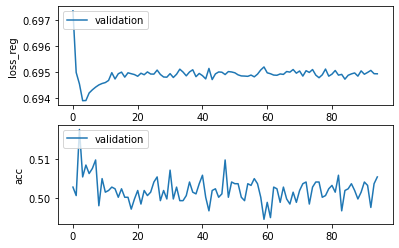

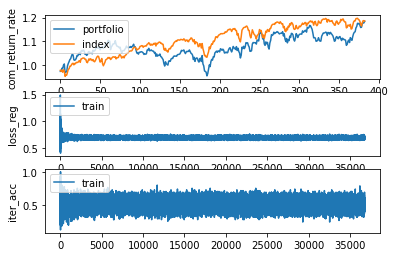

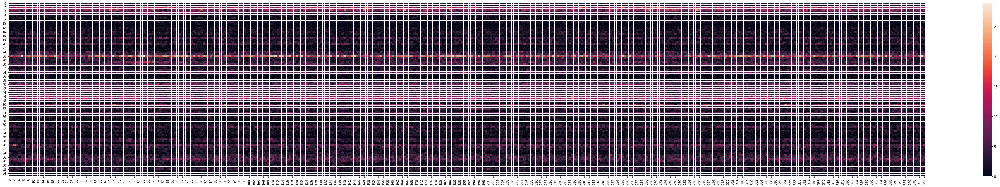

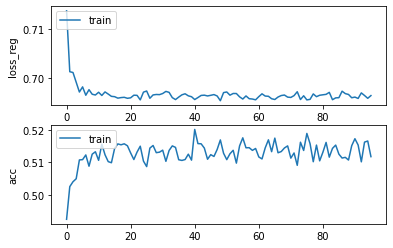

Epochs :  95 Iterations :  36768 Loss :  0.6963856657553591 ACC :  0.5117800812341525 MCC :  0.021596248875318615 Precision :  0.520130650804186
mode : validation


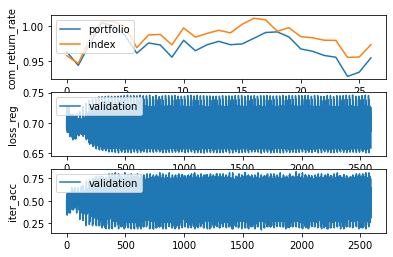

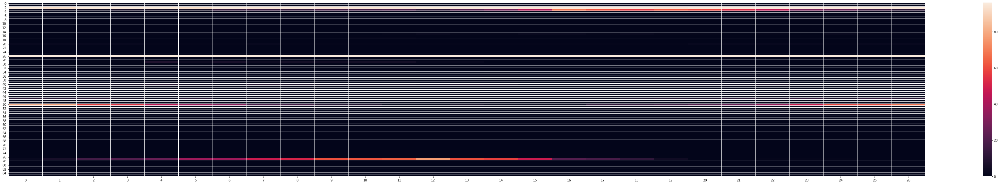

Epochs :  95 Iterations :  27 Loss :  0.6949056585629781 ACC :  0.5106753938727908 MCC :  nan Precision :  0.4948974856761871


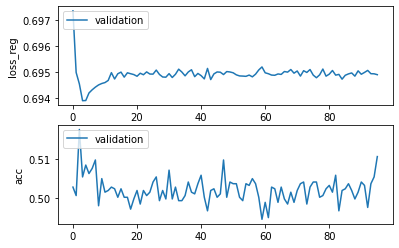

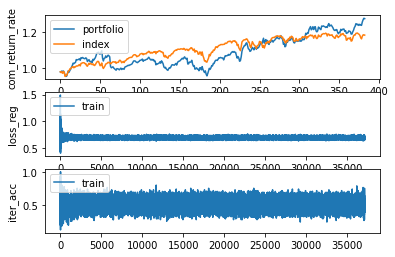

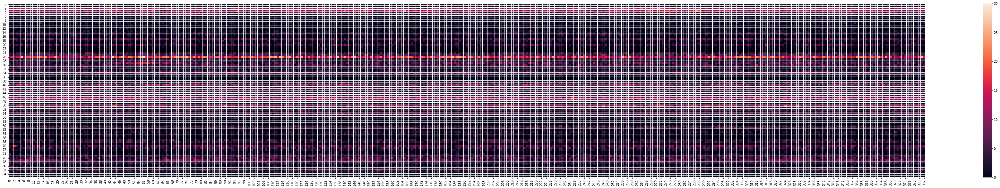

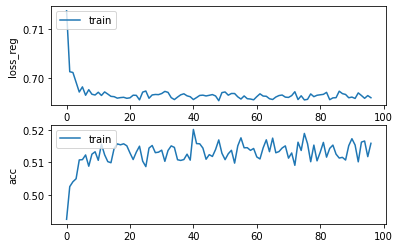

Epochs :  96 Iterations :  37151 Loss :  0.6959436577854207 ACC :  0.5158961922630628 MCC :  0.024100844332505766 Precision :  0.5207924452359853
mode : validation


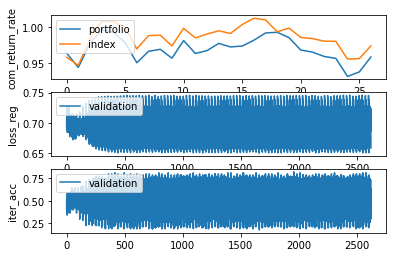

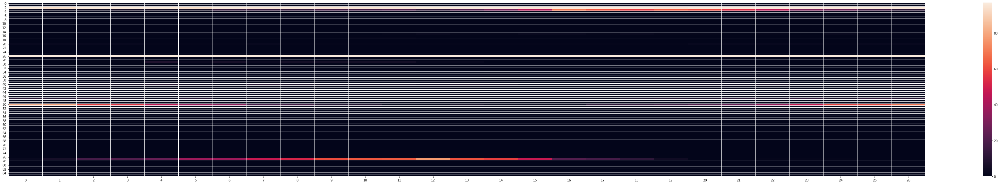

Epochs :  96 Iterations :  27 Loss :  0.695164821766041 ACC :  0.4967320395840539 MCC :  nan Precision :  0.4919247725219638


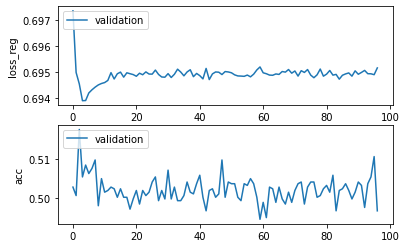

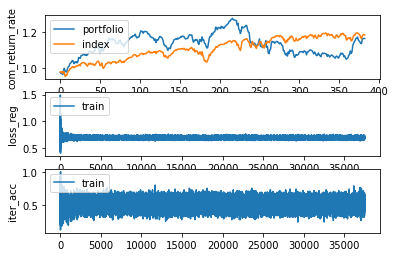

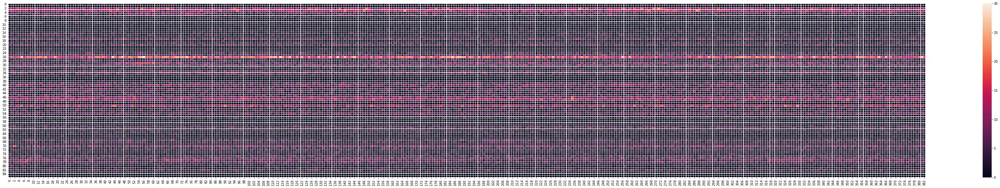

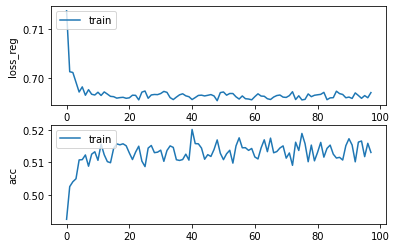

Epochs :  97 Iterations :  37534 Loss :  0.6970009031868479 ACC :  0.5130702049396056 MCC :  0.024580249920920238 Precision :  0.5201143024892938
mode : validation


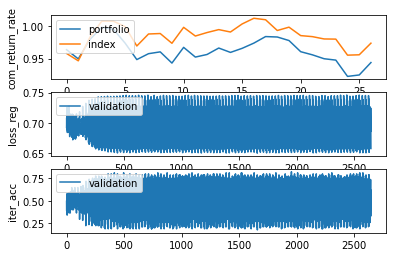

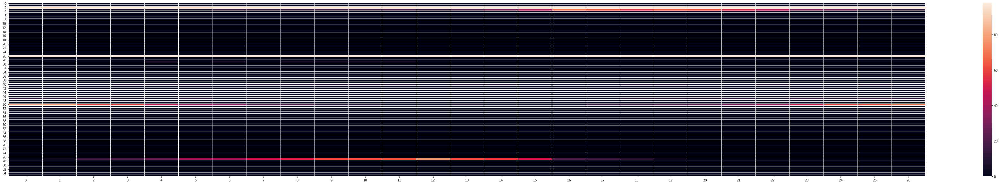

Epochs :  97 Iterations :  27 Loss :  0.695026923108984 ACC :  0.5019607974423302 MCC :  nan Precision :  0.49252797283784105


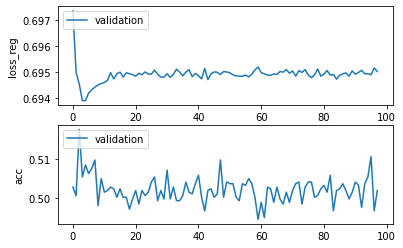

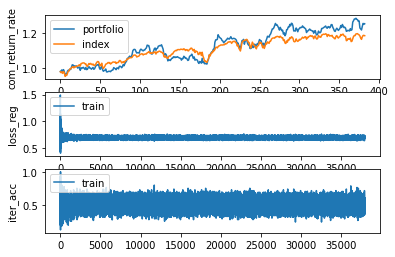

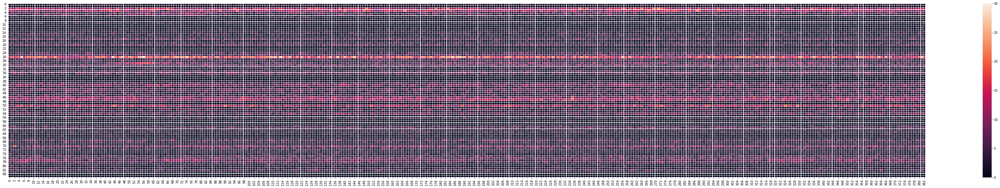

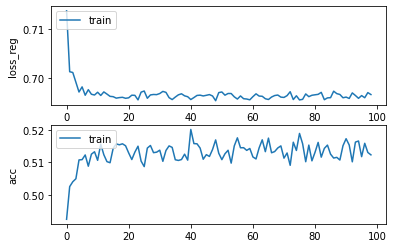

Epochs :  98 Iterations :  37917 Loss :  0.6965986739250761 ACC :  0.5123329912713551 MCC :  0.0254488080048778 Precision :  0.5215966137753454
mode : validation


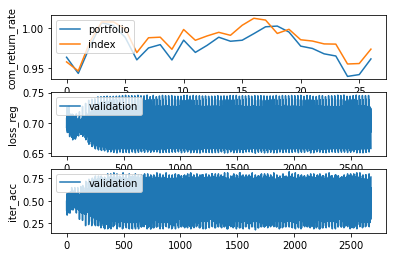

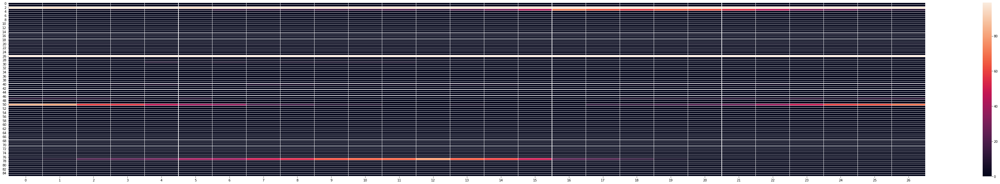

Epochs :  98 Iterations :  27 Loss :  0.6947888577425921 ACC :  0.5032679869068993 MCC :  nan Precision :  0.4935576706710789


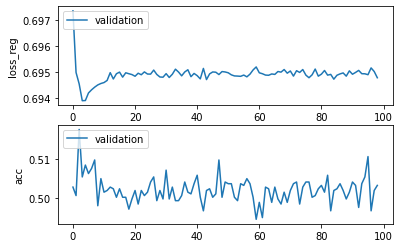

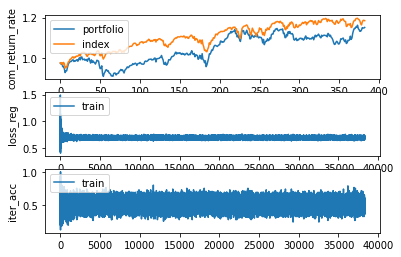

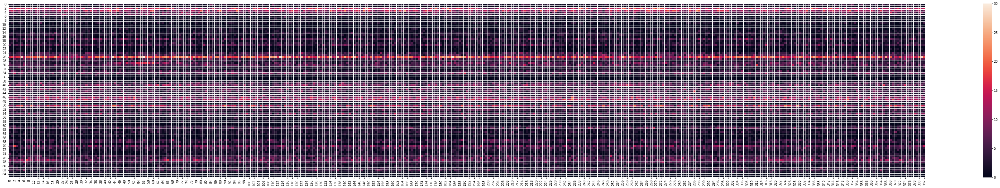

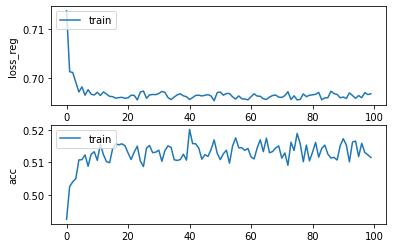

Epochs :  99 Iterations :  38300 Loss :  0.6967588733132764 ACC :  0.5115036254763292 MCC :  0.01740140222254946 Precision :  0.5181818365194779
mode : validation


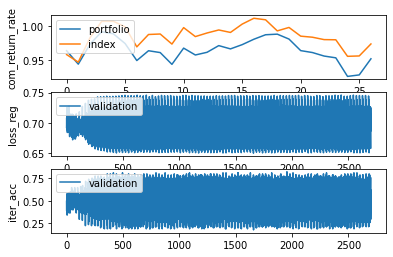

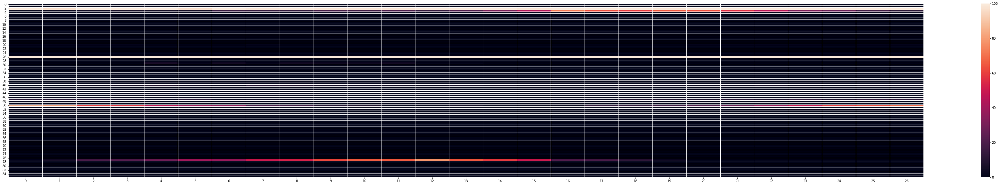

Epochs :  99 Iterations :  27 Loss :  0.6949641814938298 ACC :  0.5006536079777612 MCC :  nan Precision :  0.49221131433215404


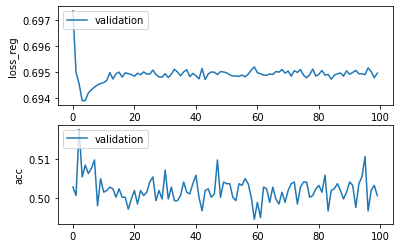

In [88]:
model.train()

mode : test
epoch :  0 time_idx :  0 loss_reg :  tensor(0.6773, grad_fn=<AddBackward0>) acc :  tensor(0.6588) mcc :  tensor(0.1459) precision :  tensor(0.9273)


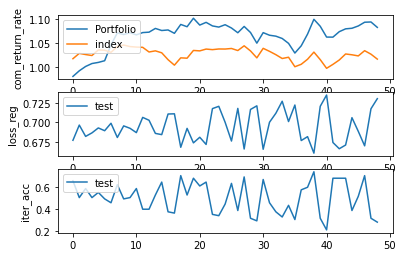

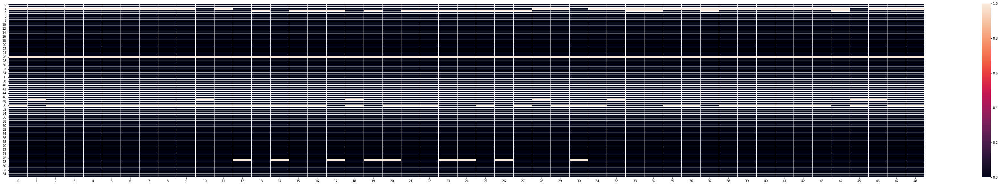

Epochs :  0 Iterations :  49 Loss :  0.6946072785221801 ACC :  0.5025210237624694 MCC :  0.02044186938306963 Precision :  0.4822906295255739


In [89]:
model.test()

In [ ]:
model.train()

In [ ]:
model.test()

In [ ]:
model.train() # dropout 없음, epochs = 5

In [ ]:
model.train() # dropout 0.15 적용

In [ ]:
model.test()

In [ ]:
model.test()

In [ ]:
model.train()

In [ ]:
model.train()

In [ ]:
model.test()

In [ ]:
model.epoch_losses

In [ ]:
model.train()

In [ ]:
model.test()

In [ ]:
model.return_rate.shape

In [ ]:
ㄴmodel.train()

In [ ]:
model.train()